# Afriat

In [1]:
scan=0.05

In [2]:
import warnings
import os
import sys
import gc
import warnings

In [3]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [4]:
torch.cuda.is_available()

False

In [5]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [6]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [7]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [8]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [9]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

tardis.MyModel.setup_wandb(
    wandb_configurations=tardis.config.wandb,
    hyperparams=dict(
        model_params=model_params,
        train_params=train_params,
        dataset_params=dataset_params,
    )
)

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_scan_{0.1}"
)

vae.save(
    dir_path,
    overwrite=True,
)

/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


W&B logger initialized with the following parameters: 
Entity: inecik-academic
Project: tardis_conference
ID: 5cegpwaf
Name: elegant-nexu-143
Tags: tardis, conference, figures, final
Notes: Final runs for Tardis before conference.
URL: https://wandb.ai/inecik-academic/tardis_conference/runs/5cegpwaf
Directory: /lustre/groups/ml01/workspace/kemal.inecik/wandb/run-20240504_155912-5cegpwaf/files



/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
GPU available: False, used: False


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


Training:   0%|          | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|          | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2603,3294,9346
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2603,2541,1665,3427,1616,3391
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4512,10731
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 602,815,2393
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 602,661,443,863,433,808
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1072,2738
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|          | 1/600 [00:14<2:27:49, 14.81s/it]

Epoch 1/600:   0%|          | 1/600 [00:14<2:27:49, 14.81s/it, v_num=af_1, total_loss_train=3.7e+3, kl_local_train=54]

Epoch 2/600:   0%|          | 1/600 [00:14<2:27:49, 14.81s/it, v_num=af_1, total_loss_train=3.7e+3, kl_local_train=54]

Epoch 2/600:   0%|          | 2/600 [00:28<2:19:31, 14.00s/it, v_num=af_1, total_loss_train=3.7e+3, kl_local_train=54]

Epoch 2/600:   0%|          | 2/600 [00:28<2:19:31, 14.00s/it, v_num=af_1, total_loss_train=3.23e+3, kl_local_train=84.2]

Epoch 3/600:   0%|          | 2/600 [00:28<2:19:31, 14.00s/it, v_num=af_1, total_loss_train=3.23e+3, kl_local_train=84.2]

Epoch 3/600:   0%|          | 3/600 [00:41<2:16:52, 13.76s/it, v_num=af_1, total_loss_train=3.23e+3, kl_local_train=84.2]

Epoch 3/600:   0%|          | 3/600 [00:41<2:16:52, 13.76s/it, v_num=af_1, total_loss_train=3.22e+3, kl_local_train=85.1]

Epoch 4/600:   0%|          | 3/600 [00:41<2:16:52, 13.76s/it, v_num=af_1, total_loss_train=3.22e+3, kl_local_train=85.1]

Epoch 4/600:   1%|          | 4/600 [00:55<2:14:56, 13.58s/it, v_num=af_1, total_loss_train=3.22e+3, kl_local_train=85.1]

Epoch 4/600:   1%|          | 4/600 [00:55<2:14:56, 13.58s/it, v_num=af_1, total_loss_train=3.22e+3, kl_local_train=80.5]

Epoch 5/600:   1%|          | 4/600 [00:55<2:14:56, 13.58s/it, v_num=af_1, total_loss_train=3.22e+3, kl_local_train=80.5]

Epoch 5/600:   1%|          | 5/600 [01:09<2:16:57, 13.81s/it, v_num=af_1, total_loss_train=3.22e+3, kl_local_train=80.5]

Epoch 5/600:   1%|          | 5/600 [01:09<2:16:57, 13.81s/it, v_num=af_1, total_loss_train=3.22e+3, kl_local_train=72.8]

Epoch 6/600:   1%|          | 5/600 [01:10<2:16:57, 13.81s/it, v_num=af_1, total_loss_train=3.22e+3, kl_local_train=72.8]

Epoch 6/600:   1%|          | 6/600 [01:25<2:23:43, 14.52s/it, v_num=af_1, total_loss_train=3.22e+3, kl_local_train=72.8]

Epoch 6/600:   1%|          | 6/600 [01:25<2:23:43, 14.52s/it, v_num=af_1, total_loss_train=3.22e+3, kl_local_train=61.1, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00754, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|          | 6/600 [01:25<2:23:43, 14.52s/it, v_num=af_1, total_loss_train=3.22e+3, kl_local_train=61.1, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00754, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|          | 7/600 [01:39<2:23:41, 14.54s/it, v_num=af_1, total_loss_train=3.22e+3, kl_local_train=61.1, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00754, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|          | 7/600 [01:39<2:23:41, 14.54s/it, v_num=af_1, total_loss_train=3.21e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00754, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0349]

Epoch 8/600:   1%|          | 7/600 [01:39<2:23:41, 14.54s/it, v_num=af_1, total_loss_train=3.21e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00754, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0349]

Epoch 8/600:   1%|▏         | 8/600 [01:54<2:23:12, 14.51s/it, v_num=af_1, total_loss_train=3.21e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00754, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0349]

Epoch 8/600:   1%|▏         | 8/600 [01:54<2:23:12, 14.51s/it, v_num=af_1, total_loss_train=3.21e+3, kl_local_train=31.4, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00754, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0349]

Epoch 9/600:   1%|▏         | 8/600 [01:54<2:23:12, 14.51s/it, v_num=af_1, total_loss_train=3.21e+3, kl_local_train=31.4, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00754, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0349]

Epoch 9/600:   2%|▏         | 9/600 [02:08<2:22:44, 14.49s/it, v_num=af_1, total_loss_train=3.21e+3, kl_local_train=31.4, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00754, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0349]

Epoch 9/600:   2%|▏         | 9/600 [02:08<2:22:44, 14.49s/it, v_num=af_1, total_loss_train=3.2e+3, kl_local_train=28.7, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00754, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0349] 

Epoch 10/600:   2%|▏         | 9/600 [02:08<2:22:44, 14.49s/it, v_num=af_1, total_loss_train=3.2e+3, kl_local_train=28.7, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00754, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0349]

Epoch 10/600:   2%|▏         | 10/600 [02:23<2:22:50, 14.53s/it, v_num=af_1, total_loss_train=3.2e+3, kl_local_train=28.7, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00754, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0349]

Epoch 10/600:   2%|▏         | 10/600 [02:23<2:22:50, 14.53s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=33.8, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00754, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0349]

Epoch 11/600:   2%|▏         | 10/600 [02:24<2:22:50, 14.53s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=33.8, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00754, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0349]

Epoch 11/600:   2%|▏         | 11/600 [02:39<2:26:29, 14.92s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=33.8, metric_mi|status_control_train=0.0184, metric_mi|zone_train=0.00754, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0349]

Epoch 11/600:   2%|▏         | 11/600 [02:39<2:26:29, 14.92s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0789, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0476] 

Epoch 12/600:   2%|▏         | 11/600 [02:39<2:26:29, 14.92s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0789, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0476]

Epoch 12/600:   2%|▏         | 12/600 [02:53<2:24:56, 14.79s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=37.4, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0789, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0476]

Epoch 12/600:   2%|▏         | 12/600 [02:53<2:24:56, 14.79s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0789, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0476]

Epoch 13/600:   2%|▏         | 12/600 [02:53<2:24:56, 14.79s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0789, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0476]

Epoch 13/600:   2%|▏         | 13/600 [03:07<2:23:34, 14.68s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0789, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0476]

Epoch 13/600:   2%|▏         | 13/600 [03:07<2:23:34, 14.68s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0789, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0476]

Epoch 14/600:   2%|▏         | 13/600 [03:07<2:23:34, 14.68s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0789, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0476]

Epoch 14/600:   2%|▏         | 14/600 [03:22<2:22:34, 14.60s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0789, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0476]

Epoch 14/600:   2%|▏         | 14/600 [03:22<2:22:34, 14.60s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0789, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0476]

Epoch 15/600:   2%|▏         | 14/600 [03:22<2:22:34, 14.60s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0789, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0476]

Epoch 15/600:   2%|▎         | 15/600 [03:36<2:21:55, 14.56s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0789, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0476]

Epoch 15/600:   2%|▎         | 15/600 [03:36<2:21:55, 14.56s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0789, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0476]

Epoch 16/600:   2%|▎         | 15/600 [03:38<2:21:55, 14.56s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0789, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0476]

Epoch 16/600:   3%|▎         | 16/600 [03:52<2:26:05, 15.01s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0789, metric_mi|time_cat_train=0.0225, metric_mi|mouse_train=0.0476]

Epoch 16/600:   3%|▎         | 16/600 [03:52<2:26:05, 15.01s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=56.6, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0448, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0722]

Epoch 17/600:   3%|▎         | 16/600 [03:52<2:26:05, 15.01s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=56.6, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0448, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0722]

Epoch 17/600:   3%|▎         | 17/600 [04:07<2:24:17, 14.85s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=56.6, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0448, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0722]

Epoch 17/600:   3%|▎         | 17/600 [04:07<2:24:17, 14.85s/it, v_num=af_1, total_loss_train=3.17e+3, kl_local_train=59.5, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0448, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0722]

Epoch 18/600:   3%|▎         | 17/600 [04:07<2:24:17, 14.85s/it, v_num=af_1, total_loss_train=3.17e+3, kl_local_train=59.5, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0448, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0722]

Epoch 18/600:   3%|▎         | 18/600 [04:21<2:23:03, 14.75s/it, v_num=af_1, total_loss_train=3.17e+3, kl_local_train=59.5, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0448, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0722]

Epoch 18/600:   3%|▎         | 18/600 [04:21<2:23:03, 14.75s/it, v_num=af_1, total_loss_train=3.17e+3, kl_local_train=61.6, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0448, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0722]

Epoch 19/600:   3%|▎         | 18/600 [04:21<2:23:03, 14.75s/it, v_num=af_1, total_loss_train=3.17e+3, kl_local_train=61.6, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0448, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0722]

Epoch 19/600:   3%|▎         | 19/600 [04:36<2:22:08, 14.68s/it, v_num=af_1, total_loss_train=3.17e+3, kl_local_train=61.6, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0448, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0722]

Epoch 19/600:   3%|▎         | 19/600 [04:36<2:22:08, 14.68s/it, v_num=af_1, total_loss_train=3.17e+3, kl_local_train=63.8, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0448, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0722]

Epoch 20/600:   3%|▎         | 19/600 [04:36<2:22:08, 14.68s/it, v_num=af_1, total_loss_train=3.17e+3, kl_local_train=63.8, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0448, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0722]

Epoch 20/600:   3%|▎         | 20/600 [04:50<2:21:37, 14.65s/it, v_num=af_1, total_loss_train=3.17e+3, kl_local_train=63.8, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0448, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0722]

Epoch 20/600:   3%|▎         | 20/600 [04:50<2:21:37, 14.65s/it, v_num=af_1, total_loss_train=3.17e+3, kl_local_train=64.8, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0448, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0722]

Epoch 21/600:   3%|▎         | 20/600 [04:52<2:21:37, 14.65s/it, v_num=af_1, total_loss_train=3.17e+3, kl_local_train=64.8, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0448, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0722]

Epoch 21/600:   4%|▎         | 21/600 [05:06<2:24:47, 15.00s/it, v_num=af_1, total_loss_train=3.17e+3, kl_local_train=64.8, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0448, metric_mi|time_cat_train=0.0509, metric_mi|mouse_train=0.0722]

Epoch 21/600:   4%|▎         | 21/600 [05:06<2:24:47, 15.00s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=65.7, metric_mi|status_control_train=0.0404, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0772]

Epoch 22/600:   4%|▎         | 21/600 [05:06<2:24:47, 15.00s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=65.7, metric_mi|status_control_train=0.0404, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0772]

Epoch 22/600:   4%|▎         | 22/600 [05:21<2:22:57, 14.84s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=65.7, metric_mi|status_control_train=0.0404, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0772]

Epoch 22/600:   4%|▎         | 22/600 [05:21<2:22:57, 14.84s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=66.7, metric_mi|status_control_train=0.0404, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0772]

Epoch 23/600:   4%|▎         | 22/600 [05:21<2:22:57, 14.84s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=66.7, metric_mi|status_control_train=0.0404, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0772]

Epoch 23/600:   4%|▍         | 23/600 [05:35<2:21:31, 14.72s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=66.7, metric_mi|status_control_train=0.0404, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0772]

Epoch 23/600:   4%|▍         | 23/600 [05:35<2:21:31, 14.72s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=67.2, metric_mi|status_control_train=0.0404, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0772]

Epoch 24/600:   4%|▍         | 23/600 [05:35<2:21:31, 14.72s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=67.2, metric_mi|status_control_train=0.0404, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0772]

Epoch 24/600:   4%|▍         | 24/600 [05:50<2:20:21, 14.62s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=67.2, metric_mi|status_control_train=0.0404, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0772]

Epoch 24/600:   4%|▍         | 24/600 [05:50<2:20:21, 14.62s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=68.2, metric_mi|status_control_train=0.0404, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0772]

Epoch 25/600:   4%|▍         | 24/600 [05:50<2:20:21, 14.62s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=68.2, metric_mi|status_control_train=0.0404, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0772]

Epoch 25/600:   4%|▍         | 25/600 [06:04<2:19:54, 14.60s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=68.2, metric_mi|status_control_train=0.0404, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0772]

Epoch 25/600:   4%|▍         | 25/600 [06:04<2:19:54, 14.60s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=69.9, metric_mi|status_control_train=0.0404, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0772]

Epoch 26/600:   4%|▍         | 25/600 [06:06<2:19:54, 14.60s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=69.9, metric_mi|status_control_train=0.0404, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0772]

Epoch 26/600:   4%|▍         | 26/600 [06:18<2:16:56, 14.31s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=69.9, metric_mi|status_control_train=0.0404, metric_mi|zone_train=0.0439, metric_mi|time_cat_train=0.0539, metric_mi|mouse_train=0.0772]

Epoch 26/600:   4%|▍         | 26/600 [06:18<2:16:56, 14.31s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=72.4, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.0827]

Epoch 27/600:   4%|▍         | 26/600 [06:18<2:16:56, 14.31s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=72.4, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.0827]

Epoch 27/600:   4%|▍         | 27/600 [06:30<2:11:05, 13.73s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=72.4, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.0827]

Epoch 27/600:   4%|▍         | 27/600 [06:30<2:11:05, 13.73s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=73.6, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.0827]

Epoch 28/600:   4%|▍         | 27/600 [06:30<2:11:05, 13.73s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=73.6, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.0827]

Epoch 28/600:   5%|▍         | 28/600 [06:42<2:06:45, 13.30s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=73.6, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.0827]

Epoch 28/600:   5%|▍         | 28/600 [06:42<2:06:45, 13.30s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=74.7, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.0827]

Epoch 29/600:   5%|▍         | 28/600 [06:42<2:06:45, 13.30s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=74.7, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.0827]

Epoch 29/600:   5%|▍         | 29/600 [06:55<2:03:44, 13.00s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=74.7, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.0827]

Epoch 29/600:   5%|▍         | 29/600 [06:55<2:03:44, 13.00s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=76.5, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.0827]

Epoch 30/600:   5%|▍         | 29/600 [06:55<2:03:44, 13.00s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=76.5, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.0827]

Epoch 30/600:   5%|▌         | 30/600 [07:07<2:01:45, 12.82s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=76.5, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.0827]

Epoch 30/600:   5%|▌         | 30/600 [07:07<2:01:45, 12.82s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=77.4, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.0827]

Epoch 31/600:   5%|▌         | 30/600 [07:08<2:01:45, 12.82s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=77.4, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.0827]

Epoch 31/600:   5%|▌         | 31/600 [07:21<2:04:00, 13.08s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=77.4, metric_mi|status_control_train=0.0414, metric_mi|zone_train=0.0459, metric_mi|time_cat_train=0.0596, metric_mi|mouse_train=0.0827]

Epoch 31/600:   5%|▌         | 31/600 [07:21<2:04:00, 13.08s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=78.7, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0865]

Epoch 32/600:   5%|▌         | 31/600 [07:21<2:04:00, 13.08s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=78.7, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0865]

Epoch 32/600:   5%|▌         | 32/600 [07:33<2:01:33, 12.84s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=78.7, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0865]

Epoch 32/600:   5%|▌         | 32/600 [07:33<2:01:33, 12.84s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=80.1, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0865]

Epoch 33/600:   5%|▌         | 32/600 [07:33<2:01:33, 12.84s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=80.1, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0865]

Epoch 33/600:   6%|▌         | 33/600 [07:45<1:59:59, 12.70s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=80.1, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0865]

Epoch 33/600:   6%|▌         | 33/600 [07:45<1:59:59, 12.70s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=81.7, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0865]

Epoch 34/600:   6%|▌         | 33/600 [07:45<1:59:59, 12.70s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=81.7, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0865]

Epoch 34/600:   6%|▌         | 34/600 [07:58<1:58:43, 12.59s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=81.7, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0865]

Epoch 34/600:   6%|▌         | 34/600 [07:58<1:58:43, 12.59s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=83.8, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0865]

Epoch 35/600:   6%|▌         | 34/600 [07:58<1:58:43, 12.59s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=83.8, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0865]

Epoch 35/600:   6%|▌         | 35/600 [08:10<1:58:17, 12.56s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=83.8, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0865]

Epoch 35/600:   6%|▌         | 35/600 [08:10<1:58:17, 12.56s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=85, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0865]  

Epoch 36/600:   6%|▌         | 35/600 [08:12<1:58:17, 12.56s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=85, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0865]

Epoch 36/600:   6%|▌         | 36/600 [08:24<2:01:04, 12.88s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=85, metric_mi|status_control_train=0.0509, metric_mi|zone_train=0.0499, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0865]

Epoch 36/600:   6%|▌         | 36/600 [08:24<2:01:04, 12.88s/it, v_num=af_1, total_loss_train=3.2e+3, kl_local_train=86.6, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0547, metric_mi|time_cat_train=0.0675, metric_mi|mouse_train=0.0885]

Epoch 37/600:   6%|▌         | 36/600 [08:24<2:01:04, 12.88s/it, v_num=af_1, total_loss_train=3.2e+3, kl_local_train=86.6, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0547, metric_mi|time_cat_train=0.0675, metric_mi|mouse_train=0.0885]

Epoch 37/600:   6%|▌         | 37/600 [08:36<1:59:18, 12.72s/it, v_num=af_1, total_loss_train=3.2e+3, kl_local_train=86.6, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0547, metric_mi|time_cat_train=0.0675, metric_mi|mouse_train=0.0885]

Epoch 37/600:   6%|▌         | 37/600 [08:36<1:59:18, 12.72s/it, v_num=af_1, total_loss_train=3.2e+3, kl_local_train=86.8, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0547, metric_mi|time_cat_train=0.0675, metric_mi|mouse_train=0.0885]

Epoch 38/600:   6%|▌         | 37/600 [08:36<1:59:18, 12.72s/it, v_num=af_1, total_loss_train=3.2e+3, kl_local_train=86.8, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0547, metric_mi|time_cat_train=0.0675, metric_mi|mouse_train=0.0885]

Epoch 38/600:   6%|▋         | 38/600 [08:49<1:57:49, 12.58s/it, v_num=af_1, total_loss_train=3.2e+3, kl_local_train=86.8, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0547, metric_mi|time_cat_train=0.0675, metric_mi|mouse_train=0.0885]

Epoch 38/600:   6%|▋         | 38/600 [08:49<1:57:49, 12.58s/it, v_num=af_1, total_loss_train=3.2e+3, kl_local_train=88.4, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0547, metric_mi|time_cat_train=0.0675, metric_mi|mouse_train=0.0885]

Epoch 39/600:   6%|▋         | 38/600 [08:49<1:57:49, 12.58s/it, v_num=af_1, total_loss_train=3.2e+3, kl_local_train=88.4, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0547, metric_mi|time_cat_train=0.0675, metric_mi|mouse_train=0.0885]

Epoch 39/600:   6%|▋         | 39/600 [09:01<1:56:47, 12.49s/it, v_num=af_1, total_loss_train=3.2e+3, kl_local_train=88.4, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0547, metric_mi|time_cat_train=0.0675, metric_mi|mouse_train=0.0885]

Epoch 39/600:   6%|▋         | 39/600 [09:01<1:56:47, 12.49s/it, v_num=af_1, total_loss_train=3.2e+3, kl_local_train=88.4, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0547, metric_mi|time_cat_train=0.0675, metric_mi|mouse_train=0.0885]

Epoch 40/600:   6%|▋         | 39/600 [09:01<1:56:47, 12.49s/it, v_num=af_1, total_loss_train=3.2e+3, kl_local_train=88.4, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0547, metric_mi|time_cat_train=0.0675, metric_mi|mouse_train=0.0885]

Epoch 40/600:   7%|▋         | 40/600 [09:14<1:57:29, 12.59s/it, v_num=af_1, total_loss_train=3.2e+3, kl_local_train=88.4, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0547, metric_mi|time_cat_train=0.0675, metric_mi|mouse_train=0.0885]

Epoch 40/600:   7%|▋         | 40/600 [09:14<1:57:29, 12.59s/it, v_num=af_1, total_loss_train=3.2e+3, kl_local_train=88.6, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0547, metric_mi|time_cat_train=0.0675, metric_mi|mouse_train=0.0885]

Epoch 41/600:   7%|▋         | 40/600 [09:15<1:57:29, 12.59s/it, v_num=af_1, total_loss_train=3.2e+3, kl_local_train=88.6, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0547, metric_mi|time_cat_train=0.0675, metric_mi|mouse_train=0.0885]

Epoch 41/600:   7%|▋         | 41/600 [09:27<2:00:30, 12.93s/it, v_num=af_1, total_loss_train=3.2e+3, kl_local_train=88.6, metric_mi|status_control_train=0.0592, metric_mi|zone_train=0.0547, metric_mi|time_cat_train=0.0675, metric_mi|mouse_train=0.0885]

Epoch 41/600:   7%|▋         | 41/600 [09:27<2:00:30, 12.93s/it, v_num=af_1, total_loss_train=3.2e+3, kl_local_train=89, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0923]   

Epoch 42/600:   7%|▋         | 41/600 [09:27<2:00:30, 12.93s/it, v_num=af_1, total_loss_train=3.2e+3, kl_local_train=89, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0923]

Epoch 42/600:   7%|▋         | 42/600 [09:40<1:58:32, 12.75s/it, v_num=af_1, total_loss_train=3.2e+3, kl_local_train=89, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0923]

Epoch 42/600:   7%|▋         | 42/600 [09:40<1:58:32, 12.75s/it, v_num=af_1, total_loss_train=3.21e+3, kl_local_train=89.2, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0923]

Epoch 43/600:   7%|▋         | 42/600 [09:40<1:58:32, 12.75s/it, v_num=af_1, total_loss_train=3.21e+3, kl_local_train=89.2, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0923]

Epoch 43/600:   7%|▋         | 43/600 [09:52<1:57:02, 12.61s/it, v_num=af_1, total_loss_train=3.21e+3, kl_local_train=89.2, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0923]

Epoch 43/600:   7%|▋         | 43/600 [09:52<1:57:02, 12.61s/it, v_num=af_1, total_loss_train=3.21e+3, kl_local_train=88.3, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0923]

Epoch 44/600:   7%|▋         | 43/600 [09:52<1:57:02, 12.61s/it, v_num=af_1, total_loss_train=3.21e+3, kl_local_train=88.3, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0923]

Epoch 44/600:   7%|▋         | 44/600 [10:04<1:56:03, 12.52s/it, v_num=af_1, total_loss_train=3.21e+3, kl_local_train=88.3, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0923]

Epoch 44/600:   7%|▋         | 44/600 [10:04<1:56:03, 12.52s/it, v_num=af_1, total_loss_train=3.21e+3, kl_local_train=89, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0923]  

Epoch 45/600:   7%|▋         | 44/600 [10:04<1:56:03, 12.52s/it, v_num=af_1, total_loss_train=3.21e+3, kl_local_train=89, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0923]

Epoch 45/600:   8%|▊         | 45/600 [10:17<1:55:12, 12.46s/it, v_num=af_1, total_loss_train=3.21e+3, kl_local_train=89, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0923]

Epoch 45/600:   8%|▊         | 45/600 [10:17<1:55:12, 12.46s/it, v_num=af_1, total_loss_train=3.21e+3, kl_local_train=88.2, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0923]

Epoch 46/600:   8%|▊         | 45/600 [10:18<1:55:12, 12.46s/it, v_num=af_1, total_loss_train=3.21e+3, kl_local_train=88.2, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0923]

Epoch 46/600:   8%|▊         | 46/600 [10:30<1:58:27, 12.83s/it, v_num=af_1, total_loss_train=3.21e+3, kl_local_train=88.2, metric_mi|status_control_train=0.0683, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.073, metric_mi|mouse_train=0.0923]

Epoch 46/600:   8%|▊         | 46/600 [10:30<1:58:27, 12.83s/it, v_num=af_1, total_loss_train=3.21e+3, kl_local_train=87.8, metric_mi|status_control_train=0.0736, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0947]

Epoch 47/600:   8%|▊         | 46/600 [10:30<1:58:27, 12.83s/it, v_num=af_1, total_loss_train=3.21e+3, kl_local_train=87.8, metric_mi|status_control_train=0.0736, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0947]

Epoch 47/600:   8%|▊         | 47/600 [10:43<1:56:44, 12.67s/it, v_num=af_1, total_loss_train=3.21e+3, kl_local_train=87.8, metric_mi|status_control_train=0.0736, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0947]

Epoch 47/600:   8%|▊         | 47/600 [10:43<1:56:44, 12.67s/it, v_num=af_1, total_loss_train=3.22e+3, kl_local_train=88.4, metric_mi|status_control_train=0.0736, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0947]

Epoch 48/600:   8%|▊         | 47/600 [10:43<1:56:44, 12.67s/it, v_num=af_1, total_loss_train=3.22e+3, kl_local_train=88.4, metric_mi|status_control_train=0.0736, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0947]

Epoch 48/600:   8%|▊         | 48/600 [10:55<1:55:31, 12.56s/it, v_num=af_1, total_loss_train=3.22e+3, kl_local_train=88.4, metric_mi|status_control_train=0.0736, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0947]

Epoch 48/600:   8%|▊         | 48/600 [10:55<1:55:31, 12.56s/it, v_num=af_1, total_loss_train=3.22e+3, kl_local_train=87.9, metric_mi|status_control_train=0.0736, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0947]

Epoch 49/600:   8%|▊         | 48/600 [10:55<1:55:31, 12.56s/it, v_num=af_1, total_loss_train=3.22e+3, kl_local_train=87.9, metric_mi|status_control_train=0.0736, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0947]

Epoch 49/600:   8%|▊         | 49/600 [11:07<1:54:31, 12.47s/it, v_num=af_1, total_loss_train=3.22e+3, kl_local_train=87.9, metric_mi|status_control_train=0.0736, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0947]

Epoch 49/600:   8%|▊         | 49/600 [11:07<1:54:31, 12.47s/it, v_num=af_1, total_loss_train=3.22e+3, kl_local_train=86.9, metric_mi|status_control_train=0.0736, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0947]

Epoch 50/600:   8%|▊         | 49/600 [11:07<1:54:31, 12.47s/it, v_num=af_1, total_loss_train=3.22e+3, kl_local_train=86.9, metric_mi|status_control_train=0.0736, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0947]

Epoch 50/600:   8%|▊         | 50/600 [11:20<1:55:31, 12.60s/it, v_num=af_1, total_loss_train=3.22e+3, kl_local_train=86.9, metric_mi|status_control_train=0.0736, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0947]

Epoch 50/600:   8%|▊         | 50/600 [11:20<1:55:31, 12.60s/it, v_num=af_1, total_loss_train=3.22e+3, kl_local_train=87.5, metric_mi|status_control_train=0.0736, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0947]

Epoch 51/600:   8%|▊         | 50/600 [11:21<1:55:31, 12.60s/it, v_num=af_1, total_loss_train=3.22e+3, kl_local_train=87.5, metric_mi|status_control_train=0.0736, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0947]

Epoch 51/600:   8%|▊         | 51/600 [11:34<1:58:19, 12.93s/it, v_num=af_1, total_loss_train=3.22e+3, kl_local_train=87.5, metric_mi|status_control_train=0.0736, metric_mi|zone_train=0.0603, metric_mi|time_cat_train=0.077, metric_mi|mouse_train=0.0947]

Epoch 51/600:   8%|▊         | 51/600 [11:34<1:58:19, 12.93s/it, v_num=af_1, total_loss_train=3.22e+3, kl_local_train=87.9, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0973]

Epoch 52/600:   8%|▊         | 51/600 [11:34<1:58:19, 12.93s/it, v_num=af_1, total_loss_train=3.22e+3, kl_local_train=87.9, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0973]

Epoch 52/600:   9%|▊         | 52/600 [11:46<1:56:26, 12.75s/it, v_num=af_1, total_loss_train=3.22e+3, kl_local_train=87.9, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0973]

Epoch 52/600:   9%|▊         | 52/600 [11:46<1:56:26, 12.75s/it, v_num=af_1, total_loss_train=3.22e+3, kl_local_train=86.4, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0973]

Epoch 53/600:   9%|▊         | 52/600 [11:46<1:56:26, 12.75s/it, v_num=af_1, total_loss_train=3.22e+3, kl_local_train=86.4, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0973]

Epoch 53/600:   9%|▉         | 53/600 [11:58<1:55:01, 12.62s/it, v_num=af_1, total_loss_train=3.22e+3, kl_local_train=86.4, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0973]

Epoch 53/600:   9%|▉         | 53/600 [11:58<1:55:01, 12.62s/it, v_num=af_1, total_loss_train=3.22e+3, kl_local_train=85, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0973]  

Epoch 54/600:   9%|▉         | 53/600 [11:58<1:55:01, 12.62s/it, v_num=af_1, total_loss_train=3.22e+3, kl_local_train=85, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0973]

Epoch 54/600:   9%|▉         | 54/600 [12:11<1:54:00, 12.53s/it, v_num=af_1, total_loss_train=3.22e+3, kl_local_train=85, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0973]

Epoch 54/600:   9%|▉         | 54/600 [12:11<1:54:00, 12.53s/it, v_num=af_1, total_loss_train=3.22e+3, kl_local_train=86.3, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0973]

Epoch 55/600:   9%|▉         | 54/600 [12:11<1:54:00, 12.53s/it, v_num=af_1, total_loss_train=3.22e+3, kl_local_train=86.3, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0973]

Epoch 55/600:   9%|▉         | 55/600 [12:23<1:53:24, 12.48s/it, v_num=af_1, total_loss_train=3.22e+3, kl_local_train=86.3, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0973]

Epoch 55/600:   9%|▉         | 55/600 [12:23<1:53:24, 12.48s/it, v_num=af_1, total_loss_train=3.21e+3, kl_local_train=84.8, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0973]

Epoch 56/600:   9%|▉         | 55/600 [12:24<1:53:24, 12.48s/it, v_num=af_1, total_loss_train=3.21e+3, kl_local_train=84.8, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0973]

Epoch 56/600:   9%|▉         | 56/600 [12:37<1:56:26, 12.84s/it, v_num=af_1, total_loss_train=3.21e+3, kl_local_train=84.8, metric_mi|status_control_train=0.0808, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0818, metric_mi|mouse_train=0.0973]

Epoch 56/600:   9%|▉         | 56/600 [12:37<1:56:26, 12.84s/it, v_num=af_1, total_loss_train=3.21e+3, kl_local_train=84.5, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0815, metric_mi|mouse_train=0.0965]

Epoch 57/600:   9%|▉         | 56/600 [12:37<1:56:26, 12.84s/it, v_num=af_1, total_loss_train=3.21e+3, kl_local_train=84.5, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0815, metric_mi|mouse_train=0.0965]

Epoch 57/600:  10%|▉         | 57/600 [12:49<1:54:48, 12.69s/it, v_num=af_1, total_loss_train=3.21e+3, kl_local_train=84.5, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0815, metric_mi|mouse_train=0.0965]

Epoch 57/600:  10%|▉         | 57/600 [12:49<1:54:48, 12.69s/it, v_num=af_1, total_loss_train=3.21e+3, kl_local_train=84.2, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0815, metric_mi|mouse_train=0.0965]

Epoch 58/600:  10%|▉         | 57/600 [12:49<1:54:48, 12.69s/it, v_num=af_1, total_loss_train=3.21e+3, kl_local_train=84.2, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0815, metric_mi|mouse_train=0.0965]

Epoch 58/600:  10%|▉         | 58/600 [13:01<1:53:04, 12.52s/it, v_num=af_1, total_loss_train=3.21e+3, kl_local_train=84.2, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0815, metric_mi|mouse_train=0.0965]

Epoch 58/600:  10%|▉         | 58/600 [13:01<1:53:04, 12.52s/it, v_num=af_1, total_loss_train=3.21e+3, kl_local_train=82.3, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0815, metric_mi|mouse_train=0.0965]

Epoch 59/600:  10%|▉         | 58/600 [13:01<1:53:04, 12.52s/it, v_num=af_1, total_loss_train=3.21e+3, kl_local_train=82.3, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0815, metric_mi|mouse_train=0.0965]

Epoch 59/600:  10%|▉         | 59/600 [13:14<1:52:44, 12.50s/it, v_num=af_1, total_loss_train=3.21e+3, kl_local_train=82.3, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0815, metric_mi|mouse_train=0.0965]

Epoch 59/600:  10%|▉         | 59/600 [13:14<1:52:44, 12.50s/it, v_num=af_1, total_loss_train=3.21e+3, kl_local_train=82.8, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0815, metric_mi|mouse_train=0.0965]

Epoch 60/600:  10%|▉         | 59/600 [13:14<1:52:44, 12.50s/it, v_num=af_1, total_loss_train=3.21e+3, kl_local_train=82.8, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0815, metric_mi|mouse_train=0.0965]

Epoch 60/600:  10%|█         | 60/600 [13:26<1:52:56, 12.55s/it, v_num=af_1, total_loss_train=3.21e+3, kl_local_train=82.8, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0815, metric_mi|mouse_train=0.0965]

Epoch 60/600:  10%|█         | 60/600 [13:26<1:52:56, 12.55s/it, v_num=af_1, total_loss_train=3.21e+3, kl_local_train=80.4, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0815, metric_mi|mouse_train=0.0965]

Epoch 61/600:  10%|█         | 60/600 [13:28<1:52:56, 12.55s/it, v_num=af_1, total_loss_train=3.21e+3, kl_local_train=80.4, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0815, metric_mi|mouse_train=0.0965]

Epoch 61/600:  10%|█         | 61/600 [13:40<1:55:40, 12.88s/it, v_num=af_1, total_loss_train=3.21e+3, kl_local_train=80.4, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0671, metric_mi|time_cat_train=0.0815, metric_mi|mouse_train=0.0965]

Epoch 61/600:  10%|█         | 61/600 [13:40<1:55:40, 12.88s/it, v_num=af_1, total_loss_train=3.21e+3, kl_local_train=79.6, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.0955]

Epoch 62/600:  10%|█         | 61/600 [13:40<1:55:40, 12.88s/it, v_num=af_1, total_loss_train=3.21e+3, kl_local_train=79.6, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.0955]

Epoch 62/600:  10%|█         | 62/600 [13:52<1:54:00, 12.71s/it, v_num=af_1, total_loss_train=3.21e+3, kl_local_train=79.6, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.0955]

Epoch 62/600:  10%|█         | 62/600 [13:52<1:54:00, 12.71s/it, v_num=af_1, total_loss_train=3.2e+3, kl_local_train=78.6, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.0955] 

Epoch 63/600:  10%|█         | 62/600 [13:52<1:54:00, 12.71s/it, v_num=af_1, total_loss_train=3.2e+3, kl_local_train=78.6, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.0955]

Epoch 63/600:  10%|█         | 63/600 [14:05<1:52:42, 12.59s/it, v_num=af_1, total_loss_train=3.2e+3, kl_local_train=78.6, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.0955]

Epoch 63/600:  10%|█         | 63/600 [14:05<1:52:42, 12.59s/it, v_num=af_1, total_loss_train=3.2e+3, kl_local_train=77.9, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.0955]

Epoch 64/600:  10%|█         | 63/600 [14:05<1:52:42, 12.59s/it, v_num=af_1, total_loss_train=3.2e+3, kl_local_train=77.9, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.0955]

Epoch 64/600:  11%|█         | 64/600 [14:17<1:51:48, 12.52s/it, v_num=af_1, total_loss_train=3.2e+3, kl_local_train=77.9, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.0955]

Epoch 64/600:  11%|█         | 64/600 [14:17<1:51:48, 12.52s/it, v_num=af_1, total_loss_train=3.2e+3, kl_local_train=78.2, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.0955]

Epoch 65/600:  11%|█         | 64/600 [14:17<1:51:48, 12.52s/it, v_num=af_1, total_loss_train=3.2e+3, kl_local_train=78.2, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.0955]

Epoch 65/600:  11%|█         | 65/600 [14:29<1:51:19, 12.49s/it, v_num=af_1, total_loss_train=3.2e+3, kl_local_train=78.2, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.0955]

Epoch 65/600:  11%|█         | 65/600 [14:29<1:51:19, 12.49s/it, v_num=af_1, total_loss_train=3.2e+3, kl_local_train=76.9, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.0955]

Epoch 66/600:  11%|█         | 65/600 [14:31<1:51:19, 12.49s/it, v_num=af_1, total_loss_train=3.2e+3, kl_local_train=76.9, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.0955]

Epoch 66/600:  11%|█         | 66/600 [14:43<1:54:18, 12.84s/it, v_num=af_1, total_loss_train=3.2e+3, kl_local_train=76.9, metric_mi|status_control_train=0.0823, metric_mi|zone_train=0.0727, metric_mi|time_cat_train=0.0798, metric_mi|mouse_train=0.0955]

Epoch 66/600:  11%|█         | 66/600 [14:43<1:54:18, 12.84s/it, v_num=af_1, total_loss_train=3.2e+3, kl_local_train=75.1, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0939]

Epoch 67/600:  11%|█         | 66/600 [14:43<1:54:18, 12.84s/it, v_num=af_1, total_loss_train=3.2e+3, kl_local_train=75.1, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0939]

Epoch 67/600:  11%|█         | 67/600 [14:56<1:53:08, 12.74s/it, v_num=af_1, total_loss_train=3.2e+3, kl_local_train=75.1, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0939]

Epoch 67/600:  11%|█         | 67/600 [14:56<1:53:08, 12.74s/it, v_num=af_1, total_loss_train=3.2e+3, kl_local_train=74.8, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0939]

Epoch 68/600:  11%|█         | 67/600 [14:56<1:53:08, 12.74s/it, v_num=af_1, total_loss_train=3.2e+3, kl_local_train=74.8, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0939]

Epoch 68/600:  11%|█▏        | 68/600 [15:08<1:51:45, 12.60s/it, v_num=af_1, total_loss_train=3.2e+3, kl_local_train=74.8, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0939]

Epoch 68/600:  11%|█▏        | 68/600 [15:08<1:51:45, 12.60s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=74.9, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0939]

Epoch 69/600:  11%|█▏        | 68/600 [15:08<1:51:45, 12.60s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=74.9, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0939]

Epoch 69/600:  12%|█▏        | 69/600 [15:20<1:50:19, 12.47s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=74.9, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0939]

Epoch 69/600:  12%|█▏        | 69/600 [15:20<1:50:19, 12.47s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=74.1, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0939]

Epoch 70/600:  12%|█▏        | 69/600 [15:20<1:50:19, 12.47s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=74.1, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0939]

Epoch 70/600:  12%|█▏        | 70/600 [15:33<1:51:55, 12.67s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=74.1, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0939]

Epoch 70/600:  12%|█▏        | 70/600 [15:33<1:51:55, 12.67s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=73.1, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0939]

Epoch 71/600:  12%|█▏        | 70/600 [15:34<1:51:55, 12.67s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=73.1, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0939]

Epoch 71/600:  12%|█▏        | 71/600 [15:47<1:53:50, 12.91s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=73.1, metric_mi|status_control_train=0.0816, metric_mi|zone_train=0.0768, metric_mi|time_cat_train=0.0776, metric_mi|mouse_train=0.0939]

Epoch 71/600:  12%|█▏        | 71/600 [15:47<1:53:50, 12.91s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=72.2, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0908]

Epoch 72/600:  12%|█▏        | 71/600 [15:47<1:53:50, 12.91s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=72.2, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0908]

Epoch 72/600:  12%|█▏        | 72/600 [15:59<1:52:19, 12.76s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=72.2, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0908]

Epoch 72/600:  12%|█▏        | 72/600 [15:59<1:52:19, 12.76s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=71.4, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0908]

Epoch 73/600:  12%|█▏        | 72/600 [15:59<1:52:19, 12.76s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=71.4, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0908]

Epoch 73/600:  12%|█▏        | 73/600 [16:11<1:50:37, 12.60s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=71.4, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0908]

Epoch 73/600:  12%|█▏        | 73/600 [16:11<1:50:37, 12.60s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=71.2, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0908]

Epoch 74/600:  12%|█▏        | 73/600 [16:11<1:50:37, 12.60s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=71.2, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0908]

Epoch 74/600:  12%|█▏        | 74/600 [16:24<1:49:44, 12.52s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=71.2, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0908]

Epoch 74/600:  12%|█▏        | 74/600 [16:24<1:49:44, 12.52s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=70.1, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0908]

Epoch 75/600:  12%|█▏        | 74/600 [16:24<1:49:44, 12.52s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=70.1, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0908]

Epoch 75/600:  12%|█▎        | 75/600 [16:36<1:49:10, 12.48s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=70.1, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0908]

Epoch 75/600:  12%|█▎        | 75/600 [16:36<1:49:10, 12.48s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=69.8, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0908]

Epoch 76/600:  12%|█▎        | 75/600 [16:37<1:49:10, 12.48s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=69.8, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0908]

Epoch 76/600:  13%|█▎        | 76/600 [16:50<1:52:04, 12.83s/it, v_num=af_1, total_loss_train=3.19e+3, kl_local_train=69.8, metric_mi|status_control_train=0.0789, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0738, metric_mi|mouse_train=0.0908]

Epoch 76/600:  13%|█▎        | 76/600 [16:50<1:52:04, 12.83s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=69.5, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0886] 

Epoch 77/600:  13%|█▎        | 76/600 [16:50<1:52:04, 12.83s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=69.5, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0886]

Epoch 77/600:  13%|█▎        | 77/600 [17:02<1:50:28, 12.67s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=69.5, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0886]

Epoch 77/600:  13%|█▎        | 77/600 [17:02<1:50:28, 12.67s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=68.6, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0886]

Epoch 78/600:  13%|█▎        | 77/600 [17:02<1:50:28, 12.67s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=68.6, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0886]

Epoch 78/600:  13%|█▎        | 78/600 [17:14<1:49:22, 12.57s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=68.6, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0886]

Epoch 78/600:  13%|█▎        | 78/600 [17:14<1:49:22, 12.57s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=68.6, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0886]

Epoch 79/600:  13%|█▎        | 78/600 [17:14<1:49:22, 12.57s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=68.6, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0886]

Epoch 79/600:  13%|█▎        | 79/600 [17:27<1:48:24, 12.48s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=68.6, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0886]

Epoch 79/600:  13%|█▎        | 79/600 [17:27<1:48:24, 12.48s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=67.9, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0886]

Epoch 80/600:  13%|█▎        | 79/600 [17:27<1:48:24, 12.48s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=67.9, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0886]

Epoch 80/600:  13%|█▎        | 80/600 [17:39<1:49:22, 12.62s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=67.9, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0886]

Epoch 80/600:  13%|█▎        | 80/600 [17:39<1:49:22, 12.62s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=67.6, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0886]

Epoch 81/600:  13%|█▎        | 80/600 [17:41<1:49:22, 12.62s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=67.6, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0886]

Epoch 81/600:  14%|█▎        | 81/600 [17:53<1:51:50, 12.93s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=67.6, metric_mi|status_control_train=0.076, metric_mi|zone_train=0.0813, metric_mi|time_cat_train=0.0707, metric_mi|mouse_train=0.0886]

Epoch 81/600:  14%|█▎        | 81/600 [17:53<1:51:50, 12.93s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=66.8, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.087]

Epoch 82/600:  14%|█▎        | 81/600 [17:53<1:51:50, 12.93s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=66.8, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.087]

Epoch 82/600:  14%|█▎        | 82/600 [18:05<1:50:07, 12.76s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=66.8, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.087]

Epoch 82/600:  14%|█▎        | 82/600 [18:05<1:50:07, 12.76s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=66.1, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.087]

Epoch 83/600:  14%|█▎        | 82/600 [18:05<1:50:07, 12.76s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=66.1, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.087]

Epoch 83/600:  14%|█▍        | 83/600 [18:18<1:48:48, 12.63s/it, v_num=af_1, total_loss_train=3.18e+3, kl_local_train=66.1, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.087]

Epoch 83/600:  14%|█▍        | 83/600 [18:18<1:48:48, 12.63s/it, v_num=af_1, total_loss_train=3.17e+3, kl_local_train=65.5, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.087]

Epoch 84/600:  14%|█▍        | 83/600 [18:18<1:48:48, 12.63s/it, v_num=af_1, total_loss_train=3.17e+3, kl_local_train=65.5, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.087]

Epoch 84/600:  14%|█▍        | 84/600 [18:30<1:47:53, 12.54s/it, v_num=af_1, total_loss_train=3.17e+3, kl_local_train=65.5, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.087]

Epoch 84/600:  14%|█▍        | 84/600 [18:30<1:47:53, 12.54s/it, v_num=af_1, total_loss_train=3.17e+3, kl_local_train=65.5, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.087]

Epoch 85/600:  14%|█▍        | 84/600 [18:30<1:47:53, 12.54s/it, v_num=af_1, total_loss_train=3.17e+3, kl_local_train=65.5, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.087]

Epoch 85/600:  14%|█▍        | 85/600 [18:43<1:48:35, 12.65s/it, v_num=af_1, total_loss_train=3.17e+3, kl_local_train=65.5, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.087]

Epoch 85/600:  14%|█▍        | 85/600 [18:43<1:48:35, 12.65s/it, v_num=af_1, total_loss_train=3.17e+3, kl_local_train=64.8, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.087]

Epoch 86/600:  14%|█▍        | 85/600 [18:44<1:48:35, 12.65s/it, v_num=af_1, total_loss_train=3.17e+3, kl_local_train=64.8, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.087]

Epoch 86/600:  14%|█▍        | 86/600 [18:57<1:50:55, 12.95s/it, v_num=af_1, total_loss_train=3.17e+3, kl_local_train=64.8, metric_mi|status_control_train=0.0747, metric_mi|zone_train=0.0803, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.087]

Epoch 86/600:  14%|█▍        | 86/600 [18:57<1:50:55, 12.95s/it, v_num=af_1, total_loss_train=3.17e+3, kl_local_train=64.5, metric_mi|status_control_train=0.0724, metric_mi|zone_train=0.078, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0848]

Epoch 87/600:  14%|█▍        | 86/600 [18:57<1:50:55, 12.95s/it, v_num=af_1, total_loss_train=3.17e+3, kl_local_train=64.5, metric_mi|status_control_train=0.0724, metric_mi|zone_train=0.078, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0848]

Epoch 87/600:  14%|█▍        | 87/600 [19:09<1:48:57, 12.74s/it, v_num=af_1, total_loss_train=3.17e+3, kl_local_train=64.5, metric_mi|status_control_train=0.0724, metric_mi|zone_train=0.078, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0848]

Epoch 87/600:  14%|█▍        | 87/600 [19:09<1:48:57, 12.74s/it, v_num=af_1, total_loss_train=3.17e+3, kl_local_train=64.5, metric_mi|status_control_train=0.0724, metric_mi|zone_train=0.078, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0848]

Epoch 88/600:  14%|█▍        | 87/600 [19:09<1:48:57, 12.74s/it, v_num=af_1, total_loss_train=3.17e+3, kl_local_train=64.5, metric_mi|status_control_train=0.0724, metric_mi|zone_train=0.078, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0848]

Epoch 88/600:  15%|█▍        | 88/600 [19:21<1:47:31, 12.60s/it, v_num=af_1, total_loss_train=3.17e+3, kl_local_train=64.5, metric_mi|status_control_train=0.0724, metric_mi|zone_train=0.078, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0848]

Epoch 88/600:  15%|█▍        | 88/600 [19:21<1:47:31, 12.60s/it, v_num=af_1, total_loss_train=3.17e+3, kl_local_train=64.3, metric_mi|status_control_train=0.0724, metric_mi|zone_train=0.078, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0848]

Epoch 89/600:  15%|█▍        | 88/600 [19:21<1:47:31, 12.60s/it, v_num=af_1, total_loss_train=3.17e+3, kl_local_train=64.3, metric_mi|status_control_train=0.0724, metric_mi|zone_train=0.078, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0848]

Epoch 89/600:  15%|█▍        | 89/600 [19:33<1:46:23, 12.49s/it, v_num=af_1, total_loss_train=3.17e+3, kl_local_train=64.3, metric_mi|status_control_train=0.0724, metric_mi|zone_train=0.078, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0848]

Epoch 89/600:  15%|█▍        | 89/600 [19:33<1:46:23, 12.49s/it, v_num=af_1, total_loss_train=3.17e+3, kl_local_train=63.9, metric_mi|status_control_train=0.0724, metric_mi|zone_train=0.078, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0848]

Epoch 90/600:  15%|█▍        | 89/600 [19:33<1:46:23, 12.49s/it, v_num=af_1, total_loss_train=3.17e+3, kl_local_train=63.9, metric_mi|status_control_train=0.0724, metric_mi|zone_train=0.078, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0848]

Epoch 90/600:  15%|█▌        | 90/600 [19:46<1:46:20, 12.51s/it, v_num=af_1, total_loss_train=3.17e+3, kl_local_train=63.9, metric_mi|status_control_train=0.0724, metric_mi|zone_train=0.078, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0848]

Epoch 90/600:  15%|█▌        | 90/600 [19:46<1:46:20, 12.51s/it, v_num=af_1, total_loss_train=3.17e+3, kl_local_train=63.5, metric_mi|status_control_train=0.0724, metric_mi|zone_train=0.078, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0848]

Epoch 91/600:  15%|█▌        | 90/600 [19:47<1:46:20, 12.51s/it, v_num=af_1, total_loss_train=3.17e+3, kl_local_train=63.5, metric_mi|status_control_train=0.0724, metric_mi|zone_train=0.078, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0848]

Epoch 91/600:  15%|█▌        | 91/600 [20:00<1:49:33, 12.91s/it, v_num=af_1, total_loss_train=3.17e+3, kl_local_train=63.5, metric_mi|status_control_train=0.0724, metric_mi|zone_train=0.078, metric_mi|time_cat_train=0.0651, metric_mi|mouse_train=0.0848]

Epoch 91/600:  15%|█▌        | 91/600 [20:00<1:49:33, 12.91s/it, v_num=af_1, total_loss_train=3.17e+3, kl_local_train=62.6, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0765, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.083]

Epoch 92/600:  15%|█▌        | 91/600 [20:00<1:49:33, 12.91s/it, v_num=af_1, total_loss_train=3.17e+3, kl_local_train=62.6, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0765, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.083]

Epoch 92/600:  15%|█▌        | 92/600 [20:12<1:47:47, 12.73s/it, v_num=af_1, total_loss_train=3.17e+3, kl_local_train=62.6, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0765, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.083]

Epoch 92/600:  15%|█▌        | 92/600 [20:12<1:47:47, 12.73s/it, v_num=af_1, total_loss_train=3.16e+3, kl_local_train=62.2, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0765, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.083]

Epoch 93/600:  15%|█▌        | 92/600 [20:12<1:47:47, 12.73s/it, v_num=af_1, total_loss_train=3.16e+3, kl_local_train=62.2, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0765, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.083]

Epoch 93/600:  16%|█▌        | 93/600 [20:25<1:46:48, 12.64s/it, v_num=af_1, total_loss_train=3.16e+3, kl_local_train=62.2, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0765, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.083]

Epoch 93/600:  16%|█▌        | 93/600 [20:25<1:46:48, 12.64s/it, v_num=af_1, total_loss_train=3.16e+3, kl_local_train=61.5, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0765, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.083]

Epoch 94/600:  16%|█▌        | 93/600 [20:25<1:46:48, 12.64s/it, v_num=af_1, total_loss_train=3.16e+3, kl_local_train=61.5, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0765, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.083]

Epoch 94/600:  16%|█▌        | 94/600 [20:37<1:45:44, 12.54s/it, v_num=af_1, total_loss_train=3.16e+3, kl_local_train=61.5, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0765, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.083]

Epoch 94/600:  16%|█▌        | 94/600 [20:37<1:45:44, 12.54s/it, v_num=af_1, total_loss_train=3.16e+3, kl_local_train=60.9, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0765, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.083]

Epoch 95/600:  16%|█▌        | 94/600 [20:37<1:45:44, 12.54s/it, v_num=af_1, total_loss_train=3.16e+3, kl_local_train=60.9, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0765, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.083]

Epoch 95/600:  16%|█▌        | 95/600 [20:49<1:45:24, 12.52s/it, v_num=af_1, total_loss_train=3.16e+3, kl_local_train=60.9, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0765, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.083]

Epoch 95/600:  16%|█▌        | 95/600 [20:49<1:45:24, 12.52s/it, v_num=af_1, total_loss_train=3.16e+3, kl_local_train=61.3, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0765, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.083]

Epoch 96/600:  16%|█▌        | 95/600 [20:51<1:45:24, 12.52s/it, v_num=af_1, total_loss_train=3.16e+3, kl_local_train=61.3, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0765, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.083]

Epoch 96/600:  16%|█▌        | 96/600 [21:03<1:48:01, 12.86s/it, v_num=af_1, total_loss_train=3.16e+3, kl_local_train=61.3, metric_mi|status_control_train=0.0695, metric_mi|zone_train=0.0765, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.083]

Epoch 96/600:  16%|█▌        | 96/600 [21:03<1:48:01, 12.86s/it, v_num=af_1, total_loss_train=3.16e+3, kl_local_train=60.6, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0742, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0813]

Epoch 97/600:  16%|█▌        | 96/600 [21:03<1:48:01, 12.86s/it, v_num=af_1, total_loss_train=3.16e+3, kl_local_train=60.6, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0742, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0813]

Epoch 97/600:  16%|█▌        | 97/600 [21:15<1:46:30, 12.71s/it, v_num=af_1, total_loss_train=3.16e+3, kl_local_train=60.6, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0742, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0813]

Epoch 97/600:  16%|█▌        | 97/600 [21:15<1:46:30, 12.71s/it, v_num=af_1, total_loss_train=3.16e+3, kl_local_train=60.6, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0742, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0813]

Epoch 98/600:  16%|█▌        | 97/600 [21:15<1:46:30, 12.71s/it, v_num=af_1, total_loss_train=3.16e+3, kl_local_train=60.6, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0742, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0813]

Epoch 98/600:  16%|█▋        | 98/600 [21:28<1:45:17, 12.58s/it, v_num=af_1, total_loss_train=3.16e+3, kl_local_train=60.6, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0742, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0813]

Epoch 98/600:  16%|█▋        | 98/600 [21:28<1:45:17, 12.58s/it, v_num=af_1, total_loss_train=3.16e+3, kl_local_train=60.3, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0742, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0813]

Epoch 99/600:  16%|█▋        | 98/600 [21:28<1:45:17, 12.58s/it, v_num=af_1, total_loss_train=3.16e+3, kl_local_train=60.3, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0742, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0813]

Epoch 99/600:  16%|█▋        | 99/600 [21:40<1:44:28, 12.51s/it, v_num=af_1, total_loss_train=3.16e+3, kl_local_train=60.3, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0742, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0813]

Epoch 99/600:  16%|█▋        | 99/600 [21:40<1:44:28, 12.51s/it, v_num=af_1, total_loss_train=3.16e+3, kl_local_train=60, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0742, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0813]  

Epoch 100/600:  16%|█▋        | 99/600 [21:40<1:44:28, 12.51s/it, v_num=af_1, total_loss_train=3.16e+3, kl_local_train=60, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0742, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0813]

Epoch 100/600:  17%|█▋        | 100/600 [21:52<1:44:05, 12.49s/it, v_num=af_1, total_loss_train=3.16e+3, kl_local_train=60, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0742, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0813]

Epoch 100/600:  17%|█▋        | 100/600 [21:52<1:44:05, 12.49s/it, v_num=af_1, total_loss_train=3.16e+3, kl_local_train=59.7, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0742, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0813]

Epoch 101/600:  17%|█▋        | 100/600 [21:54<1:44:05, 12.49s/it, v_num=af_1, total_loss_train=3.16e+3, kl_local_train=59.7, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0742, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0813]

Epoch 101/600:  17%|█▋        | 101/600 [22:06<1:46:50, 12.85s/it, v_num=af_1, total_loss_train=3.16e+3, kl_local_train=59.7, metric_mi|status_control_train=0.068, metric_mi|zone_train=0.0742, metric_mi|time_cat_train=0.0597, metric_mi|mouse_train=0.0813]

Epoch 101/600:  17%|█▋        | 101/600 [22:06<1:46:50, 12.85s/it, v_num=af_1, total_loss_train=3.15e+3, kl_local_train=59.4, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.072, metric_mi|time_cat_train=0.0574, metric_mi|mouse_train=0.0798] 

Epoch 102/600:  17%|█▋        | 101/600 [22:06<1:46:50, 12.85s/it, v_num=af_1, total_loss_train=3.15e+3, kl_local_train=59.4, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.072, metric_mi|time_cat_train=0.0574, metric_mi|mouse_train=0.0798]

Epoch 102/600:  17%|█▋        | 102/600 [22:18<1:45:18, 12.69s/it, v_num=af_1, total_loss_train=3.15e+3, kl_local_train=59.4, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.072, metric_mi|time_cat_train=0.0574, metric_mi|mouse_train=0.0798]

Epoch 102/600:  17%|█▋        | 102/600 [22:18<1:45:18, 12.69s/it, v_num=af_1, total_loss_train=3.15e+3, kl_local_train=59.2, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.072, metric_mi|time_cat_train=0.0574, metric_mi|mouse_train=0.0798]

Epoch 103/600:  17%|█▋        | 102/600 [22:18<1:45:18, 12.69s/it, v_num=af_1, total_loss_train=3.15e+3, kl_local_train=59.2, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.072, metric_mi|time_cat_train=0.0574, metric_mi|mouse_train=0.0798]

Epoch 103/600:  17%|█▋        | 103/600 [22:31<1:43:44, 12.52s/it, v_num=af_1, total_loss_train=3.15e+3, kl_local_train=59.2, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.072, metric_mi|time_cat_train=0.0574, metric_mi|mouse_train=0.0798]

Epoch 103/600:  17%|█▋        | 103/600 [22:31<1:43:44, 12.52s/it, v_num=af_1, total_loss_train=3.15e+3, kl_local_train=58.7, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.072, metric_mi|time_cat_train=0.0574, metric_mi|mouse_train=0.0798]

Epoch 104/600:  17%|█▋        | 103/600 [22:31<1:43:44, 12.52s/it, v_num=af_1, total_loss_train=3.15e+3, kl_local_train=58.7, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.072, metric_mi|time_cat_train=0.0574, metric_mi|mouse_train=0.0798]

Epoch 104/600:  17%|█▋        | 104/600 [22:43<1:43:08, 12.48s/it, v_num=af_1, total_loss_train=3.15e+3, kl_local_train=58.7, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.072, metric_mi|time_cat_train=0.0574, metric_mi|mouse_train=0.0798]

Epoch 104/600:  17%|█▋        | 104/600 [22:43<1:43:08, 12.48s/it, v_num=af_1, total_loss_train=3.15e+3, kl_local_train=58.4, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.072, metric_mi|time_cat_train=0.0574, metric_mi|mouse_train=0.0798]

Epoch 105/600:  17%|█▋        | 104/600 [22:43<1:43:08, 12.48s/it, v_num=af_1, total_loss_train=3.15e+3, kl_local_train=58.4, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.072, metric_mi|time_cat_train=0.0574, metric_mi|mouse_train=0.0798]

Epoch 105/600:  18%|█▊        | 105/600 [22:56<1:44:02, 12.61s/it, v_num=af_1, total_loss_train=3.15e+3, kl_local_train=58.4, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.072, metric_mi|time_cat_train=0.0574, metric_mi|mouse_train=0.0798]

Epoch 105/600:  18%|█▊        | 105/600 [22:56<1:44:02, 12.61s/it, v_num=af_1, total_loss_train=3.15e+3, kl_local_train=58.3, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.072, metric_mi|time_cat_train=0.0574, metric_mi|mouse_train=0.0798]

Epoch 106/600:  18%|█▊        | 105/600 [22:57<1:44:02, 12.61s/it, v_num=af_1, total_loss_train=3.15e+3, kl_local_train=58.3, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.072, metric_mi|time_cat_train=0.0574, metric_mi|mouse_train=0.0798]

Epoch 106/600:  18%|█▊        | 106/600 [23:10<1:46:38, 12.95s/it, v_num=af_1, total_loss_train=3.15e+3, kl_local_train=58.3, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.072, metric_mi|time_cat_train=0.0574, metric_mi|mouse_train=0.0798]

Epoch 106/600:  18%|█▊        | 106/600 [23:10<1:46:38, 12.95s/it, v_num=af_1, total_loss_train=3.15e+3, kl_local_train=58.2, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0783]

Epoch 107/600:  18%|█▊        | 106/600 [23:10<1:46:38, 12.95s/it, v_num=af_1, total_loss_train=3.15e+3, kl_local_train=58.2, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0783]

Epoch 107/600:  18%|█▊        | 107/600 [23:22<1:45:01, 12.78s/it, v_num=af_1, total_loss_train=3.15e+3, kl_local_train=58.2, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0783]

Epoch 107/600:  18%|█▊        | 107/600 [23:22<1:45:01, 12.78s/it, v_num=af_1, total_loss_train=3.15e+3, kl_local_train=57.8, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0783]

Epoch 108/600:  18%|█▊        | 107/600 [23:22<1:45:01, 12.78s/it, v_num=af_1, total_loss_train=3.15e+3, kl_local_train=57.8, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0783]

Epoch 108/600:  18%|█▊        | 108/600 [23:34<1:43:46, 12.66s/it, v_num=af_1, total_loss_train=3.15e+3, kl_local_train=57.8, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0783]

Epoch 108/600:  18%|█▊        | 108/600 [23:34<1:43:46, 12.66s/it, v_num=af_1, total_loss_train=3.15e+3, kl_local_train=57.5, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0783]

Epoch 109/600:  18%|█▊        | 108/600 [23:34<1:43:46, 12.66s/it, v_num=af_1, total_loss_train=3.15e+3, kl_local_train=57.5, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0783]

Epoch 109/600:  18%|█▊        | 109/600 [23:47<1:42:51, 12.57s/it, v_num=af_1, total_loss_train=3.15e+3, kl_local_train=57.5, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0783]

Epoch 109/600:  18%|█▊        | 109/600 [23:47<1:42:51, 12.57s/it, v_num=af_1, total_loss_train=3.15e+3, kl_local_train=57.2, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0783]

Epoch 110/600:  18%|█▊        | 109/600 [23:47<1:42:51, 12.57s/it, v_num=af_1, total_loss_train=3.15e+3, kl_local_train=57.2, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0783]

Epoch 110/600:  18%|█▊        | 110/600 [24:00<1:43:38, 12.69s/it, v_num=af_1, total_loss_train=3.15e+3, kl_local_train=57.2, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0783]

Epoch 110/600:  18%|█▊        | 110/600 [24:00<1:43:38, 12.69s/it, v_num=af_1, total_loss_train=3.15e+3, kl_local_train=57, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0783]  

Epoch 111/600:  18%|█▊        | 110/600 [24:01<1:43:38, 12.69s/it, v_num=af_1, total_loss_train=3.15e+3, kl_local_train=57, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0783]

Epoch 111/600:  18%|█▊        | 111/600 [24:13<1:45:56, 13.00s/it, v_num=af_1, total_loss_train=3.15e+3, kl_local_train=57, metric_mi|status_control_train=0.0631, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0552, metric_mi|mouse_train=0.0783]

Epoch 111/600:  18%|█▊        | 111/600 [24:13<1:45:56, 13.00s/it, v_num=af_1, total_loss_train=3.14e+3, kl_local_train=56.8, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0688, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0766]

Epoch 112/600:  18%|█▊        | 111/600 [24:13<1:45:56, 13.00s/it, v_num=af_1, total_loss_train=3.14e+3, kl_local_train=56.8, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0688, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0766]

Epoch 112/600:  19%|█▊        | 112/600 [24:26<1:44:14, 12.82s/it, v_num=af_1, total_loss_train=3.14e+3, kl_local_train=56.8, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0688, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0766]

Epoch 112/600:  19%|█▊        | 112/600 [24:26<1:44:14, 12.82s/it, v_num=af_1, total_loss_train=3.14e+3, kl_local_train=56.6, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0688, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0766]

Epoch 113/600:  19%|█▊        | 112/600 [24:26<1:44:14, 12.82s/it, v_num=af_1, total_loss_train=3.14e+3, kl_local_train=56.6, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0688, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0766]

Epoch 113/600:  19%|█▉        | 113/600 [24:38<1:42:56, 12.68s/it, v_num=af_1, total_loss_train=3.14e+3, kl_local_train=56.6, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0688, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0766]

Epoch 113/600:  19%|█▉        | 113/600 [24:38<1:42:56, 12.68s/it, v_num=af_1, total_loss_train=3.14e+3, kl_local_train=56.5, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0688, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0766]

Epoch 114/600:  19%|█▉        | 113/600 [24:38<1:42:56, 12.68s/it, v_num=af_1, total_loss_train=3.14e+3, kl_local_train=56.5, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0688, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0766]

Epoch 114/600:  19%|█▉        | 114/600 [24:51<1:42:28, 12.65s/it, v_num=af_1, total_loss_train=3.14e+3, kl_local_train=56.5, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0688, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0766]

Epoch 114/600:  19%|█▉        | 114/600 [24:51<1:42:28, 12.65s/it, v_num=af_1, total_loss_train=3.14e+3, kl_local_train=56.4, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0688, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0766]

Epoch 115/600:  19%|█▉        | 114/600 [24:51<1:42:28, 12.65s/it, v_num=af_1, total_loss_train=3.14e+3, kl_local_train=56.4, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0688, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0766]

Epoch 115/600:  19%|█▉        | 115/600 [25:04<1:43:01, 12.74s/it, v_num=af_1, total_loss_train=3.14e+3, kl_local_train=56.4, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0688, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0766]

Epoch 115/600:  19%|█▉        | 115/600 [25:04<1:43:01, 12.74s/it, v_num=af_1, total_loss_train=3.14e+3, kl_local_train=56.3, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0688, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0766]

Epoch 116/600:  19%|█▉        | 115/600 [25:05<1:43:01, 12.74s/it, v_num=af_1, total_loss_train=3.14e+3, kl_local_train=56.3, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0688, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0766]

Epoch 116/600:  19%|█▉        | 116/600 [25:17<1:45:15, 13.05s/it, v_num=af_1, total_loss_train=3.14e+3, kl_local_train=56.3, metric_mi|status_control_train=0.0601, metric_mi|zone_train=0.0688, metric_mi|time_cat_train=0.0523, metric_mi|mouse_train=0.0766]

Epoch 116/600:  19%|█▉        | 116/600 [25:18<1:45:15, 13.05s/it, v_num=af_1, total_loss_train=3.14e+3, kl_local_train=56.3, metric_mi|status_control_train=0.0588, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.0746]

Epoch 117/600:  19%|█▉        | 116/600 [25:18<1:45:15, 13.05s/it, v_num=af_1, total_loss_train=3.14e+3, kl_local_train=56.3, metric_mi|status_control_train=0.0588, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.0746]

Epoch 117/600:  20%|█▉        | 117/600 [25:30<1:43:31, 12.86s/it, v_num=af_1, total_loss_train=3.14e+3, kl_local_train=56.3, metric_mi|status_control_train=0.0588, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.0746]

Epoch 117/600:  20%|█▉        | 117/600 [25:30<1:43:31, 12.86s/it, v_num=af_1, total_loss_train=3.14e+3, kl_local_train=55.8, metric_mi|status_control_train=0.0588, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.0746]

Epoch 118/600:  20%|█▉        | 117/600 [25:30<1:43:31, 12.86s/it, v_num=af_1, total_loss_train=3.14e+3, kl_local_train=55.8, metric_mi|status_control_train=0.0588, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.0746]

Epoch 118/600:  20%|█▉        | 118/600 [25:42<1:42:19, 12.74s/it, v_num=af_1, total_loss_train=3.14e+3, kl_local_train=55.8, metric_mi|status_control_train=0.0588, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.0746]

Epoch 118/600:  20%|█▉        | 118/600 [25:42<1:42:19, 12.74s/it, v_num=af_1, total_loss_train=3.14e+3, kl_local_train=55.9, metric_mi|status_control_train=0.0588, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.0746]

Epoch 119/600:  20%|█▉        | 118/600 [25:42<1:42:19, 12.74s/it, v_num=af_1, total_loss_train=3.14e+3, kl_local_train=55.9, metric_mi|status_control_train=0.0588, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.0746]

Epoch 119/600:  20%|█▉        | 119/600 [25:55<1:41:16, 12.63s/it, v_num=af_1, total_loss_train=3.14e+3, kl_local_train=55.9, metric_mi|status_control_train=0.0588, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.0746]

Epoch 119/600:  20%|█▉        | 119/600 [25:55<1:41:16, 12.63s/it, v_num=af_1, total_loss_train=3.14e+3, kl_local_train=55.5, metric_mi|status_control_train=0.0588, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.0746]

Epoch 120/600:  20%|█▉        | 119/600 [25:55<1:41:16, 12.63s/it, v_num=af_1, total_loss_train=3.14e+3, kl_local_train=55.5, metric_mi|status_control_train=0.0588, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.0746]

Epoch 120/600:  20%|██        | 120/600 [26:08<1:41:48, 12.73s/it, v_num=af_1, total_loss_train=3.14e+3, kl_local_train=55.5, metric_mi|status_control_train=0.0588, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.0746]

Epoch 120/600:  20%|██        | 120/600 [26:08<1:41:48, 12.73s/it, v_num=af_1, total_loss_train=3.14e+3, kl_local_train=55.4, metric_mi|status_control_train=0.0588, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.0746]

Epoch 121/600:  20%|██        | 120/600 [26:09<1:41:48, 12.73s/it, v_num=af_1, total_loss_train=3.14e+3, kl_local_train=55.4, metric_mi|status_control_train=0.0588, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.0746]

Epoch 121/600:  20%|██        | 121/600 [26:21<1:43:58, 13.02s/it, v_num=af_1, total_loss_train=3.14e+3, kl_local_train=55.4, metric_mi|status_control_train=0.0588, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.0502, metric_mi|mouse_train=0.0746]

Epoch 121/600:  20%|██        | 121/600 [26:21<1:43:58, 13.02s/it, v_num=af_1, total_loss_train=3.13e+3, kl_local_train=54.9, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0734]

Epoch 122/600:  20%|██        | 121/600 [26:21<1:43:58, 13.02s/it, v_num=af_1, total_loss_train=3.13e+3, kl_local_train=54.9, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0734]

Epoch 122/600:  20%|██        | 122/600 [26:34<1:41:41, 12.76s/it, v_num=af_1, total_loss_train=3.13e+3, kl_local_train=54.9, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0734]

Epoch 122/600:  20%|██        | 122/600 [26:34<1:41:41, 12.76s/it, v_num=af_1, total_loss_train=3.13e+3, kl_local_train=54.9, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0734]

Epoch 123/600:  20%|██        | 122/600 [26:34<1:41:41, 12.76s/it, v_num=af_1, total_loss_train=3.13e+3, kl_local_train=54.9, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0734]

Epoch 123/600:  20%|██        | 123/600 [26:46<1:40:40, 12.66s/it, v_num=af_1, total_loss_train=3.13e+3, kl_local_train=54.9, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0734]

Epoch 123/600:  20%|██        | 123/600 [26:46<1:40:40, 12.66s/it, v_num=af_1, total_loss_train=3.13e+3, kl_local_train=54.7, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0734]

Epoch 124/600:  20%|██        | 123/600 [26:46<1:40:40, 12.66s/it, v_num=af_1, total_loss_train=3.13e+3, kl_local_train=54.7, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0734]

Epoch 124/600:  21%|██        | 124/600 [26:58<1:39:36, 12.56s/it, v_num=af_1, total_loss_train=3.13e+3, kl_local_train=54.7, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0734]

Epoch 124/600:  21%|██        | 124/600 [26:58<1:39:36, 12.56s/it, v_num=af_1, total_loss_train=3.13e+3, kl_local_train=54.6, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0734]

Epoch 125/600:  21%|██        | 124/600 [26:58<1:39:36, 12.56s/it, v_num=af_1, total_loss_train=3.13e+3, kl_local_train=54.6, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0734]

Epoch 125/600:  21%|██        | 125/600 [27:11<1:40:28, 12.69s/it, v_num=af_1, total_loss_train=3.13e+3, kl_local_train=54.6, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0734]

Epoch 125/600:  21%|██        | 125/600 [27:11<1:40:28, 12.69s/it, v_num=af_1, total_loss_train=3.13e+3, kl_local_train=54.6, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0734]

Epoch 126/600:  21%|██        | 125/600 [27:13<1:40:28, 12.69s/it, v_num=af_1, total_loss_train=3.13e+3, kl_local_train=54.6, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0734]

Epoch 126/600:  21%|██        | 126/600 [27:25<1:42:42, 13.00s/it, v_num=af_1, total_loss_train=3.13e+3, kl_local_train=54.6, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0734]

Epoch 126/600:  21%|██        | 126/600 [27:25<1:42:42, 13.00s/it, v_num=af_1, total_loss_train=3.13e+3, kl_local_train=54.5, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0623, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0719] 

Epoch 127/600:  21%|██        | 126/600 [27:25<1:42:42, 13.00s/it, v_num=af_1, total_loss_train=3.13e+3, kl_local_train=54.5, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0623, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0719]

Epoch 127/600:  21%|██        | 127/600 [27:37<1:41:03, 12.82s/it, v_num=af_1, total_loss_train=3.13e+3, kl_local_train=54.5, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0623, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0719]

Epoch 127/600:  21%|██        | 127/600 [27:37<1:41:03, 12.82s/it, v_num=af_1, total_loss_train=3.13e+3, kl_local_train=54.1, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0623, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0719]

Epoch 128/600:  21%|██        | 127/600 [27:37<1:41:03, 12.82s/it, v_num=af_1, total_loss_train=3.13e+3, kl_local_train=54.1, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0623, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0719]

Epoch 128/600:  21%|██▏       | 128/600 [27:50<1:39:50, 12.69s/it, v_num=af_1, total_loss_train=3.13e+3, kl_local_train=54.1, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0623, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0719]

Epoch 128/600:  21%|██▏       | 128/600 [27:50<1:39:50, 12.69s/it, v_num=af_1, total_loss_train=3.13e+3, kl_local_train=53.9, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0623, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0719]

Epoch 129/600:  21%|██▏       | 128/600 [27:50<1:39:50, 12.69s/it, v_num=af_1, total_loss_train=3.13e+3, kl_local_train=53.9, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0623, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0719]

Epoch 129/600:  22%|██▏       | 129/600 [28:02<1:39:01, 12.61s/it, v_num=af_1, total_loss_train=3.13e+3, kl_local_train=53.9, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0623, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0719]

Epoch 129/600:  22%|██▏       | 129/600 [28:02<1:39:01, 12.61s/it, v_num=af_1, total_loss_train=3.13e+3, kl_local_train=53.7, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0623, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0719]

Epoch 130/600:  22%|██▏       | 129/600 [28:02<1:39:01, 12.61s/it, v_num=af_1, total_loss_train=3.13e+3, kl_local_train=53.7, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0623, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0719]

Epoch 130/600:  22%|██▏       | 130/600 [28:15<1:38:55, 12.63s/it, v_num=af_1, total_loss_train=3.13e+3, kl_local_train=53.7, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0623, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0719]

Epoch 130/600:  22%|██▏       | 130/600 [28:15<1:38:55, 12.63s/it, v_num=af_1, total_loss_train=3.13e+3, kl_local_train=53.6, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0623, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0719]

Epoch 131/600:  22%|██▏       | 130/600 [28:16<1:38:55, 12.63s/it, v_num=af_1, total_loss_train=3.13e+3, kl_local_train=53.6, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0623, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0719]

Epoch 131/600:  22%|██▏       | 131/600 [28:28<1:39:32, 12.73s/it, v_num=af_1, total_loss_train=3.13e+3, kl_local_train=53.6, metric_mi|status_control_train=0.053, metric_mi|zone_train=0.0623, metric_mi|time_cat_train=0.0452, metric_mi|mouse_train=0.0719]

Epoch 131/600:  22%|██▏       | 131/600 [28:28<1:39:32, 12.73s/it, v_num=af_1, total_loss_train=3.13e+3, kl_local_train=53.8, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0706]

Epoch 132/600:  22%|██▏       | 131/600 [28:28<1:39:32, 12.73s/it, v_num=af_1, total_loss_train=3.13e+3, kl_local_train=53.8, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0706]

Epoch 132/600:  22%|██▏       | 132/600 [28:39<1:36:03, 12.31s/it, v_num=af_1, total_loss_train=3.13e+3, kl_local_train=53.8, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0706]

Epoch 132/600:  22%|██▏       | 132/600 [28:39<1:36:03, 12.31s/it, v_num=af_1, total_loss_train=3.13e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0706]

Epoch 133/600:  22%|██▏       | 132/600 [28:39<1:36:03, 12.31s/it, v_num=af_1, total_loss_train=3.13e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0706]

Epoch 133/600:  22%|██▏       | 133/600 [28:51<1:33:32, 12.02s/it, v_num=af_1, total_loss_train=3.13e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0706]

Epoch 133/600:  22%|██▏       | 133/600 [28:51<1:33:32, 12.02s/it, v_num=af_1, total_loss_train=3.12e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0706]

Epoch 134/600:  22%|██▏       | 133/600 [28:51<1:33:32, 12.02s/it, v_num=af_1, total_loss_train=3.12e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0706]

Epoch 134/600:  22%|██▏       | 134/600 [29:02<1:31:42, 11.81s/it, v_num=af_1, total_loss_train=3.12e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0706]

Epoch 134/600:  22%|██▏       | 134/600 [29:02<1:31:42, 11.81s/it, v_num=af_1, total_loss_train=3.12e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0706]

Epoch 135/600:  22%|██▏       | 134/600 [29:02<1:31:42, 11.81s/it, v_num=af_1, total_loss_train=3.12e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0706]

Epoch 135/600:  22%|██▎       | 135/600 [29:13<1:30:31, 11.68s/it, v_num=af_1, total_loss_train=3.12e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0706]

Epoch 135/600:  22%|██▎       | 135/600 [29:13<1:30:31, 11.68s/it, v_num=af_1, total_loss_train=3.12e+3, kl_local_train=53, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0706]  

Epoch 136/600:  22%|██▎       | 135/600 [29:15<1:30:31, 11.68s/it, v_num=af_1, total_loss_train=3.12e+3, kl_local_train=53, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0706]

Epoch 136/600:  23%|██▎       | 136/600 [29:26<1:32:22, 11.95s/it, v_num=af_1, total_loss_train=3.12e+3, kl_local_train=53, metric_mi|status_control_train=0.0511, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0432, metric_mi|mouse_train=0.0706]

Epoch 136/600:  23%|██▎       | 136/600 [29:26<1:32:22, 11.95s/it, v_num=af_1, total_loss_train=3.12e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0699]

Epoch 137/600:  23%|██▎       | 136/600 [29:26<1:32:22, 11.95s/it, v_num=af_1, total_loss_train=3.12e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0699]

Epoch 137/600:  23%|██▎       | 137/600 [29:37<1:30:45, 11.76s/it, v_num=af_1, total_loss_train=3.12e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0699]

Epoch 137/600:  23%|██▎       | 137/600 [29:37<1:30:45, 11.76s/it, v_num=af_1, total_loss_train=3.12e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0699]

Epoch 138/600:  23%|██▎       | 137/600 [29:37<1:30:45, 11.76s/it, v_num=af_1, total_loss_train=3.12e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0699]

Epoch 138/600:  23%|██▎       | 138/600 [29:49<1:29:35, 11.64s/it, v_num=af_1, total_loss_train=3.12e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0699]

Epoch 138/600:  23%|██▎       | 138/600 [29:49<1:29:35, 11.64s/it, v_num=af_1, total_loss_train=3.12e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0699]

Epoch 139/600:  23%|██▎       | 138/600 [29:49<1:29:35, 11.64s/it, v_num=af_1, total_loss_train=3.12e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0699]

Epoch 139/600:  23%|██▎       | 139/600 [30:00<1:28:46, 11.55s/it, v_num=af_1, total_loss_train=3.12e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0699]

Epoch 139/600:  23%|██▎       | 139/600 [30:00<1:28:46, 11.55s/it, v_num=af_1, total_loss_train=3.12e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0699]

Epoch 140/600:  23%|██▎       | 139/600 [30:00<1:28:46, 11.55s/it, v_num=af_1, total_loss_train=3.12e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0699]

Epoch 140/600:  23%|██▎       | 140/600 [30:12<1:29:39, 11.69s/it, v_num=af_1, total_loss_train=3.12e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0699]

Epoch 140/600:  23%|██▎       | 140/600 [30:12<1:29:39, 11.69s/it, v_num=af_1, total_loss_train=3.12e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0699]

Epoch 141/600:  23%|██▎       | 140/600 [30:13<1:29:39, 11.69s/it, v_num=af_1, total_loss_train=3.12e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0699]

Epoch 141/600:  24%|██▎       | 141/600 [30:26<1:34:18, 12.33s/it, v_num=af_1, total_loss_train=3.12e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0502, metric_mi|zone_train=0.0597, metric_mi|time_cat_train=0.0418, metric_mi|mouse_train=0.0699]

Epoch 141/600:  24%|██▎       | 141/600 [30:26<1:34:18, 12.33s/it, v_num=af_1, total_loss_train=3.12e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0475, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0394, metric_mi|mouse_train=0.0679]

Epoch 142/600:  24%|██▎       | 141/600 [30:26<1:34:18, 12.33s/it, v_num=af_1, total_loss_train=3.12e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0475, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0394, metric_mi|mouse_train=0.0679]

Epoch 142/600:  24%|██▎       | 142/600 [30:38<1:34:14, 12.35s/it, v_num=af_1, total_loss_train=3.12e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0475, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0394, metric_mi|mouse_train=0.0679]

Epoch 142/600:  24%|██▎       | 142/600 [30:38<1:34:14, 12.35s/it, v_num=af_1, total_loss_train=3.12e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0475, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0394, metric_mi|mouse_train=0.0679]

Epoch 143/600:  24%|██▎       | 142/600 [30:38<1:34:14, 12.35s/it, v_num=af_1, total_loss_train=3.12e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0475, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0394, metric_mi|mouse_train=0.0679]

Epoch 143/600:  24%|██▍       | 143/600 [30:50<1:34:07, 12.36s/it, v_num=af_1, total_loss_train=3.12e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0475, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0394, metric_mi|mouse_train=0.0679]

Epoch 143/600:  24%|██▍       | 143/600 [30:50<1:34:07, 12.36s/it, v_num=af_1, total_loss_train=3.12e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0475, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0394, metric_mi|mouse_train=0.0679]

Epoch 144/600:  24%|██▍       | 143/600 [30:50<1:34:07, 12.36s/it, v_num=af_1, total_loss_train=3.12e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0475, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0394, metric_mi|mouse_train=0.0679]

Epoch 144/600:  24%|██▍       | 144/600 [31:03<1:33:52, 12.35s/it, v_num=af_1, total_loss_train=3.12e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0475, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0394, metric_mi|mouse_train=0.0679]

Epoch 144/600:  24%|██▍       | 144/600 [31:03<1:33:52, 12.35s/it, v_num=af_1, total_loss_train=3.12e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0475, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0394, metric_mi|mouse_train=0.0679]

Epoch 145/600:  24%|██▍       | 144/600 [31:03<1:33:52, 12.35s/it, v_num=af_1, total_loss_train=3.12e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0475, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0394, metric_mi|mouse_train=0.0679]

Epoch 145/600:  24%|██▍       | 145/600 [31:15<1:33:12, 12.29s/it, v_num=af_1, total_loss_train=3.12e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0475, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0394, metric_mi|mouse_train=0.0679]

Epoch 145/600:  24%|██▍       | 145/600 [31:15<1:33:12, 12.29s/it, v_num=af_1, total_loss_train=3.11e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0475, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0394, metric_mi|mouse_train=0.0679]

Epoch 146/600:  24%|██▍       | 145/600 [31:16<1:33:12, 12.29s/it, v_num=af_1, total_loss_train=3.11e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0475, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0394, metric_mi|mouse_train=0.0679]

Epoch 146/600:  24%|██▍       | 146/600 [31:29<1:36:13, 12.72s/it, v_num=af_1, total_loss_train=3.11e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0475, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0394, metric_mi|mouse_train=0.0679]

Epoch 146/600:  24%|██▍       | 146/600 [31:29<1:36:13, 12.72s/it, v_num=af_1, total_loss_train=3.11e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0555, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0675]

Epoch 147/600:  24%|██▍       | 146/600 [31:29<1:36:13, 12.72s/it, v_num=af_1, total_loss_train=3.11e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0555, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0675]

Epoch 147/600:  24%|██▍       | 147/600 [31:41<1:35:15, 12.62s/it, v_num=af_1, total_loss_train=3.11e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0555, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0675]

Epoch 147/600:  24%|██▍       | 147/600 [31:41<1:35:15, 12.62s/it, v_num=af_1, total_loss_train=3.11e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0555, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0675]

Epoch 148/600:  24%|██▍       | 147/600 [31:41<1:35:15, 12.62s/it, v_num=af_1, total_loss_train=3.11e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0555, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0675]

Epoch 148/600:  25%|██▍       | 148/600 [31:53<1:34:31, 12.55s/it, v_num=af_1, total_loss_train=3.11e+3, kl_local_train=51.4, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0555, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0675]

Epoch 148/600:  25%|██▍       | 148/600 [31:53<1:34:31, 12.55s/it, v_num=af_1, total_loss_train=3.11e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0555, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0675]

Epoch 149/600:  25%|██▍       | 148/600 [31:53<1:34:31, 12.55s/it, v_num=af_1, total_loss_train=3.11e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0555, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0675]

Epoch 149/600:  25%|██▍       | 149/600 [32:06<1:33:42, 12.47s/it, v_num=af_1, total_loss_train=3.11e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0555, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0675]

Epoch 149/600:  25%|██▍       | 149/600 [32:06<1:33:42, 12.47s/it, v_num=af_1, total_loss_train=3.11e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0555, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0675]

Epoch 150/600:  25%|██▍       | 149/600 [32:06<1:33:42, 12.47s/it, v_num=af_1, total_loss_train=3.11e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0555, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0675]

Epoch 150/600:  25%|██▌       | 150/600 [32:18<1:33:23, 12.45s/it, v_num=af_1, total_loss_train=3.11e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0555, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0675]

Epoch 150/600:  25%|██▌       | 150/600 [32:18<1:33:23, 12.45s/it, v_num=af_1, total_loss_train=3.11e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0555, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0675]

Epoch 151/600:  25%|██▌       | 150/600 [32:19<1:33:23, 12.45s/it, v_num=af_1, total_loss_train=3.11e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0555, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0675]

Epoch 151/600:  25%|██▌       | 151/600 [32:32<1:35:56, 12.82s/it, v_num=af_1, total_loss_train=3.11e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0462, metric_mi|zone_train=0.0555, metric_mi|time_cat_train=0.0384, metric_mi|mouse_train=0.0675]

Epoch 151/600:  25%|██▌       | 151/600 [32:32<1:35:56, 12.82s/it, v_num=af_1, total_loss_train=3.11e+3, kl_local_train=51, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.0661]   

Epoch 152/600:  25%|██▌       | 151/600 [32:32<1:35:56, 12.82s/it, v_num=af_1, total_loss_train=3.11e+3, kl_local_train=51, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.0661]

Epoch 152/600:  25%|██▌       | 152/600 [32:44<1:34:43, 12.69s/it, v_num=af_1, total_loss_train=3.11e+3, kl_local_train=51, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.0661]

Epoch 152/600:  25%|██▌       | 152/600 [32:44<1:34:43, 12.69s/it, v_num=af_1, total_loss_train=3.11e+3, kl_local_train=51.2, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.0661]

Epoch 153/600:  25%|██▌       | 152/600 [32:44<1:34:43, 12.69s/it, v_num=af_1, total_loss_train=3.11e+3, kl_local_train=51.2, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.0661]

Epoch 153/600:  26%|██▌       | 153/600 [32:56<1:33:17, 12.52s/it, v_num=af_1, total_loss_train=3.11e+3, kl_local_train=51.2, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.0661]

Epoch 153/600:  26%|██▌       | 153/600 [32:56<1:33:17, 12.52s/it, v_num=af_1, total_loss_train=3.11e+3, kl_local_train=50.8, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.0661]

Epoch 154/600:  26%|██▌       | 153/600 [32:56<1:33:17, 12.52s/it, v_num=af_1, total_loss_train=3.11e+3, kl_local_train=50.8, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.0661]

Epoch 154/600:  26%|██▌       | 154/600 [33:09<1:32:38, 12.46s/it, v_num=af_1, total_loss_train=3.11e+3, kl_local_train=50.8, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.0661]

Epoch 154/600:  26%|██▌       | 154/600 [33:09<1:32:38, 12.46s/it, v_num=af_1, total_loss_train=3.11e+3, kl_local_train=50.7, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.0661]

Epoch 155/600:  26%|██▌       | 154/600 [33:09<1:32:38, 12.46s/it, v_num=af_1, total_loss_train=3.11e+3, kl_local_train=50.7, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.0661]

Epoch 155/600:  26%|██▌       | 155/600 [33:21<1:32:13, 12.44s/it, v_num=af_1, total_loss_train=3.11e+3, kl_local_train=50.7, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.0661]

Epoch 155/600:  26%|██▌       | 155/600 [33:21<1:32:13, 12.44s/it, v_num=af_1, total_loss_train=3.11e+3, kl_local_train=50.8, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.0661]

Epoch 156/600:  26%|██▌       | 155/600 [33:22<1:32:13, 12.44s/it, v_num=af_1, total_loss_train=3.11e+3, kl_local_train=50.8, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.0661]

Epoch 156/600:  26%|██▌       | 156/600 [33:35<1:34:54, 12.82s/it, v_num=af_1, total_loss_train=3.11e+3, kl_local_train=50.8, metric_mi|status_control_train=0.044, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0368, metric_mi|mouse_train=0.0661]

Epoch 156/600:  26%|██▌       | 156/600 [33:35<1:34:54, 12.82s/it, v_num=af_1, total_loss_train=3.11e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0658]

Epoch 157/600:  26%|██▌       | 156/600 [33:35<1:34:54, 12.82s/it, v_num=af_1, total_loss_train=3.11e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0658]

Epoch 157/600:  26%|██▌       | 157/600 [33:47<1:33:49, 12.71s/it, v_num=af_1, total_loss_train=3.11e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0658]

Epoch 157/600:  26%|██▌       | 157/600 [33:47<1:33:49, 12.71s/it, v_num=af_1, total_loss_train=3.11e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0658]

Epoch 158/600:  26%|██▌       | 157/600 [33:47<1:33:49, 12.71s/it, v_num=af_1, total_loss_train=3.11e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0658]

Epoch 158/600:  26%|██▋       | 158/600 [33:59<1:32:19, 12.53s/it, v_num=af_1, total_loss_train=3.11e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0658]

Epoch 158/600:  26%|██▋       | 158/600 [33:59<1:32:19, 12.53s/it, v_num=af_1, total_loss_train=3.1e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0658] 

Epoch 159/600:  26%|██▋       | 158/600 [33:59<1:32:19, 12.53s/it, v_num=af_1, total_loss_train=3.1e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0658]

Epoch 159/600:  26%|██▋       | 159/600 [34:12<1:31:54, 12.50s/it, v_num=af_1, total_loss_train=3.1e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0658]

Epoch 159/600:  26%|██▋       | 159/600 [34:12<1:31:54, 12.50s/it, v_num=af_1, total_loss_train=3.1e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0658]

Epoch 160/600:  26%|██▋       | 159/600 [34:12<1:31:54, 12.50s/it, v_num=af_1, total_loss_train=3.1e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0658]

Epoch 160/600:  27%|██▋       | 160/600 [34:24<1:31:52, 12.53s/it, v_num=af_1, total_loss_train=3.1e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0658]

Epoch 160/600:  27%|██▋       | 160/600 [34:24<1:31:52, 12.53s/it, v_num=af_1, total_loss_train=3.1e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0658]

Epoch 161/600:  27%|██▋       | 160/600 [34:26<1:31:52, 12.53s/it, v_num=af_1, total_loss_train=3.1e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0658]

Epoch 161/600:  27%|██▋       | 161/600 [34:38<1:34:34, 12.93s/it, v_num=af_1, total_loss_train=3.1e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0519, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0658]

Epoch 161/600:  27%|██▋       | 161/600 [34:38<1:34:34, 12.93s/it, v_num=af_1, total_loss_train=3.1e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0416, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0645]

Epoch 162/600:  27%|██▋       | 161/600 [34:38<1:34:34, 12.93s/it, v_num=af_1, total_loss_train=3.1e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0416, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0645]

Epoch 162/600:  27%|██▋       | 162/600 [34:51<1:33:31, 12.81s/it, v_num=af_1, total_loss_train=3.1e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0416, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0645]

Epoch 162/600:  27%|██▋       | 162/600 [34:51<1:33:31, 12.81s/it, v_num=af_1, total_loss_train=3.1e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0416, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0645]

Epoch 163/600:  27%|██▋       | 162/600 [34:51<1:33:31, 12.81s/it, v_num=af_1, total_loss_train=3.1e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0416, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0645]

Epoch 163/600:  27%|██▋       | 163/600 [35:03<1:32:52, 12.75s/it, v_num=af_1, total_loss_train=3.1e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0416, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0645]

Epoch 163/600:  27%|██▋       | 163/600 [35:03<1:32:52, 12.75s/it, v_num=af_1, total_loss_train=3.1e+3, kl_local_train=50, metric_mi|status_control_train=0.0416, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0645]  

Epoch 164/600:  27%|██▋       | 163/600 [35:03<1:32:52, 12.75s/it, v_num=af_1, total_loss_train=3.1e+3, kl_local_train=50, metric_mi|status_control_train=0.0416, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0645]

Epoch 164/600:  27%|██▋       | 164/600 [35:16<1:31:27, 12.59s/it, v_num=af_1, total_loss_train=3.1e+3, kl_local_train=50, metric_mi|status_control_train=0.0416, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0645]

Epoch 164/600:  27%|██▋       | 164/600 [35:16<1:31:27, 12.59s/it, v_num=af_1, total_loss_train=3.1e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0416, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0645]

Epoch 165/600:  27%|██▋       | 164/600 [35:16<1:31:27, 12.59s/it, v_num=af_1, total_loss_train=3.1e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0416, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0645]

Epoch 165/600:  28%|██▊       | 165/600 [35:28<1:31:08, 12.57s/it, v_num=af_1, total_loss_train=3.1e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0416, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0645]

Epoch 165/600:  28%|██▊       | 165/600 [35:28<1:31:08, 12.57s/it, v_num=af_1, total_loss_train=3.1e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0416, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0645]

Epoch 166/600:  28%|██▊       | 165/600 [35:29<1:31:08, 12.57s/it, v_num=af_1, total_loss_train=3.1e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0416, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0645]

Epoch 166/600:  28%|██▊       | 166/600 [35:42<1:33:35, 12.94s/it, v_num=af_1, total_loss_train=3.1e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0416, metric_mi|zone_train=0.0513, metric_mi|time_cat_train=0.0343, metric_mi|mouse_train=0.0645]

Epoch 166/600:  28%|██▊       | 166/600 [35:42<1:33:35, 12.94s/it, v_num=af_1, total_loss_train=3.1e+3, kl_local_train=50, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.064]   

Epoch 167/600:  28%|██▊       | 166/600 [35:42<1:33:35, 12.94s/it, v_num=af_1, total_loss_train=3.1e+3, kl_local_train=50, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.064]

Epoch 167/600:  28%|██▊       | 167/600 [35:54<1:32:36, 12.83s/it, v_num=af_1, total_loss_train=3.1e+3, kl_local_train=50, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.064]

Epoch 167/600:  28%|██▊       | 167/600 [35:54<1:32:36, 12.83s/it, v_num=af_1, total_loss_train=3.1e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.064]

Epoch 168/600:  28%|██▊       | 167/600 [35:54<1:32:36, 12.83s/it, v_num=af_1, total_loss_train=3.1e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.064]

Epoch 168/600:  28%|██▊       | 168/600 [36:07<1:31:34, 12.72s/it, v_num=af_1, total_loss_train=3.1e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.064]

Epoch 168/600:  28%|██▊       | 168/600 [36:07<1:31:34, 12.72s/it, v_num=af_1, total_loss_train=3.1e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.064]

Epoch 169/600:  28%|██▊       | 168/600 [36:07<1:31:34, 12.72s/it, v_num=af_1, total_loss_train=3.1e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.064]

Epoch 169/600:  28%|██▊       | 169/600 [36:19<1:30:07, 12.55s/it, v_num=af_1, total_loss_train=3.1e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.064]

Epoch 169/600:  28%|██▊       | 169/600 [36:19<1:30:07, 12.55s/it, v_num=af_1, total_loss_train=3.1e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.064]

Epoch 170/600:  28%|██▊       | 169/600 [36:19<1:30:07, 12.55s/it, v_num=af_1, total_loss_train=3.1e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.064]

Epoch 170/600:  28%|██▊       | 170/600 [36:32<1:30:58, 12.69s/it, v_num=af_1, total_loss_train=3.1e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.064]

Epoch 170/600:  28%|██▊       | 170/600 [36:32<1:30:58, 12.69s/it, v_num=af_1, total_loss_train=3.1e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.064]

Epoch 171/600:  28%|██▊       | 170/600 [36:33<1:30:58, 12.69s/it, v_num=af_1, total_loss_train=3.1e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.064]

Epoch 171/600:  28%|██▊       | 171/600 [36:46<1:33:13, 13.04s/it, v_num=af_1, total_loss_train=3.1e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0403, metric_mi|zone_train=0.0497, metric_mi|time_cat_train=0.0334, metric_mi|mouse_train=0.064]

Epoch 171/600:  28%|██▊       | 171/600 [36:46<1:33:13, 13.04s/it, v_num=af_1, total_loss_train=3.1e+3, kl_local_train=49.7, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0632] 

Epoch 172/600:  28%|██▊       | 171/600 [36:46<1:33:13, 13.04s/it, v_num=af_1, total_loss_train=3.1e+3, kl_local_train=49.7, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0632]

Epoch 172/600:  29%|██▊       | 172/600 [36:58<1:31:38, 12.85s/it, v_num=af_1, total_loss_train=3.1e+3, kl_local_train=49.7, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0632]

Epoch 172/600:  29%|██▊       | 172/600 [36:58<1:31:38, 12.85s/it, v_num=af_1, total_loss_train=3.1e+3, kl_local_train=49.5, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0632]

Epoch 173/600:  29%|██▊       | 172/600 [36:58<1:31:38, 12.85s/it, v_num=af_1, total_loss_train=3.1e+3, kl_local_train=49.5, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0632]

Epoch 173/600:  29%|██▉       | 173/600 [37:11<1:30:28, 12.71s/it, v_num=af_1, total_loss_train=3.1e+3, kl_local_train=49.5, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0632]

Epoch 173/600:  29%|██▉       | 173/600 [37:11<1:30:28, 12.71s/it, v_num=af_1, total_loss_train=3.1e+3, kl_local_train=49.2, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0632]

Epoch 174/600:  29%|██▉       | 173/600 [37:11<1:30:28, 12.71s/it, v_num=af_1, total_loss_train=3.1e+3, kl_local_train=49.2, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0632]

Epoch 174/600:  29%|██▉       | 174/600 [37:23<1:29:32, 12.61s/it, v_num=af_1, total_loss_train=3.1e+3, kl_local_train=49.2, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0632]

Epoch 174/600:  29%|██▉       | 174/600 [37:23<1:29:32, 12.61s/it, v_num=af_1, total_loss_train=3.09e+3, kl_local_train=49.4, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0632]

Epoch 175/600:  29%|██▉       | 174/600 [37:23<1:29:32, 12.61s/it, v_num=af_1, total_loss_train=3.09e+3, kl_local_train=49.4, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0632]

Epoch 175/600:  29%|██▉       | 175/600 [37:36<1:28:54, 12.55s/it, v_num=af_1, total_loss_train=3.09e+3, kl_local_train=49.4, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0632]

Epoch 175/600:  29%|██▉       | 175/600 [37:36<1:28:54, 12.55s/it, v_num=af_1, total_loss_train=3.09e+3, kl_local_train=49.3, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0632]

Epoch 176/600:  29%|██▉       | 175/600 [37:37<1:28:54, 12.55s/it, v_num=af_1, total_loss_train=3.09e+3, kl_local_train=49.3, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0632]

Epoch 176/600:  29%|██▉       | 176/600 [37:49<1:31:07, 12.90s/it, v_num=af_1, total_loss_train=3.09e+3, kl_local_train=49.3, metric_mi|status_control_train=0.039, metric_mi|zone_train=0.049, metric_mi|time_cat_train=0.0323, metric_mi|mouse_train=0.0632]

Epoch 176/600:  29%|██▉       | 176/600 [37:49<1:31:07, 12.90s/it, v_num=af_1, total_loss_train=3.09e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0371, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0311, metric_mi|mouse_train=0.0624]

Epoch 177/600:  29%|██▉       | 176/600 [37:49<1:31:07, 12.90s/it, v_num=af_1, total_loss_train=3.09e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0371, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0311, metric_mi|mouse_train=0.0624]

Epoch 177/600:  30%|██▉       | 177/600 [38:02<1:29:47, 12.74s/it, v_num=af_1, total_loss_train=3.09e+3, kl_local_train=49.3, metric_mi|status_control_train=0.0371, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0311, metric_mi|mouse_train=0.0624]

Epoch 177/600:  30%|██▉       | 177/600 [38:02<1:29:47, 12.74s/it, v_num=af_1, total_loss_train=3.09e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0371, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0311, metric_mi|mouse_train=0.0624]

Epoch 178/600:  30%|██▉       | 177/600 [38:02<1:29:47, 12.74s/it, v_num=af_1, total_loss_train=3.09e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0371, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0311, metric_mi|mouse_train=0.0624]

Epoch 178/600:  30%|██▉       | 178/600 [38:14<1:28:53, 12.64s/it, v_num=af_1, total_loss_train=3.09e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0371, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0311, metric_mi|mouse_train=0.0624]

Epoch 178/600:  30%|██▉       | 178/600 [38:14<1:28:53, 12.64s/it, v_num=af_1, total_loss_train=3.09e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0371, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0311, metric_mi|mouse_train=0.0624]

Epoch 179/600:  30%|██▉       | 178/600 [38:14<1:28:53, 12.64s/it, v_num=af_1, total_loss_train=3.09e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0371, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0311, metric_mi|mouse_train=0.0624]

Epoch 179/600:  30%|██▉       | 179/600 [38:26<1:28:00, 12.54s/it, v_num=af_1, total_loss_train=3.09e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0371, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0311, metric_mi|mouse_train=0.0624]

Epoch 179/600:  30%|██▉       | 179/600 [38:26<1:28:00, 12.54s/it, v_num=af_1, total_loss_train=3.09e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0371, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0311, metric_mi|mouse_train=0.0624]

Epoch 180/600:  30%|██▉       | 179/600 [38:26<1:28:00, 12.54s/it, v_num=af_1, total_loss_train=3.09e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0371, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0311, metric_mi|mouse_train=0.0624]

Epoch 180/600:  30%|███       | 180/600 [38:39<1:27:26, 12.49s/it, v_num=af_1, total_loss_train=3.09e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0371, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0311, metric_mi|mouse_train=0.0624]

Epoch 180/600:  30%|███       | 180/600 [38:39<1:27:26, 12.49s/it, v_num=af_1, total_loss_train=3.09e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0371, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0311, metric_mi|mouse_train=0.0624]

Epoch 181/600:  30%|███       | 180/600 [38:40<1:27:26, 12.49s/it, v_num=af_1, total_loss_train=3.09e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0371, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0311, metric_mi|mouse_train=0.0624]

Epoch 181/600:  30%|███       | 181/600 [38:52<1:29:47, 12.86s/it, v_num=af_1, total_loss_train=3.09e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0371, metric_mi|zone_train=0.0474, metric_mi|time_cat_train=0.0311, metric_mi|mouse_train=0.0624]

Epoch 181/600:  30%|███       | 181/600 [38:52<1:29:47, 12.86s/it, v_num=af_1, total_loss_train=3.09e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0615]

Epoch 182/600:  30%|███       | 181/600 [38:52<1:29:47, 12.86s/it, v_num=af_1, total_loss_train=3.09e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0615]

Epoch 182/600:  30%|███       | 182/600 [39:05<1:28:29, 12.70s/it, v_num=af_1, total_loss_train=3.09e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0615]

Epoch 182/600:  30%|███       | 182/600 [39:05<1:28:29, 12.70s/it, v_num=af_1, total_loss_train=3.09e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0615]

Epoch 183/600:  30%|███       | 182/600 [39:05<1:28:29, 12.70s/it, v_num=af_1, total_loss_train=3.09e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0615]

Epoch 183/600:  30%|███       | 183/600 [39:17<1:27:39, 12.61s/it, v_num=af_1, total_loss_train=3.09e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0615]

Epoch 183/600:  30%|███       | 183/600 [39:17<1:27:39, 12.61s/it, v_num=af_1, total_loss_train=3.09e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0615]

Epoch 184/600:  30%|███       | 183/600 [39:17<1:27:39, 12.61s/it, v_num=af_1, total_loss_train=3.09e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0615]

Epoch 184/600:  31%|███       | 184/600 [39:29<1:26:47, 12.52s/it, v_num=af_1, total_loss_train=3.09e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0615]

Epoch 184/600:  31%|███       | 184/600 [39:29<1:26:47, 12.52s/it, v_num=af_1, total_loss_train=3.09e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0615]

Epoch 185/600:  31%|███       | 184/600 [39:29<1:26:47, 12.52s/it, v_num=af_1, total_loss_train=3.09e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0615]

Epoch 185/600:  31%|███       | 185/600 [39:42<1:27:21, 12.63s/it, v_num=af_1, total_loss_train=3.09e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0615]

Epoch 185/600:  31%|███       | 185/600 [39:42<1:27:21, 12.63s/it, v_num=af_1, total_loss_train=3.09e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0615]

Epoch 186/600:  31%|███       | 185/600 [39:44<1:27:21, 12.63s/it, v_num=af_1, total_loss_train=3.09e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0615]

Epoch 186/600:  31%|███       | 186/600 [39:56<1:29:29, 12.97s/it, v_num=af_1, total_loss_train=3.09e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0365, metric_mi|zone_train=0.0464, metric_mi|time_cat_train=0.0305, metric_mi|mouse_train=0.0615]

Epoch 186/600:  31%|███       | 186/600 [39:56<1:29:29, 12.97s/it, v_num=af_1, total_loss_train=3.09e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.045, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0613] 

Epoch 187/600:  31%|███       | 186/600 [39:56<1:29:29, 12.97s/it, v_num=af_1, total_loss_train=3.09e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.045, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0613]

Epoch 187/600:  31%|███       | 187/600 [40:08<1:27:37, 12.73s/it, v_num=af_1, total_loss_train=3.09e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.045, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0613]

Epoch 187/600:  31%|███       | 187/600 [40:08<1:27:37, 12.73s/it, v_num=af_1, total_loss_train=3.09e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.045, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0613]

Epoch 188/600:  31%|███       | 187/600 [40:08<1:27:37, 12.73s/it, v_num=af_1, total_loss_train=3.09e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.045, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0613]

Epoch 188/600:  31%|███▏      | 188/600 [40:21<1:26:46, 12.64s/it, v_num=af_1, total_loss_train=3.09e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.045, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0613]

Epoch 188/600:  31%|███▏      | 188/600 [40:21<1:26:46, 12.64s/it, v_num=af_1, total_loss_train=3.09e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.045, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0613]

Epoch 189/600:  31%|███▏      | 188/600 [40:21<1:26:46, 12.64s/it, v_num=af_1, total_loss_train=3.09e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.045, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0613]

Epoch 189/600:  32%|███▏      | 189/600 [40:33<1:26:04, 12.57s/it, v_num=af_1, total_loss_train=3.09e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.045, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0613]

Epoch 189/600:  32%|███▏      | 189/600 [40:33<1:26:04, 12.57s/it, v_num=af_1, total_loss_train=3.09e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.045, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0613]

Epoch 190/600:  32%|███▏      | 189/600 [40:33<1:26:04, 12.57s/it, v_num=af_1, total_loss_train=3.09e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.045, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0613]

Epoch 190/600:  32%|███▏      | 190/600 [40:46<1:25:38, 12.53s/it, v_num=af_1, total_loss_train=3.09e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.045, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0613]

Epoch 190/600:  32%|███▏      | 190/600 [40:46<1:25:38, 12.53s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.045, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0613]

Epoch 191/600:  32%|███▏      | 190/600 [40:47<1:25:38, 12.53s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.045, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0613]

Epoch 191/600:  32%|███▏      | 191/600 [40:59<1:27:55, 12.90s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.045, metric_mi|time_cat_train=0.0298, metric_mi|mouse_train=0.0613]

Epoch 191/600:  32%|███▏      | 191/600 [40:59<1:27:55, 12.90s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0605]

Epoch 192/600:  32%|███▏      | 191/600 [40:59<1:27:55, 12.90s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0605]

Epoch 192/600:  32%|███▏      | 192/600 [41:12<1:26:38, 12.74s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0605]

Epoch 192/600:  32%|███▏      | 192/600 [41:12<1:26:38, 12.74s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0605]

Epoch 193/600:  32%|███▏      | 192/600 [41:12<1:26:38, 12.74s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0605]

Epoch 193/600:  32%|███▏      | 193/600 [41:24<1:25:37, 12.62s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0605]

Epoch 193/600:  32%|███▏      | 193/600 [41:24<1:25:37, 12.62s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0605]

Epoch 194/600:  32%|███▏      | 193/600 [41:24<1:25:37, 12.62s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0605]

Epoch 194/600:  32%|███▏      | 194/600 [41:36<1:24:21, 12.47s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0605]

Epoch 194/600:  32%|███▏      | 194/600 [41:36<1:24:21, 12.47s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=48, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0605]  

Epoch 195/600:  32%|███▏      | 194/600 [41:36<1:24:21, 12.47s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=48, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0605]

Epoch 195/600:  32%|███▎      | 195/600 [41:49<1:24:36, 12.53s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=48, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0605]

Epoch 195/600:  32%|███▎      | 195/600 [41:49<1:24:36, 12.53s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=48, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0605]

Epoch 196/600:  32%|███▎      | 195/600 [41:50<1:24:36, 12.53s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=48, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0605]

Epoch 196/600:  33%|███▎      | 196/600 [42:03<1:26:46, 12.89s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=48, metric_mi|status_control_train=0.0334, metric_mi|zone_train=0.0434, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0605]

Epoch 196/600:  33%|███▎      | 196/600 [42:03<1:26:46, 12.89s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0602]

Epoch 197/600:  33%|███▎      | 196/600 [42:03<1:26:46, 12.89s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0602]

Epoch 197/600:  33%|███▎      | 197/600 [42:15<1:25:30, 12.73s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0602]

Epoch 197/600:  33%|███▎      | 197/600 [42:15<1:25:30, 12.73s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0602]

Epoch 198/600:  33%|███▎      | 197/600 [42:15<1:25:30, 12.73s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0602]

Epoch 198/600:  33%|███▎      | 198/600 [42:27<1:24:03, 12.54s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0602]

Epoch 198/600:  33%|███▎      | 198/600 [42:27<1:24:03, 12.54s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=48, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0602]  

Epoch 199/600:  33%|███▎      | 198/600 [42:27<1:24:03, 12.54s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=48, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0602]

Epoch 199/600:  33%|███▎      | 199/600 [42:39<1:23:30, 12.50s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=48, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0602]

Epoch 199/600:  33%|███▎      | 199/600 [42:39<1:23:30, 12.50s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=48, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0602]

Epoch 200/600:  33%|███▎      | 199/600 [42:39<1:23:30, 12.50s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=48, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0602]

Epoch 200/600:  33%|███▎      | 200/600 [42:52<1:24:08, 12.62s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=48, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0602]

Epoch 200/600:  33%|███▎      | 200/600 [42:52<1:24:08, 12.62s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0602]

Epoch 201/600:  33%|███▎      | 200/600 [42:54<1:24:08, 12.62s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0602]

Epoch 201/600:  34%|███▎      | 201/600 [43:06<1:26:12, 12.96s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0425, metric_mi|time_cat_train=0.0281, metric_mi|mouse_train=0.0602]

Epoch 201/600:  34%|███▎      | 201/600 [43:06<1:26:12, 12.96s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0596]

Epoch 202/600:  34%|███▎      | 201/600 [43:06<1:26:12, 12.96s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0596]

Epoch 202/600:  34%|███▎      | 202/600 [43:18<1:24:49, 12.79s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0596]

Epoch 202/600:  34%|███▎      | 202/600 [43:18<1:24:49, 12.79s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0596]

Epoch 203/600:  34%|███▎      | 202/600 [43:18<1:24:49, 12.79s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0596]

Epoch 203/600:  34%|███▍      | 203/600 [43:31<1:23:41, 12.65s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0596]

Epoch 203/600:  34%|███▍      | 203/600 [43:31<1:23:41, 12.65s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0596]

Epoch 204/600:  34%|███▍      | 203/600 [43:31<1:23:41, 12.65s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0596]

Epoch 204/600:  34%|███▍      | 204/600 [43:43<1:22:26, 12.49s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0596]

Epoch 204/600:  34%|███▍      | 204/600 [43:43<1:22:26, 12.49s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0596]

Epoch 205/600:  34%|███▍      | 204/600 [43:43<1:22:26, 12.49s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0596]

Epoch 205/600:  34%|███▍      | 205/600 [43:55<1:22:00, 12.46s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0596]

Epoch 205/600:  34%|███▍      | 205/600 [43:55<1:22:00, 12.46s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0596]

Epoch 206/600:  34%|███▍      | 205/600 [43:57<1:22:00, 12.46s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0596]

Epoch 206/600:  34%|███▍      | 206/600 [44:09<1:24:07, 12.81s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0321, metric_mi|zone_train=0.0403, metric_mi|time_cat_train=0.0274, metric_mi|mouse_train=0.0596]

Epoch 206/600:  34%|███▍      | 206/600 [44:09<1:24:07, 12.81s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0595] 

Epoch 207/600:  34%|███▍      | 206/600 [44:09<1:24:07, 12.81s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0595]

Epoch 207/600:  34%|███▍      | 207/600 [44:21<1:23:11, 12.70s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0595]

Epoch 207/600:  34%|███▍      | 207/600 [44:21<1:23:11, 12.70s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0595]

Epoch 208/600:  34%|███▍      | 207/600 [44:21<1:23:11, 12.70s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0595]

Epoch 208/600:  35%|███▍      | 208/600 [44:34<1:22:17, 12.60s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0595]

Epoch 208/600:  35%|███▍      | 208/600 [44:34<1:22:17, 12.60s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0595]

Epoch 209/600:  35%|███▍      | 208/600 [44:34<1:22:17, 12.60s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0595]

Epoch 209/600:  35%|███▍      | 209/600 [44:46<1:21:38, 12.53s/it, v_num=af_1, total_loss_train=3.08e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0595]

Epoch 209/600:  35%|███▍      | 209/600 [44:46<1:21:38, 12.53s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0595]

Epoch 210/600:  35%|███▍      | 209/600 [44:46<1:21:38, 12.53s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0595]

Epoch 210/600:  35%|███▌      | 210/600 [44:59<1:21:17, 12.51s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0595]

Epoch 210/600:  35%|███▌      | 210/600 [44:59<1:21:17, 12.51s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0595]

Epoch 211/600:  35%|███▌      | 210/600 [45:00<1:21:17, 12.51s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0595]

Epoch 211/600:  35%|███▌      | 211/600 [45:12<1:23:31, 12.88s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0307, metric_mi|zone_train=0.0397, metric_mi|time_cat_train=0.027, metric_mi|mouse_train=0.0595]

Epoch 211/600:  35%|███▌      | 211/600 [45:12<1:23:31, 12.88s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=47.1, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0589] 

Epoch 212/600:  35%|███▌      | 211/600 [45:12<1:23:31, 12.88s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=47.1, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0589]

Epoch 212/600:  35%|███▌      | 212/600 [45:24<1:21:47, 12.65s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=47.1, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0589]

Epoch 212/600:  35%|███▌      | 212/600 [45:24<1:21:47, 12.65s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=47.3, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0589]

Epoch 213/600:  35%|███▌      | 212/600 [45:24<1:21:47, 12.65s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=47.3, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0589]

Epoch 213/600:  36%|███▌      | 213/600 [45:37<1:21:06, 12.57s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=47.3, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0589]

Epoch 213/600:  36%|███▌      | 213/600 [45:37<1:21:06, 12.57s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=47.3, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0589]

Epoch 214/600:  36%|███▌      | 213/600 [45:37<1:21:06, 12.57s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=47.3, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0589]

Epoch 214/600:  36%|███▌      | 214/600 [45:49<1:20:34, 12.52s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=47.3, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0589]

Epoch 214/600:  36%|███▌      | 214/600 [45:49<1:20:34, 12.52s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=47.2, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0589]

Epoch 215/600:  36%|███▌      | 214/600 [45:49<1:20:34, 12.52s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=47.2, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0589]

Epoch 215/600:  36%|███▌      | 215/600 [46:02<1:20:39, 12.57s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=47.2, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0589]

Epoch 215/600:  36%|███▌      | 215/600 [46:02<1:20:39, 12.57s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=47.3, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0589]

Epoch 216/600:  36%|███▌      | 215/600 [46:03<1:20:39, 12.57s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=47.3, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0589]

Epoch 216/600:  36%|███▌      | 216/600 [46:16<1:22:41, 12.92s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=47.3, metric_mi|status_control_train=0.03, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0589]

Epoch 216/600:  36%|███▌      | 216/600 [46:16<1:22:41, 12.92s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=47, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0585]

Epoch 217/600:  36%|███▌      | 216/600 [46:16<1:22:41, 12.92s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=47, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0585]

Epoch 217/600:  36%|███▌      | 217/600 [46:28<1:21:28, 12.76s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=47, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0585]

Epoch 217/600:  36%|███▌      | 217/600 [46:28<1:21:28, 12.76s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0585]

Epoch 218/600:  36%|███▌      | 217/600 [46:28<1:21:28, 12.76s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0585]

Epoch 218/600:  36%|███▋      | 218/600 [46:40<1:20:29, 12.64s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0585]

Epoch 218/600:  36%|███▋      | 218/600 [46:40<1:20:29, 12.64s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0585]

Epoch 219/600:  36%|███▋      | 218/600 [46:40<1:20:29, 12.64s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0585]

Epoch 219/600:  36%|███▋      | 219/600 [46:53<1:19:21, 12.50s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0585]

Epoch 219/600:  36%|███▋      | 219/600 [46:53<1:19:21, 12.50s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0585]

Epoch 220/600:  36%|███▋      | 219/600 [46:53<1:19:21, 12.50s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0585]

Epoch 220/600:  37%|███▋      | 220/600 [47:05<1:19:51, 12.61s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0585]

Epoch 220/600:  37%|███▋      | 220/600 [47:05<1:19:51, 12.61s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0585]

Epoch 221/600:  37%|███▋      | 220/600 [47:07<1:19:51, 12.61s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0585]

Epoch 221/600:  37%|███▋      | 221/600 [47:19<1:21:49, 12.95s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0291, metric_mi|zone_train=0.0376, metric_mi|time_cat_train=0.0259, metric_mi|mouse_train=0.0585]

Epoch 221/600:  37%|███▋      | 221/600 [47:19<1:21:49, 12.95s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0581] 

Epoch 222/600:  37%|███▋      | 221/600 [47:19<1:21:49, 12.95s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0581]

Epoch 222/600:  37%|███▋      | 222/600 [47:32<1:20:34, 12.79s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0581]

Epoch 222/600:  37%|███▋      | 222/600 [47:32<1:20:34, 12.79s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0581]

Epoch 223/600:  37%|███▋      | 222/600 [47:32<1:20:34, 12.79s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0581]

Epoch 223/600:  37%|███▋      | 223/600 [47:44<1:19:42, 12.69s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0581]

Epoch 223/600:  37%|███▋      | 223/600 [47:44<1:19:42, 12.69s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0581]

Epoch 224/600:  37%|███▋      | 223/600 [47:44<1:19:42, 12.69s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0581]

Epoch 224/600:  37%|███▋      | 224/600 [47:56<1:18:57, 12.60s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0581]

Epoch 224/600:  37%|███▋      | 224/600 [47:56<1:18:57, 12.60s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0581]

Epoch 225/600:  37%|███▋      | 224/600 [47:56<1:18:57, 12.60s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0581]

Epoch 225/600:  38%|███▊      | 225/600 [48:09<1:18:23, 12.54s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0581]

Epoch 225/600:  38%|███▊      | 225/600 [48:09<1:18:23, 12.54s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0581]

Epoch 226/600:  38%|███▊      | 225/600 [48:10<1:18:23, 12.54s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0581]

Epoch 226/600:  38%|███▊      | 226/600 [48:23<1:20:22, 12.89s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0285, metric_mi|zone_train=0.036, metric_mi|time_cat_train=0.0254, metric_mi|mouse_train=0.0581]

Epoch 226/600:  38%|███▊      | 226/600 [48:23<1:20:22, 12.89s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0282, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.058]

Epoch 227/600:  38%|███▊      | 226/600 [48:23<1:20:22, 12.89s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0282, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.058]

Epoch 227/600:  38%|███▊      | 227/600 [48:35<1:19:14, 12.75s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0282, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.058]

Epoch 227/600:  38%|███▊      | 227/600 [48:35<1:19:14, 12.75s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0282, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.058]

Epoch 228/600:  38%|███▊      | 227/600 [48:35<1:19:14, 12.75s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0282, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.058]

Epoch 228/600:  38%|███▊      | 228/600 [48:47<1:18:16, 12.63s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0282, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.058]

Epoch 228/600:  38%|███▊      | 228/600 [48:47<1:18:16, 12.63s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0282, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.058]

Epoch 229/600:  38%|███▊      | 228/600 [48:47<1:18:16, 12.63s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0282, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.058]

Epoch 229/600:  38%|███▊      | 229/600 [48:59<1:17:07, 12.47s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0282, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.058]

Epoch 229/600:  38%|███▊      | 229/600 [48:59<1:17:07, 12.47s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0282, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.058]

Epoch 230/600:  38%|███▊      | 229/600 [48:59<1:17:07, 12.47s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0282, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.058]

Epoch 230/600:  38%|███▊      | 230/600 [49:12<1:17:12, 12.52s/it, v_num=af_1, total_loss_train=3.07e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0282, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.058]

Epoch 230/600:  38%|███▊      | 230/600 [49:12<1:17:12, 12.52s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0282, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.058]

Epoch 231/600:  38%|███▊      | 230/600 [49:14<1:17:12, 12.52s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0282, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.058]

Epoch 231/600:  38%|███▊      | 231/600 [49:26<1:19:11, 12.88s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0282, metric_mi|zone_train=0.0348, metric_mi|time_cat_train=0.0253, metric_mi|mouse_train=0.058]

Epoch 231/600:  38%|███▊      | 231/600 [49:26<1:19:11, 12.88s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0577] 

Epoch 232/600:  38%|███▊      | 231/600 [49:26<1:19:11, 12.88s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0577]

Epoch 232/600:  39%|███▊      | 232/600 [49:38<1:18:14, 12.76s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0577]

Epoch 232/600:  39%|███▊      | 232/600 [49:38<1:18:14, 12.76s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0577]

Epoch 233/600:  39%|███▊      | 232/600 [49:38<1:18:14, 12.76s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0577]

Epoch 233/600:  39%|███▉      | 233/600 [49:51<1:17:19, 12.64s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0577]

Epoch 233/600:  39%|███▉      | 233/600 [49:51<1:17:19, 12.64s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0577]

Epoch 234/600:  39%|███▉      | 233/600 [49:51<1:17:19, 12.64s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0577]

Epoch 234/600:  39%|███▉      | 234/600 [50:03<1:16:45, 12.58s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0577]

Epoch 234/600:  39%|███▉      | 234/600 [50:03<1:16:45, 12.58s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0577]

Epoch 235/600:  39%|███▉      | 234/600 [50:03<1:16:45, 12.58s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0577]

Epoch 235/600:  39%|███▉      | 235/600 [50:16<1:16:35, 12.59s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0577]

Epoch 235/600:  39%|███▉      | 235/600 [50:16<1:16:35, 12.59s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0577]

Epoch 236/600:  39%|███▉      | 235/600 [50:17<1:16:35, 12.59s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0577]

Epoch 236/600:  39%|███▉      | 236/600 [50:29<1:18:36, 12.96s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0276, metric_mi|zone_train=0.034, metric_mi|time_cat_train=0.025, metric_mi|mouse_train=0.0577]

Epoch 236/600:  39%|███▉      | 236/600 [50:29<1:18:36, 12.96s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46.4, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0574]

Epoch 237/600:  39%|███▉      | 236/600 [50:29<1:18:36, 12.96s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46.4, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0574]

Epoch 237/600:  40%|███▉      | 237/600 [50:42<1:17:23, 12.79s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46.4, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0574]

Epoch 237/600:  40%|███▉      | 237/600 [50:42<1:17:23, 12.79s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46.5, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0574]

Epoch 238/600:  40%|███▉      | 237/600 [50:42<1:17:23, 12.79s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46.5, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0574]

Epoch 238/600:  40%|███▉      | 238/600 [50:54<1:16:34, 12.69s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46.5, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0574]

Epoch 238/600:  40%|███▉      | 238/600 [50:54<1:16:34, 12.69s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46.2, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0574]

Epoch 239/600:  40%|███▉      | 238/600 [50:54<1:16:34, 12.69s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46.2, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0574]

Epoch 239/600:  40%|███▉      | 239/600 [51:07<1:15:50, 12.60s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46.2, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0574]

Epoch 239/600:  40%|███▉      | 239/600 [51:07<1:15:50, 12.60s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46.3, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0574]

Epoch 240/600:  40%|███▉      | 239/600 [51:07<1:15:50, 12.60s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46.3, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0574]

Epoch 240/600:  40%|████      | 240/600 [51:20<1:16:00, 12.67s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46.3, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0574]

Epoch 240/600:  40%|████      | 240/600 [51:20<1:16:00, 12.67s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46.3, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0574]

Epoch 241/600:  40%|████      | 240/600 [51:21<1:16:00, 12.67s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46.3, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0574]

Epoch 241/600:  40%|████      | 241/600 [51:33<1:17:36, 12.97s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46.3, metric_mi|status_control_train=0.027, metric_mi|zone_train=0.0321, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0574]

Epoch 241/600:  40%|████      | 241/600 [51:33<1:17:36, 12.97s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0574]

Epoch 242/600:  40%|████      | 241/600 [51:33<1:17:36, 12.97s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0574]

Epoch 242/600:  40%|████      | 242/600 [51:45<1:16:04, 12.75s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0574]

Epoch 242/600:  40%|████      | 242/600 [51:45<1:16:04, 12.75s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0574]

Epoch 243/600:  40%|████      | 242/600 [51:45<1:16:04, 12.75s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0574]

Epoch 243/600:  40%|████      | 243/600 [51:58<1:15:08, 12.63s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0574]

Epoch 243/600:  40%|████      | 243/600 [51:58<1:15:08, 12.63s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0574]

Epoch 244/600:  40%|████      | 243/600 [51:58<1:15:08, 12.63s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0574]

Epoch 244/600:  41%|████      | 244/600 [52:10<1:14:28, 12.55s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0574]

Epoch 244/600:  41%|████      | 244/600 [52:10<1:14:28, 12.55s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0574]

Epoch 245/600:  41%|████      | 244/600 [52:10<1:14:28, 12.55s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0574]

Epoch 245/600:  41%|████      | 245/600 [52:23<1:14:51, 12.65s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0574]

Epoch 245/600:  41%|████      | 245/600 [52:23<1:14:51, 12.65s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0574]  

Epoch 246/600:  41%|████      | 245/600 [52:24<1:14:51, 12.65s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0574]

Epoch 246/600:  41%|████      | 246/600 [52:37<1:16:29, 12.96s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46, metric_mi|status_control_train=0.0263, metric_mi|zone_train=0.0317, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0574]

Epoch 246/600:  41%|████      | 246/600 [52:37<1:16:29, 12.96s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0573]

Epoch 247/600:  41%|████      | 246/600 [52:37<1:16:29, 12.96s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0573]

Epoch 247/600:  41%|████      | 247/600 [52:49<1:15:15, 12.79s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0573]

Epoch 247/600:  41%|████      | 247/600 [52:49<1:15:15, 12.79s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0573]

Epoch 248/600:  41%|████      | 247/600 [52:49<1:15:15, 12.79s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0573]

Epoch 248/600:  41%|████▏     | 248/600 [53:01<1:14:17, 12.66s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0573]

Epoch 248/600:  41%|████▏     | 248/600 [53:01<1:14:17, 12.66s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0573]

Epoch 249/600:  41%|████▏     | 248/600 [53:02<1:14:17, 12.66s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0573]

Epoch 249/600:  42%|████▏     | 249/600 [53:14<1:13:34, 12.58s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0573]

Epoch 249/600:  42%|████▏     | 249/600 [53:14<1:13:34, 12.58s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0573]  

Epoch 250/600:  42%|████▏     | 249/600 [53:14<1:13:34, 12.58s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0573]

Epoch 250/600:  42%|████▏     | 250/600 [53:26<1:13:03, 12.52s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0573]

Epoch 250/600:  42%|████▏     | 250/600 [53:26<1:13:03, 12.52s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0573]

Epoch 251/600:  42%|████▏     | 250/600 [53:28<1:13:03, 12.52s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0573]

Epoch 251/600:  42%|████▏     | 251/600 [53:40<1:14:59, 12.89s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46, metric_mi|status_control_train=0.0262, metric_mi|zone_train=0.0303, metric_mi|time_cat_train=0.0248, metric_mi|mouse_train=0.0573]

Epoch 251/600:  42%|████▏     | 251/600 [53:40<1:14:59, 12.89s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0572]

Epoch 252/600:  42%|████▏     | 251/600 [53:40<1:14:59, 12.89s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0572]

Epoch 252/600:  42%|████▏     | 252/600 [53:52<1:13:47, 12.72s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0572]

Epoch 252/600:  42%|████▏     | 252/600 [53:52<1:13:47, 12.72s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0572]  

Epoch 253/600:  42%|████▏     | 252/600 [53:52<1:13:47, 12.72s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0572]

Epoch 253/600:  42%|████▏     | 253/600 [54:04<1:12:28, 12.53s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=46, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0572]

Epoch 253/600:  42%|████▏     | 253/600 [54:04<1:12:28, 12.53s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0572]

Epoch 254/600:  42%|████▏     | 253/600 [54:04<1:12:28, 12.53s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0572]

Epoch 254/600:  42%|████▏     | 254/600 [54:17<1:11:56, 12.48s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0572]

Epoch 254/600:  42%|████▏     | 254/600 [54:17<1:11:56, 12.48s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0572]

Epoch 255/600:  42%|████▏     | 254/600 [54:17<1:11:56, 12.48s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0572]

Epoch 255/600:  42%|████▎     | 255/600 [54:29<1:11:57, 12.52s/it, v_num=af_1, total_loss_train=3.06e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0572]

Epoch 255/600:  42%|████▎     | 255/600 [54:29<1:11:57, 12.52s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0572]

Epoch 256/600:  42%|████▎     | 255/600 [54:31<1:11:57, 12.52s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0572]

Epoch 256/600:  43%|████▎     | 256/600 [54:43<1:13:42, 12.86s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0258, metric_mi|zone_train=0.0292, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0572]

Epoch 256/600:  43%|████▎     | 256/600 [54:43<1:13:42, 12.86s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0276, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0569]

Epoch 257/600:  43%|████▎     | 256/600 [54:43<1:13:42, 12.86s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0276, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0569]

Epoch 257/600:  43%|████▎     | 257/600 [54:55<1:12:36, 12.70s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0276, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0569]

Epoch 257/600:  43%|████▎     | 257/600 [54:55<1:12:36, 12.70s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0276, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0569]

Epoch 258/600:  43%|████▎     | 257/600 [54:55<1:12:36, 12.70s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0276, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0569]

Epoch 258/600:  43%|████▎     | 258/600 [55:08<1:11:29, 12.54s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0276, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0569]

Epoch 258/600:  43%|████▎     | 258/600 [55:08<1:11:29, 12.54s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0276, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0569]

Epoch 259/600:  43%|████▎     | 258/600 [55:08<1:11:29, 12.54s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0276, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0569]

Epoch 259/600:  43%|████▎     | 259/600 [55:20<1:11:05, 12.51s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0276, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0569]

Epoch 259/600:  43%|████▎     | 259/600 [55:20<1:11:05, 12.51s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0276, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0569]

Epoch 260/600:  43%|████▎     | 259/600 [55:20<1:11:05, 12.51s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0276, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0569]

Epoch 260/600:  43%|████▎     | 260/600 [55:32<1:10:47, 12.49s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0276, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0569]

Epoch 260/600:  43%|████▎     | 260/600 [55:32<1:10:47, 12.49s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0276, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0569]

Epoch 261/600:  43%|████▎     | 260/600 [55:34<1:10:47, 12.49s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0276, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0569]

Epoch 261/600:  44%|████▎     | 261/600 [55:46<1:12:36, 12.85s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0257, metric_mi|zone_train=0.0276, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0569]

Epoch 261/600:  44%|████▎     | 261/600 [55:46<1:12:36, 12.85s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0266, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.057] 

Epoch 262/600:  44%|████▎     | 261/600 [55:46<1:12:36, 12.85s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0266, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.057]

Epoch 262/600:  44%|████▎     | 262/600 [55:58<1:11:23, 12.67s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0266, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.057]

Epoch 262/600:  44%|████▎     | 262/600 [55:58<1:11:23, 12.67s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0266, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.057]

Epoch 263/600:  44%|████▎     | 262/600 [55:58<1:11:23, 12.67s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0266, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.057]

Epoch 263/600:  44%|████▍     | 263/600 [56:11<1:10:35, 12.57s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0266, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.057]

Epoch 263/600:  44%|████▍     | 263/600 [56:11<1:10:35, 12.57s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0266, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.057]

Epoch 264/600:  44%|████▍     | 263/600 [56:11<1:10:35, 12.57s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0266, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.057]

Epoch 264/600:  44%|████▍     | 264/600 [56:23<1:09:56, 12.49s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0266, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.057]

Epoch 264/600:  44%|████▍     | 264/600 [56:23<1:09:56, 12.49s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0266, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.057]

Epoch 265/600:  44%|████▍     | 264/600 [56:23<1:09:56, 12.49s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0266, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.057]

Epoch 265/600:  44%|████▍     | 265/600 [56:35<1:09:28, 12.44s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0266, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.057]

Epoch 265/600:  44%|████▍     | 265/600 [56:35<1:09:28, 12.44s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0266, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.057]

Epoch 266/600:  44%|████▍     | 265/600 [56:37<1:09:28, 12.44s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0266, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.057]

Epoch 266/600:  44%|████▍     | 266/600 [56:49<1:11:18, 12.81s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0266, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.057]

Epoch 266/600:  44%|████▍     | 266/600 [56:49<1:11:18, 12.81s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0259, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0565]

Epoch 267/600:  44%|████▍     | 266/600 [56:49<1:11:18, 12.81s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0259, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0565]

Epoch 267/600:  44%|████▍     | 267/600 [57:01<1:09:51, 12.59s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0259, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0565]

Epoch 267/600:  44%|████▍     | 267/600 [57:01<1:09:51, 12.59s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0259, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0565]

Epoch 268/600:  44%|████▍     | 267/600 [57:01<1:09:51, 12.59s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0259, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0565]

Epoch 268/600:  45%|████▍     | 268/600 [57:13<1:09:10, 12.50s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0259, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0565]

Epoch 268/600:  45%|████▍     | 268/600 [57:13<1:09:10, 12.50s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0259, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0565]

Epoch 269/600:  45%|████▍     | 268/600 [57:13<1:09:10, 12.50s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0259, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0565]

Epoch 269/600:  45%|████▍     | 269/600 [57:26<1:08:39, 12.44s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0259, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0565]

Epoch 269/600:  45%|████▍     | 269/600 [57:26<1:08:39, 12.44s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0259, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0565]

Epoch 270/600:  45%|████▍     | 269/600 [57:26<1:08:39, 12.44s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0259, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0565]

Epoch 270/600:  45%|████▌     | 270/600 [57:38<1:08:15, 12.41s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0259, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0565]

Epoch 270/600:  45%|████▌     | 270/600 [57:38<1:08:15, 12.41s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0259, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0565]

Epoch 271/600:  45%|████▌     | 270/600 [57:39<1:08:15, 12.41s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0259, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0565]

Epoch 271/600:  45%|████▌     | 271/600 [57:52<1:10:08, 12.79s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0256, metric_mi|zone_train=0.0259, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0565]

Epoch 271/600:  45%|████▌     | 271/600 [57:52<1:10:08, 12.79s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0244, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0565] 

Epoch 272/600:  45%|████▌     | 271/600 [57:52<1:10:08, 12.79s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0244, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0565]

Epoch 272/600:  45%|████▌     | 272/600 [58:04<1:09:09, 12.65s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0244, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0565]

Epoch 272/600:  45%|████▌     | 272/600 [58:04<1:09:09, 12.65s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0244, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0565]

Epoch 273/600:  45%|████▌     | 272/600 [58:04<1:09:09, 12.65s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0244, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0565]

Epoch 273/600:  46%|████▌     | 273/600 [58:16<1:08:20, 12.54s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0244, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0565]

Epoch 273/600:  46%|████▌     | 273/600 [58:16<1:08:20, 12.54s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0244, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0565]

Epoch 274/600:  46%|████▌     | 273/600 [58:16<1:08:20, 12.54s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0244, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0565]

Epoch 274/600:  46%|████▌     | 274/600 [58:29<1:07:48, 12.48s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0244, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0565]

Epoch 274/600:  46%|████▌     | 274/600 [58:29<1:07:48, 12.48s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0244, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0565]

Epoch 275/600:  46%|████▌     | 274/600 [58:29<1:07:48, 12.48s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0244, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0565]

Epoch 275/600:  46%|████▌     | 275/600 [58:41<1:07:13, 12.41s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0244, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0565]

Epoch 275/600:  46%|████▌     | 275/600 [58:41<1:07:13, 12.41s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0244, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0565]

Epoch 276/600:  46%|████▌     | 275/600 [58:42<1:07:13, 12.41s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0244, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0565]

Epoch 276/600:  46%|████▌     | 276/600 [58:54<1:08:51, 12.75s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0244, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0565]

Epoch 276/600:  46%|████▌     | 276/600 [58:54<1:08:51, 12.75s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0239, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 277/600:  46%|████▌     | 276/600 [58:54<1:08:51, 12.75s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0239, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 277/600:  46%|████▌     | 277/600 [59:07<1:07:44, 12.58s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0239, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 277/600:  46%|████▌     | 277/600 [59:07<1:07:44, 12.58s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0239, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 278/600:  46%|████▌     | 277/600 [59:07<1:07:44, 12.58s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0239, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 278/600:  46%|████▋     | 278/600 [59:19<1:06:38, 12.42s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0239, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 278/600:  46%|████▋     | 278/600 [59:19<1:06:38, 12.42s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0239, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 279/600:  46%|████▋     | 278/600 [59:19<1:06:38, 12.42s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0239, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 279/600:  46%|████▋     | 279/600 [59:30<1:04:40, 12.09s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0239, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 279/600:  46%|████▋     | 279/600 [59:30<1:04:40, 12.09s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0239, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 280/600:  46%|████▋     | 279/600 [59:30<1:04:40, 12.09s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0239, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 280/600:  47%|████▋     | 280/600 [59:41<1:03:06, 11.83s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0239, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 280/600:  47%|████▋     | 280/600 [59:41<1:03:06, 11.83s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0239, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 281/600:  47%|████▋     | 280/600 [59:42<1:03:06, 11.83s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0239, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 281/600:  47%|████▋     | 281/600 [59:54<1:04:08, 12.06s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0239, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0565]

Epoch 281/600:  47%|████▋     | 281/600 [59:54<1:04:08, 12.06s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0229, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0564]

Epoch 282/600:  47%|████▋     | 281/600 [59:54<1:04:08, 12.06s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0229, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0564]

Epoch 282/600:  47%|████▋     | 282/600 [1:00:05<1:03:15, 11.93s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0229, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0564]

Epoch 282/600:  47%|████▋     | 282/600 [1:00:05<1:03:15, 11.93s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0229, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0564]

Epoch 283/600:  47%|████▋     | 282/600 [1:00:05<1:03:15, 11.93s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0229, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0564]

Epoch 283/600:  47%|████▋     | 283/600 [1:00:17<1:02:37, 11.85s/it, v_num=af_1, total_loss_train=3.05e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0229, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0564]

Epoch 283/600:  47%|████▋     | 283/600 [1:00:17<1:02:37, 11.85s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0229, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0564]

Epoch 284/600:  47%|████▋     | 283/600 [1:00:17<1:02:37, 11.85s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0229, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0564]

Epoch 284/600:  47%|████▋     | 284/600 [1:00:29<1:02:10, 11.80s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0229, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0564]

Epoch 284/600:  47%|████▋     | 284/600 [1:00:29<1:02:10, 11.80s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0229, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0564]

Epoch 285/600:  47%|████▋     | 284/600 [1:00:29<1:02:10, 11.80s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0229, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0564]

Epoch 285/600:  48%|████▊     | 285/600 [1:00:41<1:02:26, 11.89s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0229, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0564]

Epoch 285/600:  48%|████▊     | 285/600 [1:00:41<1:02:26, 11.89s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0229, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0564]

Epoch 286/600:  48%|████▊     | 285/600 [1:00:42<1:02:26, 11.89s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0229, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0564]

Epoch 286/600:  48%|████▊     | 286/600 [1:00:54<1:03:53, 12.21s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0229, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0564]

Epoch 286/600:  48%|████▊     | 286/600 [1:00:54<1:03:53, 12.21s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]  

Epoch 287/600:  48%|████▊     | 286/600 [1:00:54<1:03:53, 12.21s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 287/600:  48%|████▊     | 287/600 [1:01:06<1:03:04, 12.09s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 287/600:  48%|████▊     | 287/600 [1:01:06<1:03:04, 12.09s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 288/600:  48%|████▊     | 287/600 [1:01:06<1:03:04, 12.09s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 288/600:  48%|████▊     | 288/600 [1:01:18<1:03:14, 12.16s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45.3, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 288/600:  48%|████▊     | 288/600 [1:01:18<1:03:14, 12.16s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 289/600:  48%|████▊     | 288/600 [1:01:18<1:03:14, 12.16s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 289/600:  48%|████▊     | 289/600 [1:01:30<1:02:56, 12.14s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 289/600:  48%|████▊     | 289/600 [1:01:30<1:02:56, 12.14s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 290/600:  48%|████▊     | 289/600 [1:01:30<1:02:56, 12.14s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 290/600:  48%|████▊     | 290/600 [1:01:42<1:03:07, 12.22s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 290/600:  48%|████▊     | 290/600 [1:01:42<1:03:07, 12.22s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 291/600:  48%|████▊     | 290/600 [1:01:44<1:03:07, 12.22s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 291/600:  48%|████▊     | 291/600 [1:01:56<1:05:19, 12.68s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.022, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 291/600:  48%|████▊     | 291/600 [1:01:56<1:05:19, 12.68s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0212, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 292/600:  48%|████▊     | 291/600 [1:01:56<1:05:19, 12.68s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0212, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 292/600:  49%|████▊     | 292/600 [1:02:09<1:04:40, 12.60s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0212, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 292/600:  49%|████▊     | 292/600 [1:02:09<1:04:40, 12.60s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0212, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 293/600:  49%|████▊     | 292/600 [1:02:09<1:04:40, 12.60s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0212, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 293/600:  49%|████▉     | 293/600 [1:02:21<1:04:11, 12.54s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0212, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 293/600:  49%|████▉     | 293/600 [1:02:21<1:04:11, 12.54s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0212, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 294/600:  49%|████▉     | 293/600 [1:02:21<1:04:11, 12.54s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0212, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 294/600:  49%|████▉     | 294/600 [1:02:33<1:03:39, 12.48s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0212, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 294/600:  49%|████▉     | 294/600 [1:02:33<1:03:39, 12.48s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0212, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 295/600:  49%|████▉     | 294/600 [1:02:33<1:03:39, 12.48s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0212, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 295/600:  49%|████▉     | 295/600 [1:02:46<1:03:15, 12.44s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0212, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 295/600:  49%|████▉     | 295/600 [1:02:46<1:03:15, 12.44s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0212, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 296/600:  49%|████▉     | 295/600 [1:02:47<1:03:15, 12.44s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0212, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 296/600:  49%|████▉     | 296/600 [1:02:59<1:05:00, 12.83s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45.1, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0212, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0564]

Epoch 296/600:  49%|████▉     | 296/600 [1:03:00<1:05:00, 12.83s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0205, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0561] 

Epoch 297/600:  49%|████▉     | 296/600 [1:03:00<1:05:00, 12.83s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0205, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0561]

Epoch 297/600:  50%|████▉     | 297/600 [1:03:12<1:04:08, 12.70s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0205, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0561]

Epoch 297/600:  50%|████▉     | 297/600 [1:03:12<1:04:08, 12.70s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0205, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0561]

Epoch 298/600:  50%|████▉     | 297/600 [1:03:12<1:04:08, 12.70s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0205, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0561]

Epoch 298/600:  50%|████▉     | 298/600 [1:03:24<1:03:32, 12.62s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0205, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0561]

Epoch 298/600:  50%|████▉     | 298/600 [1:03:24<1:03:32, 12.62s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0205, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0561]

Epoch 299/600:  50%|████▉     | 298/600 [1:03:24<1:03:32, 12.62s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0205, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0561]

Epoch 299/600:  50%|████▉     | 299/600 [1:03:36<1:02:31, 12.46s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0205, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0561]

Epoch 299/600:  50%|████▉     | 299/600 [1:03:36<1:02:31, 12.46s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0205, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0561]  

Epoch 300/600:  50%|████▉     | 299/600 [1:03:36<1:02:31, 12.46s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0205, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0561]

Epoch 300/600:  50%|█████     | 300/600 [1:03:49<1:02:18, 12.46s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0205, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0561]

Epoch 300/600:  50%|█████     | 300/600 [1:03:49<1:02:18, 12.46s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0205, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0561]

Epoch 301/600:  50%|█████     | 300/600 [1:03:50<1:02:18, 12.46s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0205, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0561]

Epoch 301/600:  50%|█████     | 301/600 [1:04:03<1:03:58, 12.84s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0205, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0561]

Epoch 301/600:  50%|█████     | 301/600 [1:04:03<1:03:58, 12.84s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0195, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 302/600:  50%|█████     | 301/600 [1:04:03<1:03:58, 12.84s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0195, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 302/600:  50%|█████     | 302/600 [1:04:15<1:03:11, 12.72s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0195, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 302/600:  50%|█████     | 302/600 [1:04:15<1:03:11, 12.72s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0195, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]  

Epoch 303/600:  50%|█████     | 302/600 [1:04:15<1:03:11, 12.72s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0195, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 303/600:  50%|█████     | 303/600 [1:04:27<1:02:30, 12.63s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0195, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 303/600:  50%|█████     | 303/600 [1:04:27<1:02:30, 12.63s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0195, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 304/600:  50%|█████     | 303/600 [1:04:27<1:02:30, 12.63s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0195, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 304/600:  51%|█████     | 304/600 [1:04:40<1:01:58, 12.56s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0195, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 304/600:  51%|█████     | 304/600 [1:04:40<1:01:58, 12.56s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0195, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]  

Epoch 305/600:  51%|█████     | 304/600 [1:04:40<1:01:58, 12.56s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0195, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 305/600:  51%|█████     | 305/600 [1:04:52<1:01:36, 12.53s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0195, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 305/600:  51%|█████     | 305/600 [1:04:52<1:01:36, 12.53s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0195, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 306/600:  51%|█████     | 305/600 [1:04:54<1:01:36, 12.53s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0195, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 306/600:  51%|█████     | 306/600 [1:05:06<1:02:48, 12.82s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0195, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0563]

Epoch 306/600:  51%|█████     | 306/600 [1:05:06<1:02:48, 12.82s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0191, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0562]

Epoch 307/600:  51%|█████     | 306/600 [1:05:06<1:02:48, 12.82s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0191, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0562]

Epoch 307/600:  51%|█████     | 307/600 [1:05:18<1:02:05, 12.71s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0191, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0562]

Epoch 307/600:  51%|█████     | 307/600 [1:05:18<1:02:05, 12.71s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0191, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0562]

Epoch 308/600:  51%|█████     | 307/600 [1:05:18<1:02:05, 12.71s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0191, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0562]

Epoch 308/600:  51%|█████▏    | 308/600 [1:05:31<1:01:34, 12.65s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0191, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0562]

Epoch 308/600:  51%|█████▏    | 308/600 [1:05:31<1:01:34, 12.65s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0191, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0562]

Epoch 309/600:  51%|█████▏    | 308/600 [1:05:31<1:01:34, 12.65s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0191, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0562]

Epoch 309/600:  52%|█████▏    | 309/600 [1:05:43<1:00:57, 12.57s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0191, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0562]

Epoch 309/600:  52%|█████▏    | 309/600 [1:05:43<1:00:57, 12.57s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0191, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0562]

Epoch 310/600:  52%|█████▏    | 309/600 [1:05:43<1:00:57, 12.57s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0191, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0562]

Epoch 310/600:  52%|█████▏    | 310/600 [1:05:55<1:00:10, 12.45s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0191, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0562]

Epoch 310/600:  52%|█████▏    | 310/600 [1:05:55<1:00:10, 12.45s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0191, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0562]

Epoch 311/600:  52%|█████▏    | 310/600 [1:05:57<1:00:10, 12.45s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0191, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0562]

Epoch 311/600:  52%|█████▏    | 311/600 [1:06:09<1:01:56, 12.86s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.0191, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0562]

Epoch 311/600:  52%|█████▏    | 311/600 [1:06:09<1:01:56, 12.86s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0182, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0561]

Epoch 312/600:  52%|█████▏    | 311/600 [1:06:09<1:01:56, 12.86s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0182, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0561]

Epoch 312/600:  52%|█████▏    | 312/600 [1:06:22<1:01:09, 12.74s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0182, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0561]

Epoch 312/600:  52%|█████▏    | 312/600 [1:06:22<1:01:09, 12.74s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0182, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0561]

Epoch 313/600:  52%|█████▏    | 312/600 [1:06:22<1:01:09, 12.74s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0182, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0561]

Epoch 313/600:  52%|█████▏    | 313/600 [1:06:34<1:00:29, 12.65s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0182, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0561]

Epoch 313/600:  52%|█████▏    | 313/600 [1:06:34<1:00:29, 12.65s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0182, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0561]  

Epoch 314/600:  52%|█████▏    | 313/600 [1:06:34<1:00:29, 12.65s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0182, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0561]

Epoch 314/600:  52%|█████▏    | 314/600 [1:06:46<59:57, 12.58s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=45, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0182, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0561]  

Epoch 314/600:  52%|█████▏    | 314/600 [1:06:46<59:57, 12.58s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0182, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0561]

Epoch 315/600:  52%|█████▏    | 314/600 [1:06:46<59:57, 12.58s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0182, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0561]

Epoch 315/600:  52%|█████▎    | 315/600 [1:06:59<59:58, 12.62s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0182, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0561]

Epoch 315/600:  52%|█████▎    | 315/600 [1:06:59<59:58, 12.62s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0182, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0561]

Epoch 316/600:  52%|█████▎    | 315/600 [1:07:01<59:58, 12.62s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0182, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0561]

Epoch 316/600:  53%|█████▎    | 316/600 [1:07:13<1:01:21, 12.96s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0182, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0561]

Epoch 316/600:  53%|█████▎    | 316/600 [1:07:13<1:01:21, 12.96s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0177, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 317/600:  53%|█████▎    | 316/600 [1:07:13<1:01:21, 12.96s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0177, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 317/600:  53%|█████▎    | 317/600 [1:07:25<1:00:24, 12.81s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0177, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 317/600:  53%|█████▎    | 317/600 [1:07:25<1:00:24, 12.81s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0177, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 318/600:  53%|█████▎    | 317/600 [1:07:25<1:00:24, 12.81s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0177, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 318/600:  53%|█████▎    | 318/600 [1:07:38<59:37, 12.69s/it, v_num=af_1, total_loss_train=3.04e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0177, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]  

Epoch 318/600:  53%|█████▎    | 318/600 [1:07:38<59:37, 12.69s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0177, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 319/600:  53%|█████▎    | 318/600 [1:07:38<59:37, 12.69s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0177, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 319/600:  53%|█████▎    | 319/600 [1:07:50<58:56, 12.59s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0177, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 319/600:  53%|█████▎    | 319/600 [1:07:50<58:56, 12.59s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0177, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 320/600:  53%|█████▎    | 319/600 [1:07:50<58:56, 12.59s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0177, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 320/600:  53%|█████▎    | 320/600 [1:08:03<58:36, 12.56s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0177, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 320/600:  53%|█████▎    | 320/600 [1:08:03<58:36, 12.56s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0177, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 321/600:  53%|█████▎    | 320/600 [1:08:04<58:36, 12.56s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0177, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 321/600:  54%|█████▎    | 321/600 [1:08:16<59:58, 12.90s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0177, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0557]

Epoch 321/600:  54%|█████▎    | 321/600 [1:08:16<59:58, 12.90s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.017, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0561]  

Epoch 322/600:  54%|█████▎    | 321/600 [1:08:16<59:58, 12.90s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.017, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0561]

Epoch 322/600:  54%|█████▎    | 322/600 [1:08:29<58:51, 12.70s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.017, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0561]

Epoch 322/600:  54%|█████▎    | 322/600 [1:08:29<58:51, 12.70s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.017, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0561]

Epoch 323/600:  54%|█████▎    | 322/600 [1:08:29<58:51, 12.70s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.017, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0561]

Epoch 323/600:  54%|█████▍    | 323/600 [1:08:41<58:03, 12.58s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.017, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0561]

Epoch 323/600:  54%|█████▍    | 323/600 [1:08:41<58:03, 12.58s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.017, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0561]

Epoch 324/600:  54%|█████▍    | 323/600 [1:08:41<58:03, 12.58s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.017, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0561]

Epoch 324/600:  54%|█████▍    | 324/600 [1:08:53<57:18, 12.46s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.017, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0561]

Epoch 324/600:  54%|█████▍    | 324/600 [1:08:53<57:18, 12.46s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.017, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0561]

Epoch 325/600:  54%|█████▍    | 324/600 [1:08:53<57:18, 12.46s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.017, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0561]

Epoch 325/600:  54%|█████▍    | 325/600 [1:09:05<56:54, 12.41s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.017, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0561]

Epoch 325/600:  54%|█████▍    | 325/600 [1:09:05<56:54, 12.41s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.017, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0561]

Epoch 326/600:  54%|█████▍    | 325/600 [1:09:07<56:54, 12.41s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.017, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0561]

Epoch 326/600:  54%|█████▍    | 326/600 [1:09:19<58:20, 12.78s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.017, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0561]

Epoch 326/600:  54%|█████▍    | 326/600 [1:09:19<58:20, 12.78s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0169, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.056]

Epoch 327/600:  54%|█████▍    | 326/600 [1:09:19<58:20, 12.78s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0169, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.056]

Epoch 327/600:  55%|█████▍    | 327/600 [1:09:31<57:28, 12.63s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0169, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.056]

Epoch 327/600:  55%|█████▍    | 327/600 [1:09:31<57:28, 12.63s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0169, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.056]

Epoch 328/600:  55%|█████▍    | 327/600 [1:09:31<57:28, 12.63s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0169, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.056]

Epoch 328/600:  55%|█████▍    | 328/600 [1:09:44<56:42, 12.51s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0169, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.056]

Epoch 328/600:  55%|█████▍    | 328/600 [1:09:44<56:42, 12.51s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0169, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.056]

Epoch 329/600:  55%|█████▍    | 328/600 [1:09:44<56:42, 12.51s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0169, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.056]

Epoch 329/600:  55%|█████▍    | 329/600 [1:09:56<56:09, 12.43s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0169, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.056]

Epoch 329/600:  55%|█████▍    | 329/600 [1:09:56<56:09, 12.43s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0169, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.056]

Epoch 330/600:  55%|█████▍    | 329/600 [1:09:56<56:09, 12.43s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0169, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.056]

Epoch 330/600:  55%|█████▌    | 330/600 [1:10:08<55:50, 12.41s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0169, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.056]

Epoch 330/600:  55%|█████▌    | 330/600 [1:10:08<55:50, 12.41s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0169, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.056]

Epoch 331/600:  55%|█████▌    | 330/600 [1:10:09<55:50, 12.41s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0169, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.056]

Epoch 331/600:  55%|█████▌    | 331/600 [1:10:22<57:22, 12.80s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0169, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.056]

Epoch 331/600:  55%|█████▌    | 331/600 [1:10:22<57:22, 12.80s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0162, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 332/600:  55%|█████▌    | 331/600 [1:10:22<57:22, 12.80s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0162, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 332/600:  55%|█████▌    | 332/600 [1:10:34<56:27, 12.64s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0162, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 332/600:  55%|█████▌    | 332/600 [1:10:34<56:27, 12.64s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0162, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 333/600:  55%|█████▌    | 332/600 [1:10:34<56:27, 12.64s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0162, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 333/600:  56%|█████▌    | 333/600 [1:10:46<55:30, 12.47s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0162, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 333/600:  56%|█████▌    | 333/600 [1:10:46<55:30, 12.47s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0162, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 334/600:  56%|█████▌    | 333/600 [1:10:46<55:30, 12.47s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0162, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 334/600:  56%|█████▌    | 334/600 [1:10:58<55:04, 12.42s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0162, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 334/600:  56%|█████▌    | 334/600 [1:10:58<55:04, 12.42s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0162, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 335/600:  56%|█████▌    | 334/600 [1:10:59<55:04, 12.42s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0162, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 335/600:  56%|█████▌    | 335/600 [1:11:11<54:59, 12.45s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0162, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 335/600:  56%|█████▌    | 335/600 [1:11:11<54:59, 12.45s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0162, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 336/600:  56%|█████▌    | 335/600 [1:11:12<54:59, 12.45s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0162, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 336/600:  56%|█████▌    | 336/600 [1:11:25<56:22, 12.81s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0162, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 336/600:  56%|█████▌    | 336/600 [1:11:25<56:22, 12.81s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0162, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 337/600:  56%|█████▌    | 336/600 [1:11:25<56:22, 12.81s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0162, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 337/600:  56%|█████▌    | 337/600 [1:11:37<55:29, 12.66s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0162, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 337/600:  56%|█████▌    | 337/600 [1:11:37<55:29, 12.66s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0162, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 338/600:  56%|█████▌    | 337/600 [1:11:37<55:29, 12.66s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0162, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 338/600:  56%|█████▋    | 338/600 [1:11:49<54:47, 12.55s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0162, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 338/600:  56%|█████▋    | 338/600 [1:11:49<54:47, 12.55s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0162, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 339/600:  56%|█████▋    | 338/600 [1:11:49<54:47, 12.55s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0162, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 339/600:  56%|█████▋    | 339/600 [1:12:02<54:16, 12.48s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0162, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 339/600:  56%|█████▋    | 339/600 [1:12:02<54:16, 12.48s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0162, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 340/600:  56%|█████▋    | 339/600 [1:12:02<54:16, 12.48s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0162, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 340/600:  57%|█████▋    | 340/600 [1:12:14<53:54, 12.44s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0162, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 340/600:  57%|█████▋    | 340/600 [1:12:14<53:54, 12.44s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0162, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 341/600:  57%|█████▋    | 340/600 [1:12:15<53:54, 12.44s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0162, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 341/600:  57%|█████▋    | 341/600 [1:12:28<55:14, 12.80s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0162, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 341/600:  57%|█████▋    | 341/600 [1:12:28<55:14, 12.80s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 342/600:  57%|█████▋    | 341/600 [1:12:28<55:14, 12.80s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 342/600:  57%|█████▋    | 342/600 [1:12:40<54:23, 12.65s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 342/600:  57%|█████▋    | 342/600 [1:12:40<54:23, 12.65s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 343/600:  57%|█████▋    | 342/600 [1:12:40<54:23, 12.65s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 343/600:  57%|█████▋    | 343/600 [1:12:52<53:44, 12.55s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 343/600:  57%|█████▋    | 343/600 [1:12:52<53:44, 12.55s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 344/600:  57%|█████▋    | 343/600 [1:12:52<53:44, 12.55s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 344/600:  57%|█████▋    | 344/600 [1:13:04<53:09, 12.46s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 344/600:  57%|█████▋    | 344/600 [1:13:04<53:09, 12.46s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 345/600:  57%|█████▋    | 344/600 [1:13:04<53:09, 12.46s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 345/600:  57%|█████▊    | 345/600 [1:13:16<52:20, 12.32s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 345/600:  57%|█████▊    | 345/600 [1:13:16<52:20, 12.32s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 346/600:  57%|█████▊    | 345/600 [1:13:18<52:20, 12.32s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 346/600:  58%|█████▊    | 346/600 [1:13:30<53:44, 12.69s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0159, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 346/600:  58%|█████▊    | 346/600 [1:13:30<53:44, 12.69s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0557]

Epoch 347/600:  58%|█████▊    | 346/600 [1:13:30<53:44, 12.69s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0557]

Epoch 347/600:  58%|█████▊    | 347/600 [1:13:42<53:02, 12.58s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0557]

Epoch 347/600:  58%|█████▊    | 347/600 [1:13:42<53:02, 12.58s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0557]

Epoch 348/600:  58%|█████▊    | 347/600 [1:13:42<53:02, 12.58s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0557]

Epoch 348/600:  58%|█████▊    | 348/600 [1:13:55<52:25, 12.48s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0557]

Epoch 348/600:  58%|█████▊    | 348/600 [1:13:55<52:25, 12.48s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0557]

Epoch 349/600:  58%|█████▊    | 348/600 [1:13:55<52:25, 12.48s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0557]

Epoch 349/600:  58%|█████▊    | 349/600 [1:14:07<52:00, 12.43s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0557]

Epoch 349/600:  58%|█████▊    | 349/600 [1:14:07<52:00, 12.43s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0557]

Epoch 350/600:  58%|█████▊    | 349/600 [1:14:07<52:00, 12.43s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0557]

Epoch 350/600:  58%|█████▊    | 350/600 [1:14:19<51:38, 12.39s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0557]

Epoch 350/600:  58%|█████▊    | 350/600 [1:14:19<51:38, 12.39s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0557]

Epoch 351/600:  58%|█████▊    | 350/600 [1:14:21<51:38, 12.39s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0557]

Epoch 351/600:  58%|█████▊    | 351/600 [1:14:33<52:56, 12.76s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0157, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0557]

Epoch 351/600:  58%|█████▊    | 351/600 [1:14:33<52:56, 12.76s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0557]

Epoch 352/600:  58%|█████▊    | 351/600 [1:14:33<52:56, 12.76s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0557]

Epoch 352/600:  59%|█████▊    | 352/600 [1:14:45<52:11, 12.63s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0557]

Epoch 352/600:  59%|█████▊    | 352/600 [1:14:45<52:11, 12.63s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0557]

Epoch 353/600:  59%|█████▊    | 352/600 [1:14:45<52:11, 12.63s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0557]

Epoch 353/600:  59%|█████▉    | 353/600 [1:14:57<51:33, 12.52s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0557]

Epoch 353/600:  59%|█████▉    | 353/600 [1:14:57<51:33, 12.52s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0557]

Epoch 354/600:  59%|█████▉    | 353/600 [1:14:57<51:33, 12.52s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0557]

Epoch 354/600:  59%|█████▉    | 354/600 [1:15:10<51:07, 12.47s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0557]

Epoch 354/600:  59%|█████▉    | 354/600 [1:15:10<51:07, 12.47s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0557]

Epoch 355/600:  59%|█████▉    | 354/600 [1:15:10<51:07, 12.47s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0557]

Epoch 355/600:  59%|█████▉    | 355/600 [1:15:22<51:02, 12.50s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0557]

Epoch 355/600:  59%|█████▉    | 355/600 [1:15:22<51:02, 12.50s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0557]

Epoch 356/600:  59%|█████▉    | 355/600 [1:15:24<51:02, 12.50s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0557]

Epoch 356/600:  59%|█████▉    | 356/600 [1:15:36<52:14, 12.85s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0237, metric_mi|mouse_train=0.0557]

Epoch 356/600:  59%|█████▉    | 356/600 [1:15:36<52:14, 12.85s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 357/600:  59%|█████▉    | 356/600 [1:15:36<52:14, 12.85s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 357/600:  60%|█████▉    | 357/600 [1:15:48<51:24, 12.69s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 357/600:  60%|█████▉    | 357/600 [1:15:48<51:24, 12.69s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 358/600:  60%|█████▉    | 357/600 [1:15:48<51:24, 12.69s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 358/600:  60%|█████▉    | 358/600 [1:16:01<50:38, 12.56s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 358/600:  60%|█████▉    | 358/600 [1:16:01<50:38, 12.56s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 359/600:  60%|█████▉    | 358/600 [1:16:01<50:38, 12.56s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 359/600:  60%|█████▉    | 359/600 [1:16:12<49:43, 12.38s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 359/600:  60%|█████▉    | 359/600 [1:16:12<49:43, 12.38s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 360/600:  60%|█████▉    | 359/600 [1:16:12<49:43, 12.38s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 360/600:  60%|██████    | 360/600 [1:16:25<49:25, 12.36s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 360/600:  60%|██████    | 360/600 [1:16:25<49:25, 12.36s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 361/600:  60%|██████    | 360/600 [1:16:26<49:25, 12.36s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 361/600:  60%|██████    | 361/600 [1:16:38<50:44, 12.74s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0153, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 361/600:  60%|██████    | 361/600 [1:16:38<50:44, 12.74s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0557]

Epoch 362/600:  60%|██████    | 361/600 [1:16:38<50:44, 12.74s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0557]

Epoch 362/600:  60%|██████    | 362/600 [1:16:51<49:57, 12.60s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0557]

Epoch 362/600:  60%|██████    | 362/600 [1:16:51<49:57, 12.60s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0557]

Epoch 363/600:  60%|██████    | 362/600 [1:16:51<49:57, 12.60s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0557]

Epoch 363/600:  60%|██████    | 363/600 [1:17:03<49:17, 12.48s/it, v_num=af_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0557]

Epoch 363/600:  60%|██████    | 363/600 [1:17:03<49:17, 12.48s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0557]

Epoch 364/600:  60%|██████    | 363/600 [1:17:03<49:17, 12.48s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0557]

Epoch 364/600:  61%|██████    | 364/600 [1:17:15<48:33, 12.35s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0557]

Epoch 364/600:  61%|██████    | 364/600 [1:17:15<48:33, 12.35s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0557]

Epoch 365/600:  61%|██████    | 364/600 [1:17:15<48:33, 12.35s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0557]

Epoch 365/600:  61%|██████    | 365/600 [1:17:27<48:07, 12.29s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0557]

Epoch 365/600:  61%|██████    | 365/600 [1:17:27<48:07, 12.29s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0557]

Epoch 366/600:  61%|██████    | 365/600 [1:17:29<48:07, 12.29s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0557]

Epoch 366/600:  61%|██████    | 366/600 [1:17:41<49:26, 12.68s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0247, metric_mi|zone_train=0.0155, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0557]

Epoch 366/600:  61%|██████    | 366/600 [1:17:41<49:26, 12.68s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0559]

Epoch 367/600:  61%|██████    | 366/600 [1:17:41<49:26, 12.68s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0559]

Epoch 367/600:  61%|██████    | 367/600 [1:17:53<48:45, 12.55s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0559]

Epoch 367/600:  61%|██████    | 367/600 [1:17:53<48:45, 12.55s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0559]

Epoch 368/600:  61%|██████    | 367/600 [1:17:53<48:45, 12.55s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0559]

Epoch 368/600:  61%|██████▏   | 368/600 [1:18:05<48:14, 12.48s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0559]

Epoch 368/600:  61%|██████▏   | 368/600 [1:18:05<48:14, 12.48s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0559]

Epoch 369/600:  61%|██████▏   | 368/600 [1:18:05<48:14, 12.48s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0559]

Epoch 369/600:  62%|██████▏   | 369/600 [1:18:17<47:46, 12.41s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0559]

Epoch 369/600:  62%|██████▏   | 369/600 [1:18:17<47:46, 12.41s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0559]

Epoch 370/600:  62%|██████▏   | 369/600 [1:18:17<47:46, 12.41s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0559]

Epoch 370/600:  62%|██████▏   | 370/600 [1:18:30<47:22, 12.36s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0559]

Epoch 370/600:  62%|██████▏   | 370/600 [1:18:30<47:22, 12.36s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0559]

Epoch 371/600:  62%|██████▏   | 370/600 [1:18:31<47:22, 12.36s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0559]

Epoch 371/600:  62%|██████▏   | 371/600 [1:18:43<48:32, 12.72s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0559]

Epoch 371/600:  62%|██████▏   | 371/600 [1:18:43<48:32, 12.72s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0558] 

Epoch 372/600:  62%|██████▏   | 371/600 [1:18:43<48:32, 12.72s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0558]

Epoch 372/600:  62%|██████▏   | 372/600 [1:18:56<47:46, 12.57s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0558]

Epoch 372/600:  62%|██████▏   | 372/600 [1:18:56<47:46, 12.57s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0558]

Epoch 373/600:  62%|██████▏   | 372/600 [1:18:56<47:46, 12.57s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0558]

Epoch 373/600:  62%|██████▏   | 373/600 [1:19:08<47:07, 12.46s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0558]

Epoch 373/600:  62%|██████▏   | 373/600 [1:19:08<47:07, 12.46s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0558]  

Epoch 374/600:  62%|██████▏   | 373/600 [1:19:08<47:07, 12.46s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0558]

Epoch 374/600:  62%|██████▏   | 374/600 [1:19:20<46:18, 12.29s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0558]

Epoch 374/600:  62%|██████▏   | 374/600 [1:19:20<46:18, 12.29s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0558]

Epoch 375/600:  62%|██████▏   | 374/600 [1:19:20<46:18, 12.29s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0558]

Epoch 375/600:  62%|██████▎   | 375/600 [1:19:32<45:58, 12.26s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0558]

Epoch 375/600:  62%|██████▎   | 375/600 [1:19:32<45:58, 12.26s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0558]

Epoch 376/600:  62%|██████▎   | 375/600 [1:19:33<45:58, 12.26s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0558]

Epoch 376/600:  63%|██████▎   | 376/600 [1:19:45<47:13, 12.65s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0238, metric_mi|mouse_train=0.0558]

Epoch 376/600:  63%|██████▎   | 376/600 [1:19:45<47:13, 12.65s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0557]

Epoch 377/600:  63%|██████▎   | 376/600 [1:19:45<47:13, 12.65s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0557]

Epoch 377/600:  63%|██████▎   | 377/600 [1:19:58<46:27, 12.50s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0557]

Epoch 377/600:  63%|██████▎   | 377/600 [1:19:58<46:27, 12.50s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0557]

Epoch 378/600:  63%|██████▎   | 377/600 [1:19:58<46:27, 12.50s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0557]

Epoch 378/600:  63%|██████▎   | 378/600 [1:20:10<45:56, 12.42s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0557]

Epoch 378/600:  63%|██████▎   | 378/600 [1:20:10<45:56, 12.42s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0557]

Epoch 379/600:  63%|██████▎   | 378/600 [1:20:10<45:56, 12.42s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0557]

Epoch 379/600:  63%|██████▎   | 379/600 [1:20:22<45:28, 12.34s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0557]

Epoch 379/600:  63%|██████▎   | 379/600 [1:20:22<45:28, 12.34s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0557]

Epoch 380/600:  63%|██████▎   | 379/600 [1:20:22<45:28, 12.34s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0557]

Epoch 380/600:  63%|██████▎   | 380/600 [1:20:34<45:02, 12.28s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0557]

Epoch 380/600:  63%|██████▎   | 380/600 [1:20:34<45:02, 12.28s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0557]

Epoch 381/600:  63%|██████▎   | 380/600 [1:20:35<45:02, 12.28s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0557]

Epoch 381/600:  64%|██████▎   | 381/600 [1:20:48<46:18, 12.69s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0557]

Epoch 381/600:  64%|██████▎   | 381/600 [1:20:48<46:18, 12.69s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 382/600:  64%|██████▎   | 381/600 [1:20:48<46:18, 12.69s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 382/600:  64%|██████▎   | 382/600 [1:21:00<45:16, 12.46s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 382/600:  64%|██████▎   | 382/600 [1:21:00<45:16, 12.46s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 383/600:  64%|██████▎   | 382/600 [1:21:00<45:16, 12.46s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 383/600:  64%|██████▍   | 383/600 [1:21:12<44:49, 12.39s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 383/600:  64%|██████▍   | 383/600 [1:21:12<44:49, 12.39s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 384/600:  64%|██████▍   | 383/600 [1:21:12<44:49, 12.39s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 384/600:  64%|██████▍   | 384/600 [1:21:24<44:21, 12.32s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 384/600:  64%|██████▍   | 384/600 [1:21:24<44:21, 12.32s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 385/600:  64%|██████▍   | 384/600 [1:21:24<44:21, 12.32s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 385/600:  64%|██████▍   | 385/600 [1:21:36<44:06, 12.31s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 385/600:  64%|██████▍   | 385/600 [1:21:36<44:06, 12.31s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 386/600:  64%|██████▍   | 385/600 [1:21:38<44:06, 12.31s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 386/600:  64%|██████▍   | 386/600 [1:21:50<45:09, 12.66s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0558]

Epoch 386/600:  64%|██████▍   | 386/600 [1:21:50<45:09, 12.66s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0557]

Epoch 387/600:  64%|██████▍   | 386/600 [1:21:50<45:09, 12.66s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0557]

Epoch 387/600:  64%|██████▍   | 387/600 [1:22:02<44:27, 12.52s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0557]

Epoch 387/600:  64%|██████▍   | 387/600 [1:22:02<44:27, 12.52s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0557]

Epoch 388/600:  64%|██████▍   | 387/600 [1:22:02<44:27, 12.52s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0557]

Epoch 388/600:  65%|██████▍   | 388/600 [1:22:14<43:55, 12.43s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0557]

Epoch 388/600:  65%|██████▍   | 388/600 [1:22:14<43:55, 12.43s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0557]

Epoch 389/600:  65%|██████▍   | 388/600 [1:22:14<43:55, 12.43s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0557]

Epoch 389/600:  65%|██████▍   | 389/600 [1:22:26<43:12, 12.28s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0557]

Epoch 389/600:  65%|██████▍   | 389/600 [1:22:26<43:12, 12.28s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0557]

Epoch 390/600:  65%|██████▍   | 389/600 [1:22:26<43:12, 12.28s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0557]

Epoch 390/600:  65%|██████▌   | 390/600 [1:22:38<42:55, 12.27s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0557]

Epoch 390/600:  65%|██████▌   | 390/600 [1:22:38<42:55, 12.27s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0557]

Epoch 391/600:  65%|██████▌   | 390/600 [1:22:40<42:55, 12.27s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0557]

Epoch 391/600:  65%|██████▌   | 391/600 [1:22:52<43:56, 12.62s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0557]

Epoch 391/600:  65%|██████▌   | 391/600 [1:22:52<43:56, 12.62s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0555]

Epoch 392/600:  65%|██████▌   | 391/600 [1:22:52<43:56, 12.62s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0555]

Epoch 392/600:  65%|██████▌   | 392/600 [1:23:04<43:21, 12.51s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0555]

Epoch 392/600:  65%|██████▌   | 392/600 [1:23:04<43:21, 12.51s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0555]  

Epoch 393/600:  65%|██████▌   | 392/600 [1:23:04<43:21, 12.51s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0555]

Epoch 393/600:  66%|██████▌   | 393/600 [1:23:16<42:47, 12.41s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0555]

Epoch 393/600:  66%|██████▌   | 393/600 [1:23:16<42:47, 12.41s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0555]

Epoch 394/600:  66%|██████▌   | 393/600 [1:23:16<42:47, 12.41s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0555]

Epoch 394/600:  66%|██████▌   | 394/600 [1:23:28<42:24, 12.35s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0555]

Epoch 394/600:  66%|██████▌   | 394/600 [1:23:28<42:24, 12.35s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0555]

Epoch 395/600:  66%|██████▌   | 394/600 [1:23:28<42:24, 12.35s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0555]

Epoch 395/600:  66%|██████▌   | 395/600 [1:23:41<42:02, 12.30s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0555]

Epoch 395/600:  66%|██████▌   | 395/600 [1:23:41<42:02, 12.30s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0555]

Epoch 396/600:  66%|██████▌   | 395/600 [1:23:42<42:02, 12.30s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0555]

Epoch 396/600:  66%|██████▌   | 396/600 [1:23:54<43:07, 12.69s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0555]

Epoch 396/600:  66%|██████▌   | 396/600 [1:23:54<43:07, 12.69s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]  

Epoch 397/600:  66%|██████▌   | 396/600 [1:23:54<43:07, 12.69s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 397/600:  66%|██████▌   | 397/600 [1:24:06<42:23, 12.53s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 397/600:  66%|██████▌   | 397/600 [1:24:06<42:23, 12.53s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 398/600:  66%|██████▌   | 397/600 [1:24:06<42:23, 12.53s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 398/600:  66%|██████▋   | 398/600 [1:24:19<41:52, 12.44s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 398/600:  66%|██████▋   | 398/600 [1:24:19<41:52, 12.44s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 399/600:  66%|██████▋   | 398/600 [1:24:19<41:52, 12.44s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 399/600:  66%|██████▋   | 399/600 [1:24:31<41:09, 12.29s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 399/600:  66%|██████▋   | 399/600 [1:24:31<41:09, 12.29s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 400/600:  66%|██████▋   | 399/600 [1:24:31<41:09, 12.29s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 400/600:  67%|██████▋   | 400/600 [1:24:43<40:56, 12.28s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 400/600:  67%|██████▋   | 400/600 [1:24:43<40:56, 12.28s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]  

Epoch 401/600:  67%|██████▋   | 400/600 [1:24:44<40:56, 12.28s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 401/600:  67%|██████▋   | 401/600 [1:24:56<42:01, 12.67s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 401/600:  67%|██████▋   | 401/600 [1:24:56<42:01, 12.67s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 402/600:  67%|██████▋   | 401/600 [1:24:56<42:01, 12.67s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 402/600:  67%|██████▋   | 402/600 [1:25:09<41:21, 12.53s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 402/600:  67%|██████▋   | 402/600 [1:25:09<41:21, 12.53s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]  

Epoch 403/600:  67%|██████▋   | 402/600 [1:25:09<41:21, 12.53s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 403/600:  67%|██████▋   | 403/600 [1:25:21<40:54, 12.46s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 403/600:  67%|██████▋   | 403/600 [1:25:21<40:54, 12.46s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 404/600:  67%|██████▋   | 403/600 [1:25:21<40:54, 12.46s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 404/600:  67%|██████▋   | 404/600 [1:25:33<40:27, 12.39s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 404/600:  67%|██████▋   | 404/600 [1:25:33<40:27, 12.39s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 405/600:  67%|██████▋   | 404/600 [1:25:33<40:27, 12.39s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 405/600:  68%|██████▊   | 405/600 [1:25:45<40:09, 12.36s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 405/600:  68%|██████▊   | 405/600 [1:25:45<40:09, 12.36s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 406/600:  68%|██████▊   | 405/600 [1:25:47<40:09, 12.36s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 406/600:  68%|██████▊   | 406/600 [1:25:59<41:06, 12.71s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0246, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 406/600:  68%|██████▊   | 406/600 [1:25:59<41:06, 12.71s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0558]

Epoch 407/600:  68%|██████▊   | 406/600 [1:25:59<41:06, 12.71s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0558]

Epoch 407/600:  68%|██████▊   | 407/600 [1:26:11<40:31, 12.60s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0558]

Epoch 407/600:  68%|██████▊   | 407/600 [1:26:11<40:31, 12.60s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0558]  

Epoch 408/600:  68%|██████▊   | 407/600 [1:26:11<40:31, 12.60s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0558]

Epoch 408/600:  68%|██████▊   | 408/600 [1:26:23<39:57, 12.49s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=44, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0558]

Epoch 408/600:  68%|██████▊   | 408/600 [1:26:23<39:57, 12.49s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0558]

Epoch 409/600:  68%|██████▊   | 408/600 [1:26:23<39:57, 12.49s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0558]

Epoch 409/600:  68%|██████▊   | 409/600 [1:26:35<39:12, 12.31s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0558]

Epoch 409/600:  68%|██████▊   | 409/600 [1:26:35<39:12, 12.31s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0558]

Epoch 410/600:  68%|██████▊   | 409/600 [1:26:35<39:12, 12.31s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0558]

Epoch 410/600:  68%|██████▊   | 410/600 [1:26:48<38:59, 12.31s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0558]

Epoch 410/600:  68%|██████▊   | 410/600 [1:26:48<38:59, 12.31s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0558]

Epoch 411/600:  68%|██████▊   | 410/600 [1:26:49<38:59, 12.31s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0558]

Epoch 411/600:  68%|██████▊   | 411/600 [1:27:01<39:57, 12.68s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.015, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0558]

Epoch 411/600:  68%|██████▊   | 411/600 [1:27:01<39:57, 12.68s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 412/600:  68%|██████▊   | 411/600 [1:27:01<39:57, 12.68s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 412/600:  69%|██████▊   | 412/600 [1:27:13<39:15, 12.53s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 412/600:  69%|██████▊   | 412/600 [1:27:13<39:15, 12.53s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 413/600:  69%|██████▊   | 412/600 [1:27:13<39:15, 12.53s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 413/600:  69%|██████▉   | 413/600 [1:27:26<38:42, 12.42s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 413/600:  69%|██████▉   | 413/600 [1:27:26<38:42, 12.42s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 414/600:  69%|██████▉   | 413/600 [1:27:26<38:42, 12.42s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 414/600:  69%|██████▉   | 414/600 [1:27:38<38:18, 12.36s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 414/600:  69%|██████▉   | 414/600 [1:27:38<38:18, 12.36s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 415/600:  69%|██████▉   | 414/600 [1:27:38<38:18, 12.36s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 415/600:  69%|██████▉   | 415/600 [1:27:50<37:57, 12.31s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 415/600:  69%|██████▉   | 415/600 [1:27:50<37:57, 12.31s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 416/600:  69%|██████▉   | 415/600 [1:27:51<37:57, 12.31s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 416/600:  69%|██████▉   | 416/600 [1:28:03<38:35, 12.58s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 416/600:  69%|██████▉   | 416/600 [1:28:03<38:35, 12.58s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0556]

Epoch 417/600:  69%|██████▉   | 416/600 [1:28:03<38:35, 12.58s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0556]

Epoch 417/600:  70%|██████▉   | 417/600 [1:28:15<38:04, 12.48s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0556]

Epoch 417/600:  70%|██████▉   | 417/600 [1:28:15<38:04, 12.48s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0556]

Epoch 418/600:  70%|██████▉   | 417/600 [1:28:15<38:04, 12.48s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0556]

Epoch 418/600:  70%|██████▉   | 418/600 [1:28:28<37:35, 12.39s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0556]

Epoch 418/600:  70%|██████▉   | 418/600 [1:28:28<37:35, 12.39s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0556]

Epoch 419/600:  70%|██████▉   | 418/600 [1:28:28<37:35, 12.39s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0556]

Epoch 419/600:  70%|██████▉   | 419/600 [1:28:40<37:15, 12.35s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0556]

Epoch 419/600:  70%|██████▉   | 419/600 [1:28:40<37:15, 12.35s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0556]

Epoch 420/600:  70%|██████▉   | 419/600 [1:28:40<37:15, 12.35s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0556]

Epoch 420/600:  70%|███████   | 420/600 [1:28:52<36:59, 12.33s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0556]

Epoch 420/600:  70%|███████   | 420/600 [1:28:52<36:59, 12.33s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0556]

Epoch 421/600:  70%|███████   | 420/600 [1:28:54<36:59, 12.33s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0556]

Epoch 421/600:  70%|███████   | 421/600 [1:29:06<37:54, 12.70s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0556]

Epoch 421/600:  70%|███████   | 421/600 [1:29:06<37:54, 12.70s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 422/600:  70%|███████   | 421/600 [1:29:06<37:54, 12.70s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 422/600:  70%|███████   | 422/600 [1:29:18<37:10, 12.53s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 422/600:  70%|███████   | 422/600 [1:29:18<37:10, 12.53s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 423/600:  70%|███████   | 422/600 [1:29:18<37:10, 12.53s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 423/600:  70%|███████   | 423/600 [1:29:29<36:05, 12.23s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 423/600:  70%|███████   | 423/600 [1:29:29<36:05, 12.23s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 424/600:  70%|███████   | 423/600 [1:29:29<36:05, 12.23s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 424/600:  71%|███████   | 424/600 [1:29:40<34:52, 11.89s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 424/600:  71%|███████   | 424/600 [1:29:41<34:52, 11.89s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 425/600:  71%|███████   | 424/600 [1:29:41<34:52, 11.89s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 425/600:  71%|███████   | 425/600 [1:29:52<34:30, 11.83s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 425/600:  71%|███████   | 425/600 [1:29:52<34:30, 11.83s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 426/600:  71%|███████   | 425/600 [1:29:53<34:30, 11.83s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 426/600:  71%|███████   | 426/600 [1:30:05<34:46, 11.99s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0239, metric_mi|mouse_train=0.0555]

Epoch 426/600:  71%|███████   | 426/600 [1:30:05<34:46, 11.99s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0554] 

Epoch 427/600:  71%|███████   | 426/600 [1:30:05<34:46, 11.99s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0554]

Epoch 427/600:  71%|███████   | 427/600 [1:30:16<33:52, 11.75s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0554]

Epoch 427/600:  71%|███████   | 427/600 [1:30:16<33:52, 11.75s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0554]

Epoch 428/600:  71%|███████   | 427/600 [1:30:16<33:52, 11.75s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0554]

Epoch 428/600:  71%|███████▏  | 428/600 [1:30:27<33:09, 11.57s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0554]

Epoch 428/600:  71%|███████▏  | 428/600 [1:30:27<33:09, 11.57s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0554]

Epoch 429/600:  71%|███████▏  | 428/600 [1:30:27<33:09, 11.57s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0554]

Epoch 429/600:  72%|███████▏  | 429/600 [1:30:38<32:35, 11.44s/it, v_num=af_1, total_loss_train=3.02e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0554]

Epoch 429/600:  72%|███████▏  | 429/600 [1:30:38<32:35, 11.44s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0554]

Epoch 430/600:  72%|███████▏  | 429/600 [1:30:38<32:35, 11.44s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0554]

Epoch 430/600:  72%|███████▏  | 430/600 [1:30:49<32:10, 11.36s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0554]

Epoch 430/600:  72%|███████▏  | 430/600 [1:30:49<32:10, 11.36s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0554]

Epoch 431/600:  72%|███████▏  | 430/600 [1:30:50<32:10, 11.36s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0554]

Epoch 431/600:  72%|███████▏  | 431/600 [1:31:04<34:32, 12.26s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0554]

Epoch 431/600:  72%|███████▏  | 431/600 [1:31:04<34:32, 12.26s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0555]

Epoch 432/600:  72%|███████▏  | 431/600 [1:31:04<34:32, 12.26s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0555]

Epoch 432/600:  72%|███████▏  | 432/600 [1:31:17<35:34, 12.70s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0555]

Epoch 432/600:  72%|███████▏  | 432/600 [1:31:17<35:34, 12.70s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0555]

Epoch 433/600:  72%|███████▏  | 432/600 [1:31:17<35:34, 12.70s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0555]

Epoch 433/600:  72%|███████▏  | 433/600 [1:31:32<36:46, 13.21s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0555]

Epoch 433/600:  72%|███████▏  | 433/600 [1:31:32<36:46, 13.21s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0555]

Epoch 434/600:  72%|███████▏  | 433/600 [1:31:32<36:46, 13.21s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0555]

Epoch 434/600:  72%|███████▏  | 434/600 [1:31:46<37:34, 13.58s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0555]

Epoch 434/600:  72%|███████▏  | 434/600 [1:31:46<37:34, 13.58s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0555]

Epoch 435/600:  72%|███████▏  | 434/600 [1:31:46<37:34, 13.58s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0555]

Epoch 435/600:  72%|███████▎  | 435/600 [1:32:01<38:00, 13.82s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0555]

Epoch 435/600:  72%|███████▎  | 435/600 [1:32:01<38:00, 13.82s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0555]

Epoch 436/600:  72%|███████▎  | 435/600 [1:32:02<38:00, 13.82s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0555]

Epoch 436/600:  73%|███████▎  | 436/600 [1:32:16<39:21, 14.40s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0248, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0555]

Epoch 436/600:  73%|███████▎  | 436/600 [1:32:16<39:21, 14.40s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 437/600:  73%|███████▎  | 436/600 [1:32:16<39:21, 14.40s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 437/600:  73%|███████▎  | 437/600 [1:32:31<39:05, 14.39s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 437/600:  73%|███████▎  | 437/600 [1:32:31<39:05, 14.39s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 438/600:  73%|███████▎  | 437/600 [1:32:31<39:05, 14.39s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 438/600:  73%|███████▎  | 438/600 [1:32:45<38:49, 14.38s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 438/600:  73%|███████▎  | 438/600 [1:32:45<38:49, 14.38s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 439/600:  73%|███████▎  | 438/600 [1:32:45<38:49, 14.38s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 439/600:  73%|███████▎  | 439/600 [1:32:59<38:36, 14.39s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 439/600:  73%|███████▎  | 439/600 [1:32:59<38:36, 14.39s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 440/600:  73%|███████▎  | 439/600 [1:32:59<38:36, 14.39s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 440/600:  73%|███████▎  | 440/600 [1:33:14<38:23, 14.40s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 440/600:  73%|███████▎  | 440/600 [1:33:14<38:23, 14.40s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 441/600:  73%|███████▎  | 440/600 [1:33:15<38:23, 14.40s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 441/600:  74%|███████▎  | 441/600 [1:33:30<39:14, 14.81s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 441/600:  74%|███████▎  | 441/600 [1:33:30<39:14, 14.81s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.7, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0558] 

Epoch 442/600:  74%|███████▎  | 441/600 [1:33:30<39:14, 14.81s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.7, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0558]

Epoch 442/600:  74%|███████▎  | 442/600 [1:33:44<38:38, 14.67s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.7, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0558]

Epoch 442/600:  74%|███████▎  | 442/600 [1:33:44<38:38, 14.67s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.7, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0558]

Epoch 443/600:  74%|███████▎  | 442/600 [1:33:44<38:38, 14.67s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.7, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0558]

Epoch 443/600:  74%|███████▍  | 443/600 [1:33:58<38:09, 14.58s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.7, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0558]

Epoch 443/600:  74%|███████▍  | 443/600 [1:33:58<38:09, 14.58s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0558]

Epoch 444/600:  74%|███████▍  | 443/600 [1:33:58<38:09, 14.58s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0558]

Epoch 444/600:  74%|███████▍  | 444/600 [1:34:13<37:45, 14.52s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0558]

Epoch 444/600:  74%|███████▍  | 444/600 [1:34:13<37:45, 14.52s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0558]

Epoch 445/600:  74%|███████▍  | 444/600 [1:34:13<37:45, 14.52s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0558]

Epoch 445/600:  74%|███████▍  | 445/600 [1:34:27<37:24, 14.48s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0558]

Epoch 445/600:  74%|███████▍  | 445/600 [1:34:27<37:24, 14.48s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.5, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0558]

Epoch 446/600:  74%|███████▍  | 445/600 [1:34:29<37:24, 14.48s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.5, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0558]

Epoch 446/600:  74%|███████▍  | 446/600 [1:34:41<36:26, 14.20s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.5, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0152, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0558]

Epoch 446/600:  74%|███████▍  | 446/600 [1:34:41<36:26, 14.20s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0558]

Epoch 447/600:  74%|███████▍  | 446/600 [1:34:41<36:26, 14.20s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0558]

Epoch 447/600:  74%|███████▍  | 447/600 [1:34:53<34:42, 13.61s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0558]

Epoch 447/600:  74%|███████▍  | 447/600 [1:34:53<34:42, 13.61s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0558]

Epoch 448/600:  74%|███████▍  | 447/600 [1:34:53<34:42, 13.61s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0558]

Epoch 448/600:  75%|███████▍  | 448/600 [1:35:05<33:27, 13.21s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0558]

Epoch 448/600:  75%|███████▍  | 448/600 [1:35:05<33:27, 13.21s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0558]

Epoch 449/600:  75%|███████▍  | 448/600 [1:35:05<33:27, 13.21s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0558]

Epoch 449/600:  75%|███████▍  | 449/600 [1:35:17<32:35, 12.95s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0558]

Epoch 449/600:  75%|███████▍  | 449/600 [1:35:17<32:35, 12.95s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0558]

Epoch 450/600:  75%|███████▍  | 449/600 [1:35:17<32:35, 12.95s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0558]

Epoch 450/600:  75%|███████▌  | 450/600 [1:35:30<31:51, 12.74s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0558]

Epoch 450/600:  75%|███████▌  | 450/600 [1:35:30<31:51, 12.74s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0558]

Epoch 451/600:  75%|███████▌  | 450/600 [1:35:31<31:51, 12.74s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0558]

Epoch 451/600:  75%|███████▌  | 451/600 [1:35:43<32:15, 12.99s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0558]

Epoch 451/600:  75%|███████▌  | 451/600 [1:35:43<32:15, 12.99s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0556] 

Epoch 452/600:  75%|███████▌  | 451/600 [1:35:43<32:15, 12.99s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0556]

Epoch 452/600:  75%|███████▌  | 452/600 [1:35:55<31:23, 12.73s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0556]

Epoch 452/600:  75%|███████▌  | 452/600 [1:35:55<31:23, 12.73s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0556]

Epoch 453/600:  75%|███████▌  | 452/600 [1:35:55<31:23, 12.73s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0556]

Epoch 453/600:  76%|███████▌  | 453/600 [1:36:07<30:37, 12.50s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0556]

Epoch 453/600:  76%|███████▌  | 453/600 [1:36:07<30:37, 12.50s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0556]

Epoch 454/600:  76%|███████▌  | 453/600 [1:36:07<30:37, 12.50s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0556]

Epoch 454/600:  76%|███████▌  | 454/600 [1:36:20<30:15, 12.43s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0556]

Epoch 454/600:  76%|███████▌  | 454/600 [1:36:20<30:15, 12.43s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0556]

Epoch 455/600:  76%|███████▌  | 454/600 [1:36:20<30:15, 12.43s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0556]

Epoch 455/600:  76%|███████▌  | 455/600 [1:36:32<29:53, 12.37s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0556]

Epoch 455/600:  76%|███████▌  | 455/600 [1:36:32<29:53, 12.37s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0556]

Epoch 456/600:  76%|███████▌  | 455/600 [1:36:33<29:53, 12.37s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0556]

Epoch 456/600:  76%|███████▌  | 456/600 [1:36:45<30:28, 12.70s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0144, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0556]

Epoch 456/600:  76%|███████▌  | 456/600 [1:36:45<30:28, 12.70s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0556]

Epoch 457/600:  76%|███████▌  | 456/600 [1:36:45<30:28, 12.70s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0556]

Epoch 457/600:  76%|███████▌  | 457/600 [1:36:58<29:53, 12.54s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0556]

Epoch 457/600:  76%|███████▌  | 457/600 [1:36:58<29:53, 12.54s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0556]

Epoch 458/600:  76%|███████▌  | 457/600 [1:36:58<29:53, 12.54s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0556]

Epoch 458/600:  76%|███████▋  | 458/600 [1:37:10<29:26, 12.44s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0556]

Epoch 458/600:  76%|███████▋  | 458/600 [1:37:10<29:26, 12.44s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0556]

Epoch 459/600:  76%|███████▋  | 458/600 [1:37:10<29:26, 12.44s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0556]

Epoch 459/600:  76%|███████▋  | 459/600 [1:37:22<29:00, 12.34s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0556]

Epoch 459/600:  76%|███████▋  | 459/600 [1:37:22<29:00, 12.34s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0556]

Epoch 460/600:  76%|███████▋  | 459/600 [1:37:22<29:00, 12.34s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0556]

Epoch 460/600:  77%|███████▋  | 460/600 [1:37:34<28:26, 12.19s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0556]

Epoch 460/600:  77%|███████▋  | 460/600 [1:37:34<28:26, 12.19s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0556]

Epoch 461/600:  77%|███████▋  | 460/600 [1:37:35<28:26, 12.19s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0556]

Epoch 461/600:  77%|███████▋  | 461/600 [1:37:47<29:05, 12.55s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0556]

Epoch 461/600:  77%|███████▋  | 461/600 [1:37:47<29:05, 12.55s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 462/600:  77%|███████▋  | 461/600 [1:37:47<29:05, 12.55s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 462/600:  77%|███████▋  | 462/600 [1:37:59<28:34, 12.43s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 462/600:  77%|███████▋  | 462/600 [1:37:59<28:34, 12.43s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 463/600:  77%|███████▋  | 462/600 [1:37:59<28:34, 12.43s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 463/600:  77%|███████▋  | 463/600 [1:38:11<28:13, 12.36s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 463/600:  77%|███████▋  | 463/600 [1:38:11<28:13, 12.36s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 464/600:  77%|███████▋  | 463/600 [1:38:11<28:13, 12.36s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 464/600:  77%|███████▋  | 464/600 [1:38:24<27:53, 12.31s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 464/600:  77%|███████▋  | 464/600 [1:38:24<27:53, 12.31s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 465/600:  77%|███████▋  | 464/600 [1:38:24<27:53, 12.31s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 465/600:  78%|███████▊  | 465/600 [1:38:36<27:36, 12.27s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 465/600:  78%|███████▊  | 465/600 [1:38:36<27:36, 12.27s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 466/600:  78%|███████▊  | 465/600 [1:38:37<27:36, 12.27s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 466/600:  78%|███████▊  | 466/600 [1:38:49<28:15, 12.65s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0151, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 466/600:  78%|███████▊  | 466/600 [1:38:49<28:15, 12.65s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.4, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556] 

Epoch 467/600:  78%|███████▊  | 466/600 [1:38:49<28:15, 12.65s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.4, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 467/600:  78%|███████▊  | 467/600 [1:39:02<27:47, 12.54s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.4, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 467/600:  78%|███████▊  | 467/600 [1:39:02<27:47, 12.54s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.4, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 468/600:  78%|███████▊  | 467/600 [1:39:02<27:47, 12.54s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.4, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 468/600:  78%|███████▊  | 468/600 [1:39:14<27:20, 12.43s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.4, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 468/600:  78%|███████▊  | 468/600 [1:39:14<27:20, 12.43s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.4, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 469/600:  78%|███████▊  | 468/600 [1:39:14<27:20, 12.43s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.4, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 469/600:  78%|███████▊  | 469/600 [1:39:26<26:59, 12.36s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.4, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 469/600:  78%|███████▊  | 469/600 [1:39:26<26:59, 12.36s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.3, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 470/600:  78%|███████▊  | 469/600 [1:39:26<26:59, 12.36s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.3, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 470/600:  78%|███████▊  | 470/600 [1:39:38<26:38, 12.30s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.3, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 470/600:  78%|███████▊  | 470/600 [1:39:38<26:38, 12.30s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.3, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 471/600:  78%|███████▊  | 470/600 [1:39:39<26:38, 12.30s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.3, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 471/600:  78%|███████▊  | 471/600 [1:39:52<27:08, 12.63s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.3, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0556]

Epoch 471/600:  78%|███████▊  | 471/600 [1:39:52<27:08, 12.63s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0556]

Epoch 472/600:  78%|███████▊  | 471/600 [1:39:52<27:08, 12.63s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0556]

Epoch 472/600:  79%|███████▊  | 472/600 [1:40:03<26:30, 12.42s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0556]

Epoch 472/600:  79%|███████▊  | 472/600 [1:40:03<26:30, 12.42s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0556]

Epoch 473/600:  79%|███████▊  | 472/600 [1:40:03<26:30, 12.42s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0556]

Epoch 473/600:  79%|███████▉  | 473/600 [1:40:16<26:07, 12.34s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0556]

Epoch 473/600:  79%|███████▉  | 473/600 [1:40:16<26:07, 12.34s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0556]

Epoch 474/600:  79%|███████▉  | 473/600 [1:40:16<26:07, 12.34s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0556]

Epoch 474/600:  79%|███████▉  | 474/600 [1:40:28<25:48, 12.29s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0556]

Epoch 474/600:  79%|███████▉  | 474/600 [1:40:28<25:48, 12.29s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0556]

Epoch 475/600:  79%|███████▉  | 474/600 [1:40:28<25:48, 12.29s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0556]

Epoch 475/600:  79%|███████▉  | 475/600 [1:40:40<25:30, 12.24s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0556]

Epoch 475/600:  79%|███████▉  | 475/600 [1:40:40<25:30, 12.24s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0556]

Epoch 476/600:  79%|███████▉  | 475/600 [1:40:41<25:30, 12.24s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0556]

Epoch 476/600:  79%|███████▉  | 476/600 [1:40:54<26:10, 12.67s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.024, metric_mi|mouse_train=0.0556]

Epoch 476/600:  79%|███████▉  | 476/600 [1:40:54<26:10, 12.67s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 477/600:  79%|███████▉  | 476/600 [1:40:54<26:10, 12.67s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 477/600:  80%|███████▉  | 477/600 [1:41:06<25:42, 12.54s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 477/600:  80%|███████▉  | 477/600 [1:41:06<25:42, 12.54s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 478/600:  80%|███████▉  | 477/600 [1:41:06<25:42, 12.54s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 478/600:  80%|███████▉  | 478/600 [1:41:18<25:18, 12.44s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 478/600:  80%|███████▉  | 478/600 [1:41:18<25:18, 12.44s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 479/600:  80%|███████▉  | 478/600 [1:41:18<25:18, 12.44s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 479/600:  80%|███████▉  | 479/600 [1:41:30<24:55, 12.36s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 479/600:  80%|███████▉  | 479/600 [1:41:30<24:55, 12.36s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 480/600:  80%|███████▉  | 479/600 [1:41:30<24:55, 12.36s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 480/600:  80%|████████  | 480/600 [1:41:42<24:29, 12.24s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 480/600:  80%|████████  | 480/600 [1:41:42<24:29, 12.24s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 481/600:  80%|████████  | 480/600 [1:41:44<24:29, 12.24s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 481/600:  80%|████████  | 481/600 [1:41:56<25:02, 12.62s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 481/600:  80%|████████  | 481/600 [1:41:56<25:02, 12.62s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0555]

Epoch 482/600:  80%|████████  | 481/600 [1:41:56<25:02, 12.62s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0555]

Epoch 482/600:  80%|████████  | 482/600 [1:42:08<24:34, 12.49s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0555]

Epoch 482/600:  80%|████████  | 482/600 [1:42:08<24:34, 12.49s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0555]

Epoch 483/600:  80%|████████  | 482/600 [1:42:08<24:34, 12.49s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0555]

Epoch 483/600:  80%|████████  | 483/600 [1:42:20<24:13, 12.43s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0555]

Epoch 483/600:  80%|████████  | 483/600 [1:42:20<24:13, 12.43s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0555]

Epoch 484/600:  80%|████████  | 483/600 [1:42:20<24:13, 12.43s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0555]

Epoch 484/600:  81%|████████  | 484/600 [1:42:32<23:51, 12.34s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0555]

Epoch 484/600:  81%|████████  | 484/600 [1:42:32<23:51, 12.34s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0555]

Epoch 485/600:  81%|████████  | 484/600 [1:42:32<23:51, 12.34s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0555]

Epoch 485/600:  81%|████████  | 485/600 [1:42:45<23:42, 12.37s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0555]

Epoch 485/600:  81%|████████  | 485/600 [1:42:45<23:42, 12.37s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0555]

Epoch 486/600:  81%|████████  | 485/600 [1:42:46<23:42, 12.37s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0555]

Epoch 486/600:  81%|████████  | 486/600 [1:42:58<24:07, 12.69s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0249, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0555]

Epoch 486/600:  81%|████████  | 486/600 [1:42:58<24:07, 12.69s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0558]

Epoch 487/600:  81%|████████  | 486/600 [1:42:58<24:07, 12.69s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0558]

Epoch 487/600:  81%|████████  | 487/600 [1:43:10<23:34, 12.52s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0558]

Epoch 487/600:  81%|████████  | 487/600 [1:43:10<23:34, 12.52s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0558]

Epoch 488/600:  81%|████████  | 487/600 [1:43:10<23:34, 12.52s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0558]

Epoch 488/600:  81%|████████▏ | 488/600 [1:43:22<23:08, 12.39s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0558]

Epoch 488/600:  81%|████████▏ | 488/600 [1:43:22<23:08, 12.39s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0558]

Epoch 489/600:  81%|████████▏ | 488/600 [1:43:22<23:08, 12.39s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0558]

Epoch 489/600:  82%|████████▏ | 489/600 [1:43:34<22:37, 12.23s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0558]

Epoch 489/600:  82%|████████▏ | 489/600 [1:43:34<22:37, 12.23s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0558]

Epoch 490/600:  82%|████████▏ | 489/600 [1:43:34<22:37, 12.23s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0558]

Epoch 490/600:  82%|████████▏ | 490/600 [1:43:46<22:22, 12.21s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.2, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0558]

Epoch 490/600:  82%|████████▏ | 490/600 [1:43:46<22:22, 12.21s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0558]

Epoch 491/600:  82%|████████▏ | 490/600 [1:43:48<22:22, 12.21s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0558]

Epoch 491/600:  82%|████████▏ | 491/600 [1:44:00<22:50, 12.57s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0558]

Epoch 491/600:  82%|████████▏ | 491/600 [1:44:00<22:50, 12.57s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556] 

Epoch 492/600:  82%|████████▏ | 491/600 [1:44:00<22:50, 12.57s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 492/600:  82%|████████▏ | 492/600 [1:44:12<22:22, 12.43s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 492/600:  82%|████████▏ | 492/600 [1:44:12<22:22, 12.43s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 493/600:  82%|████████▏ | 492/600 [1:44:12<22:22, 12.43s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 493/600:  82%|████████▏ | 493/600 [1:44:24<21:58, 12.32s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 493/600:  82%|████████▏ | 493/600 [1:44:24<21:58, 12.32s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 494/600:  82%|████████▏ | 493/600 [1:44:24<21:58, 12.32s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 494/600:  82%|████████▏ | 494/600 [1:44:36<21:37, 12.24s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 494/600:  82%|████████▏ | 494/600 [1:44:36<21:37, 12.24s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 495/600:  82%|████████▏ | 494/600 [1:44:36<21:37, 12.24s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 495/600:  82%|████████▎ | 495/600 [1:44:48<21:15, 12.15s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.2, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 495/600:  82%|████████▎ | 495/600 [1:44:48<21:15, 12.15s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 496/600:  82%|████████▎ | 495/600 [1:44:49<21:15, 12.15s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 496/600:  83%|████████▎ | 496/600 [1:45:01<21:41, 12.51s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 496/600:  83%|████████▎ | 496/600 [1:45:01<21:41, 12.51s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0558]

Epoch 497/600:  83%|████████▎ | 496/600 [1:45:01<21:41, 12.51s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0558]

Epoch 497/600:  83%|████████▎ | 497/600 [1:45:13<21:16, 12.39s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0558]

Epoch 497/600:  83%|████████▎ | 497/600 [1:45:13<21:16, 12.39s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0558]  

Epoch 498/600:  83%|████████▎ | 497/600 [1:45:13<21:16, 12.39s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0558]

Epoch 498/600:  83%|████████▎ | 498/600 [1:45:26<20:55, 12.31s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0558]

Epoch 498/600:  83%|████████▎ | 498/600 [1:45:26<20:55, 12.31s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0558]

Epoch 499/600:  83%|████████▎ | 498/600 [1:45:26<20:55, 12.31s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0558]

Epoch 499/600:  83%|████████▎ | 499/600 [1:45:38<20:37, 12.25s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0558]

Epoch 499/600:  83%|████████▎ | 499/600 [1:45:38<20:37, 12.25s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0558]

Epoch 500/600:  83%|████████▎ | 499/600 [1:45:38<20:37, 12.25s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0558]

Epoch 500/600:  83%|████████▎ | 500/600 [1:45:50<20:36, 12.37s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0558]

Epoch 500/600:  83%|████████▎ | 500/600 [1:45:50<20:36, 12.37s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0558]

Epoch 501/600:  83%|████████▎ | 500/600 [1:45:52<20:36, 12.37s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0558]

Epoch 501/600:  84%|████████▎ | 501/600 [1:46:03<20:48, 12.61s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0558]

Epoch 501/600:  84%|████████▎ | 501/600 [1:46:03<20:48, 12.61s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0556]

Epoch 502/600:  84%|████████▎ | 501/600 [1:46:04<20:48, 12.61s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0556]

Epoch 502/600:  84%|████████▎ | 502/600 [1:46:16<20:22, 12.48s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0556]

Epoch 502/600:  84%|████████▎ | 502/600 [1:46:16<20:22, 12.48s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0556]

Epoch 503/600:  84%|████████▎ | 502/600 [1:46:16<20:22, 12.48s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0556]

Epoch 503/600:  84%|████████▍ | 503/600 [1:46:28<20:00, 12.38s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0556]

Epoch 503/600:  84%|████████▍ | 503/600 [1:46:28<20:00, 12.38s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0556]

Epoch 504/600:  84%|████████▍ | 503/600 [1:46:28<20:00, 12.38s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0556]

Epoch 504/600:  84%|████████▍ | 504/600 [1:46:40<19:45, 12.35s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0556]

Epoch 504/600:  84%|████████▍ | 504/600 [1:46:40<19:45, 12.35s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0556]

Epoch 505/600:  84%|████████▍ | 504/600 [1:46:40<19:45, 12.35s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0556]

Epoch 505/600:  84%|████████▍ | 505/600 [1:46:52<19:28, 12.30s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0556]

Epoch 505/600:  84%|████████▍ | 505/600 [1:46:52<19:28, 12.30s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0556]  

Epoch 506/600:  84%|████████▍ | 505/600 [1:46:54<19:28, 12.30s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0556]

Epoch 506/600:  84%|████████▍ | 506/600 [1:47:06<19:46, 12.63s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0556]

Epoch 506/600:  84%|████████▍ | 506/600 [1:47:06<19:46, 12.63s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0557]

Epoch 507/600:  84%|████████▍ | 506/600 [1:47:06<19:46, 12.63s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0557]

Epoch 507/600:  84%|████████▍ | 507/600 [1:47:18<19:19, 12.46s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0557]

Epoch 507/600:  84%|████████▍ | 507/600 [1:47:18<19:19, 12.46s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0557]

Epoch 508/600:  84%|████████▍ | 507/600 [1:47:18<19:19, 12.46s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0557]

Epoch 508/600:  85%|████████▍ | 508/600 [1:47:30<18:48, 12.27s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0557]

Epoch 508/600:  85%|████████▍ | 508/600 [1:47:30<18:48, 12.27s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0557]  

Epoch 509/600:  85%|████████▍ | 508/600 [1:47:30<18:48, 12.27s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0557]

Epoch 509/600:  85%|████████▍ | 509/600 [1:47:42<18:32, 12.23s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0557]

Epoch 509/600:  85%|████████▍ | 509/600 [1:47:42<18:32, 12.23s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0557]

Epoch 510/600:  85%|████████▍ | 509/600 [1:47:42<18:32, 12.23s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0557]

Epoch 510/600:  85%|████████▌ | 510/600 [1:47:54<18:18, 12.21s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0557]

Epoch 510/600:  85%|████████▌ | 510/600 [1:47:54<18:18, 12.21s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0557]

Epoch 511/600:  85%|████████▌ | 510/600 [1:47:55<18:18, 12.21s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0557]

Epoch 511/600:  85%|████████▌ | 511/600 [1:48:07<18:40, 12.59s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43, metric_mi|status_control_train=0.0255, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0557]

Epoch 511/600:  85%|████████▌ | 511/600 [1:48:07<18:40, 12.59s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0555]

Epoch 512/600:  85%|████████▌ | 511/600 [1:48:07<18:40, 12.59s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0555]

Epoch 512/600:  85%|████████▌ | 512/600 [1:48:19<18:16, 12.46s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0555]

Epoch 512/600:  85%|████████▌ | 512/600 [1:48:19<18:16, 12.46s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0555]

Epoch 513/600:  85%|████████▌ | 512/600 [1:48:20<18:16, 12.46s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0555]

Epoch 513/600:  86%|████████▌ | 513/600 [1:48:32<17:55, 12.36s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0555]

Epoch 513/600:  86%|████████▌ | 513/600 [1:48:32<17:55, 12.36s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0555]

Epoch 514/600:  86%|████████▌ | 513/600 [1:48:32<17:55, 12.36s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0555]

Epoch 514/600:  86%|████████▌ | 514/600 [1:48:44<17:37, 12.29s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0555]

Epoch 514/600:  86%|████████▌ | 514/600 [1:48:44<17:37, 12.29s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0555]

Epoch 515/600:  86%|████████▌ | 514/600 [1:48:44<17:37, 12.29s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0555]

Epoch 515/600:  86%|████████▌ | 515/600 [1:48:56<17:14, 12.17s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0555]

Epoch 515/600:  86%|████████▌ | 515/600 [1:48:56<17:14, 12.17s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0555]

Epoch 516/600:  86%|████████▌ | 515/600 [1:48:57<17:14, 12.17s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0555]

Epoch 516/600:  86%|████████▌ | 516/600 [1:49:09<17:35, 12.56s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0241, metric_mi|mouse_train=0.0555]

Epoch 516/600:  86%|████████▌ | 516/600 [1:49:09<17:35, 12.56s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0556]  

Epoch 517/600:  86%|████████▌ | 516/600 [1:49:09<17:35, 12.56s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0556]

Epoch 517/600:  86%|████████▌ | 517/600 [1:49:21<17:14, 12.47s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0556]

Epoch 517/600:  86%|████████▌ | 517/600 [1:49:21<17:14, 12.47s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0556]

Epoch 518/600:  86%|████████▌ | 517/600 [1:49:21<17:14, 12.47s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0556]

Epoch 518/600:  86%|████████▋ | 518/600 [1:49:34<16:57, 12.40s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0556]

Epoch 518/600:  86%|████████▋ | 518/600 [1:49:34<16:57, 12.40s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0556]  

Epoch 519/600:  86%|████████▋ | 518/600 [1:49:34<16:57, 12.40s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0556]

Epoch 519/600:  86%|████████▋ | 519/600 [1:49:46<16:39, 12.34s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0556]

Epoch 519/600:  86%|████████▋ | 519/600 [1:49:46<16:39, 12.34s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0556]

Epoch 520/600:  86%|████████▋ | 519/600 [1:49:46<16:39, 12.34s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0556]

Epoch 520/600:  87%|████████▋ | 520/600 [1:49:58<16:26, 12.34s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0556]

Epoch 520/600:  87%|████████▋ | 520/600 [1:49:58<16:26, 12.34s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0556]  

Epoch 521/600:  87%|████████▋ | 520/600 [1:49:59<16:26, 12.34s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0556]

Epoch 521/600:  87%|████████▋ | 521/600 [1:50:12<16:43, 12.70s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0556]

Epoch 521/600:  87%|████████▋ | 521/600 [1:50:12<16:43, 12.70s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0555]

Epoch 522/600:  87%|████████▋ | 521/600 [1:50:12<16:43, 12.70s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0555]

Epoch 522/600:  87%|████████▋ | 522/600 [1:50:24<16:19, 12.56s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0555]

Epoch 522/600:  87%|████████▋ | 522/600 [1:50:24<16:19, 12.56s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0555]

Epoch 523/600:  87%|████████▋ | 522/600 [1:50:24<16:19, 12.56s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0555]

Epoch 523/600:  87%|████████▋ | 523/600 [1:50:36<15:58, 12.45s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0555]

Epoch 523/600:  87%|████████▋ | 523/600 [1:50:36<15:58, 12.45s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0555]

Epoch 524/600:  87%|████████▋ | 523/600 [1:50:36<15:58, 12.45s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0555]

Epoch 524/600:  87%|████████▋ | 524/600 [1:50:48<15:34, 12.30s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0555]

Epoch 524/600:  87%|████████▋ | 524/600 [1:50:48<15:34, 12.30s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0555]  

Epoch 525/600:  87%|████████▋ | 524/600 [1:50:48<15:34, 12.30s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0555]

Epoch 525/600:  88%|████████▊ | 525/600 [1:51:00<15:22, 12.30s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0555]

Epoch 525/600:  88%|████████▊ | 525/600 [1:51:00<15:22, 12.30s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0555]

Epoch 526/600:  88%|████████▊ | 525/600 [1:51:02<15:22, 12.30s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0555]

Epoch 526/600:  88%|████████▊ | 526/600 [1:51:14<15:39, 12.69s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0145, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0555]

Epoch 526/600:  88%|████████▊ | 526/600 [1:51:14<15:39, 12.69s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0554]

Epoch 527/600:  88%|████████▊ | 526/600 [1:51:14<15:39, 12.69s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0554]

Epoch 527/600:  88%|████████▊ | 527/600 [1:51:26<15:16, 12.55s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0554]

Epoch 527/600:  88%|████████▊ | 527/600 [1:51:26<15:16, 12.55s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0554]

Epoch 528/600:  88%|████████▊ | 527/600 [1:51:26<15:16, 12.55s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0554]

Epoch 528/600:  88%|████████▊ | 528/600 [1:51:39<14:59, 12.50s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0554]

Epoch 528/600:  88%|████████▊ | 528/600 [1:51:39<14:59, 12.50s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0554]   

Epoch 529/600:  88%|████████▊ | 528/600 [1:51:39<14:59, 12.50s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0554]

Epoch 529/600:  88%|████████▊ | 529/600 [1:51:51<14:38, 12.38s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0554]

Epoch 529/600:  88%|████████▊ | 529/600 [1:51:51<14:38, 12.38s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0554]

Epoch 530/600:  88%|████████▊ | 529/600 [1:51:51<14:38, 12.38s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0554]

Epoch 530/600:  88%|████████▊ | 530/600 [1:52:03<14:21, 12.30s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0554]

Epoch 530/600:  88%|████████▊ | 530/600 [1:52:03<14:21, 12.30s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0554]

Epoch 531/600:  88%|████████▊ | 530/600 [1:52:04<14:21, 12.30s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0554]

Epoch 531/600:  88%|████████▊ | 531/600 [1:52:16<14:26, 12.55s/it, v_num=af_1, total_loss_train=3.01e+3, kl_local_train=43, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0242, metric_mi|mouse_train=0.0554]

Epoch 531/600:  88%|████████▊ | 531/600 [1:52:16<14:26, 12.55s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0556] 

Epoch 532/600:  88%|████████▊ | 531/600 [1:52:16<14:26, 12.55s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0556]

Epoch 532/600:  89%|████████▊ | 532/600 [1:52:28<14:04, 12.42s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0556]

Epoch 532/600:  89%|████████▊ | 532/600 [1:52:28<14:04, 12.42s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0556]

Epoch 533/600:  89%|████████▊ | 532/600 [1:52:28<14:04, 12.42s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0556]

Epoch 533/600:  89%|████████▉ | 533/600 [1:52:40<13:45, 12.32s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0556]

Epoch 533/600:  89%|████████▉ | 533/600 [1:52:40<13:45, 12.32s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0556]

Epoch 534/600:  89%|████████▉ | 533/600 [1:52:40<13:45, 12.32s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0556]

Epoch 534/600:  89%|████████▉ | 534/600 [1:52:52<13:30, 12.27s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0556]

Epoch 534/600:  89%|████████▉ | 534/600 [1:52:52<13:30, 12.27s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0556]

Epoch 535/600:  89%|████████▉ | 534/600 [1:52:52<13:30, 12.27s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0556]

Epoch 535/600:  89%|████████▉ | 535/600 [1:53:04<13:13, 12.21s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0556]

Epoch 535/600:  89%|████████▉ | 535/600 [1:53:04<13:13, 12.21s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0556]

Epoch 536/600:  89%|████████▉ | 535/600 [1:53:06<13:13, 12.21s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0556]

Epoch 536/600:  89%|████████▉ | 536/600 [1:53:18<13:25, 12.58s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0556]

Epoch 536/600:  89%|████████▉ | 536/600 [1:53:18<13:25, 12.58s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.8, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556] 

Epoch 537/600:  89%|████████▉ | 536/600 [1:53:18<13:25, 12.58s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.8, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 537/600:  90%|████████▉ | 537/600 [1:53:30<13:03, 12.44s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.8, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 537/600:  90%|████████▉ | 537/600 [1:53:30<13:03, 12.44s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.7, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 538/600:  90%|████████▉ | 537/600 [1:53:30<13:03, 12.44s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.7, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 538/600:  90%|████████▉ | 538/600 [1:53:42<12:44, 12.34s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.7, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 538/600:  90%|████████▉ | 538/600 [1:53:42<12:44, 12.34s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.7, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 539/600:  90%|████████▉ | 538/600 [1:53:42<12:44, 12.34s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.7, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 539/600:  90%|████████▉ | 539/600 [1:53:54<12:26, 12.24s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.7, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 539/600:  90%|████████▉ | 539/600 [1:53:54<12:26, 12.24s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.8, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 540/600:  90%|████████▉ | 539/600 [1:53:54<12:26, 12.24s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.8, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 540/600:  90%|█████████ | 540/600 [1:54:06<12:07, 12.13s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.8, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 540/600:  90%|█████████ | 540/600 [1:54:06<12:07, 12.13s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.7, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 541/600:  90%|█████████ | 540/600 [1:54:07<12:07, 12.13s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.7, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 541/600:  90%|█████████ | 541/600 [1:54:19<12:18, 12.51s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.7, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0556]

Epoch 541/600:  90%|█████████ | 541/600 [1:54:19<12:18, 12.51s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.6, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0556]

Epoch 542/600:  90%|█████████ | 541/600 [1:54:19<12:18, 12.51s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.6, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0556]

Epoch 542/600:  90%|█████████ | 542/600 [1:54:31<11:57, 12.37s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.6, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0556]

Epoch 542/600:  90%|█████████ | 542/600 [1:54:31<11:57, 12.37s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.6, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0556]

Epoch 543/600:  90%|█████████ | 542/600 [1:54:31<11:57, 12.37s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.6, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0556]

Epoch 543/600:  90%|█████████ | 543/600 [1:54:43<11:40, 12.30s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.6, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0556]

Epoch 543/600:  90%|█████████ | 543/600 [1:54:43<11:40, 12.30s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.7, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0556]

Epoch 544/600:  90%|█████████ | 543/600 [1:54:43<11:40, 12.30s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.7, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0556]

Epoch 544/600:  91%|█████████ | 544/600 [1:54:56<11:25, 12.23s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.7, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0556]

Epoch 544/600:  91%|█████████ | 544/600 [1:54:56<11:25, 12.23s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.7, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0556]

Epoch 545/600:  91%|█████████ | 544/600 [1:54:56<11:25, 12.23s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.7, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0556]

Epoch 545/600:  91%|█████████ | 545/600 [1:55:08<11:11, 12.20s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.7, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0556]

Epoch 545/600:  91%|█████████ | 545/600 [1:55:08<11:11, 12.20s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.7, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0556]

Epoch 546/600:  91%|█████████ | 545/600 [1:55:09<11:11, 12.20s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.7, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0556]

Epoch 546/600:  91%|█████████ | 546/600 [1:55:21<11:18, 12.57s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.7, metric_mi|status_control_train=0.025, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0556]

Epoch 546/600:  91%|█████████ | 546/600 [1:55:21<11:18, 12.57s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0554]

Epoch 547/600:  91%|█████████ | 546/600 [1:55:21<11:18, 12.57s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0554]

Epoch 547/600:  91%|█████████ | 547/600 [1:55:33<10:58, 12.43s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0554]

Epoch 547/600:  91%|█████████ | 547/600 [1:55:33<10:58, 12.43s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0554]

Epoch 548/600:  91%|█████████ | 547/600 [1:55:33<10:58, 12.43s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0554]

Epoch 548/600:  91%|█████████▏| 548/600 [1:55:45<10:40, 12.32s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0554]

Epoch 548/600:  91%|█████████▏| 548/600 [1:55:45<10:40, 12.32s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0554]

Epoch 549/600:  91%|█████████▏| 548/600 [1:55:45<10:40, 12.32s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0554]

Epoch 549/600:  92%|█████████▏| 549/600 [1:55:59<10:55, 12.85s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0554]

Epoch 549/600:  92%|█████████▏| 549/600 [1:55:59<10:55, 12.85s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0554]

Epoch 550/600:  92%|█████████▏| 549/600 [1:55:59<10:55, 12.85s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0554]

Epoch 550/600:  92%|█████████▏| 550/600 [1:56:14<11:05, 13.32s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0554]

Epoch 550/600:  92%|█████████▏| 550/600 [1:56:14<11:05, 13.32s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0554]

Epoch 551/600:  92%|█████████▏| 550/600 [1:56:15<11:05, 13.32s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0554]

Epoch 551/600:  92%|█████████▏| 551/600 [1:56:27<10:54, 13.36s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0554]

Epoch 551/600:  92%|█████████▏| 551/600 [1:56:27<10:54, 13.36s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0554]

Epoch 552/600:  92%|█████████▏| 551/600 [1:56:27<10:54, 13.36s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0554]

Epoch 552/600:  92%|█████████▏| 552/600 [1:56:40<10:26, 13.04s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0554]

Epoch 552/600:  92%|█████████▏| 552/600 [1:56:40<10:26, 13.04s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0554]

Epoch 553/600:  92%|█████████▏| 552/600 [1:56:40<10:26, 13.04s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0554]

Epoch 553/600:  92%|█████████▏| 553/600 [1:56:52<10:01, 12.79s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0554]

Epoch 553/600:  92%|█████████▏| 553/600 [1:56:52<10:01, 12.79s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0554]

Epoch 554/600:  92%|█████████▏| 553/600 [1:56:52<10:01, 12.79s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0554]

Epoch 554/600:  92%|█████████▏| 554/600 [1:57:04<09:40, 12.62s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0554]

Epoch 554/600:  92%|█████████▏| 554/600 [1:57:04<09:40, 12.62s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0554]

Epoch 555/600:  92%|█████████▏| 554/600 [1:57:04<09:40, 12.62s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0554]

Epoch 555/600:  92%|█████████▎| 555/600 [1:57:16<09:22, 12.50s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0554]

Epoch 555/600:  92%|█████████▎| 555/600 [1:57:16<09:22, 12.50s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0554]

Epoch 556/600:  92%|█████████▎| 555/600 [1:57:17<09:22, 12.50s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0554]

Epoch 556/600:  93%|█████████▎| 556/600 [1:57:30<09:24, 12.83s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0554]

Epoch 556/600:  93%|█████████▎| 556/600 [1:57:30<09:24, 12.83s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0555]

Epoch 557/600:  93%|█████████▎| 556/600 [1:57:30<09:24, 12.83s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0555]

Epoch 557/600:  93%|█████████▎| 557/600 [1:57:42<09:03, 12.64s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0555]

Epoch 557/600:  93%|█████████▎| 557/600 [1:57:42<09:03, 12.64s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0555]

Epoch 558/600:  93%|█████████▎| 557/600 [1:57:42<09:03, 12.64s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0555]

Epoch 558/600:  93%|█████████▎| 558/600 [1:57:54<08:45, 12.52s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0555]

Epoch 558/600:  93%|█████████▎| 558/600 [1:57:54<08:45, 12.52s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0555]

Epoch 559/600:  93%|█████████▎| 558/600 [1:57:54<08:45, 12.52s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0555]

Epoch 559/600:  93%|█████████▎| 559/600 [1:58:06<08:28, 12.41s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0555]

Epoch 559/600:  93%|█████████▎| 559/600 [1:58:06<08:28, 12.41s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0555]

Epoch 560/600:  93%|█████████▎| 559/600 [1:58:06<08:28, 12.41s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0555]

Epoch 560/600:  93%|█████████▎| 560/600 [1:58:18<08:11, 12.28s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0555]

Epoch 560/600:  93%|█████████▎| 560/600 [1:58:18<08:11, 12.28s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0555]

Epoch 561/600:  93%|█████████▎| 560/600 [1:58:20<08:11, 12.28s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0555]

Epoch 561/600:  94%|█████████▎| 561/600 [1:58:32<08:15, 12.72s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0243, metric_mi|mouse_train=0.0555]

Epoch 561/600:  94%|█████████▎| 561/600 [1:58:32<08:15, 12.72s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0556]

Epoch 562/600:  94%|█████████▎| 561/600 [1:58:32<08:15, 12.72s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0556]

Epoch 562/600:  94%|█████████▎| 562/600 [1:58:44<07:54, 12.48s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0556]

Epoch 562/600:  94%|█████████▎| 562/600 [1:58:44<07:54, 12.48s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0556]

Epoch 563/600:  94%|█████████▎| 562/600 [1:58:44<07:54, 12.48s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0556]

Epoch 563/600:  94%|█████████▍| 563/600 [1:58:56<07:39, 12.41s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0556]

Epoch 563/600:  94%|█████████▍| 563/600 [1:58:56<07:39, 12.41s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0556]

Epoch 564/600:  94%|█████████▍| 563/600 [1:58:56<07:39, 12.41s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0556]

Epoch 564/600:  94%|█████████▍| 564/600 [1:59:08<07:24, 12.34s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0556]

Epoch 564/600:  94%|█████████▍| 564/600 [1:59:08<07:24, 12.34s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0556]

Epoch 565/600:  94%|█████████▍| 564/600 [1:59:08<07:24, 12.34s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0556]

Epoch 565/600:  94%|█████████▍| 565/600 [1:59:21<07:10, 12.30s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0556]

Epoch 565/600:  94%|█████████▍| 565/600 [1:59:21<07:10, 12.30s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0556]

Epoch 566/600:  94%|█████████▍| 565/600 [1:59:22<07:10, 12.30s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0556]

Epoch 566/600:  94%|█████████▍| 566/600 [1:59:34<07:08, 12.61s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0556]

Epoch 566/600:  94%|█████████▍| 566/600 [1:59:34<07:08, 12.61s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0555]

Epoch 567/600:  94%|█████████▍| 566/600 [1:59:34<07:08, 12.61s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0555]

Epoch 567/600:  94%|█████████▍| 567/600 [1:59:45<06:45, 12.29s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0555]

Epoch 567/600:  94%|█████████▍| 567/600 [1:59:45<06:45, 12.29s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0555]

Epoch 568/600:  94%|█████████▍| 567/600 [1:59:45<06:45, 12.29s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0555]

Epoch 568/600:  95%|█████████▍| 568/600 [1:59:57<06:25, 12.03s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0555]

Epoch 568/600:  95%|█████████▍| 568/600 [1:59:57<06:25, 12.03s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0555]

Epoch 569/600:  95%|█████████▍| 568/600 [1:59:57<06:25, 12.03s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0555]

Epoch 569/600:  95%|█████████▍| 569/600 [2:00:08<06:07, 11.85s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0555]

Epoch 569/600:  95%|█████████▍| 569/600 [2:00:08<06:07, 11.85s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0555]

Epoch 570/600:  95%|█████████▍| 569/600 [2:00:08<06:07, 11.85s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0555]

Epoch 570/600:  95%|█████████▌| 570/600 [2:00:20<05:52, 11.75s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0555]

Epoch 570/600:  95%|█████████▌| 570/600 [2:00:20<05:52, 11.75s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0555]

Epoch 571/600:  95%|█████████▌| 570/600 [2:00:21<05:52, 11.75s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0555]

Epoch 571/600:  95%|█████████▌| 571/600 [2:00:33<05:50, 12.07s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0555]

Epoch 571/600:  95%|█████████▌| 571/600 [2:00:33<05:50, 12.07s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0556]

Epoch 572/600:  95%|█████████▌| 571/600 [2:00:33<05:50, 12.07s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0556]

Epoch 572/600:  95%|█████████▌| 572/600 [2:00:44<05:33, 11.91s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0556]

Epoch 572/600:  95%|█████████▌| 572/600 [2:00:44<05:33, 11.91s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0556]

Epoch 573/600:  95%|█████████▌| 572/600 [2:00:44<05:33, 11.91s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0556]

Epoch 573/600:  96%|█████████▌| 573/600 [2:00:56<05:18, 11.80s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0556]

Epoch 573/600:  96%|█████████▌| 573/600 [2:00:56<05:18, 11.80s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0556]

Epoch 574/600:  96%|█████████▌| 573/600 [2:00:56<05:18, 11.80s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0556]

Epoch 574/600:  96%|█████████▌| 574/600 [2:01:07<05:05, 11.74s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0556]

Epoch 574/600:  96%|█████████▌| 574/600 [2:01:07<05:05, 11.74s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0556]

Epoch 575/600:  96%|█████████▌| 574/600 [2:01:07<05:05, 11.74s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0556]

Epoch 575/600:  96%|█████████▌| 575/600 [2:01:19<04:52, 11.71s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0556]

Epoch 575/600:  96%|█████████▌| 575/600 [2:01:19<04:52, 11.71s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0556]

Epoch 576/600:  96%|█████████▌| 575/600 [2:01:20<04:52, 11.71s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0556]

Epoch 576/600:  96%|█████████▌| 576/600 [2:01:32<04:52, 12.21s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0148, metric_mi|time_cat_train=0.0245, metric_mi|mouse_train=0.0556]

Epoch 576/600:  96%|█████████▌| 576/600 [2:01:32<04:52, 12.21s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0556]

Epoch 577/600:  96%|█████████▌| 576/600 [2:01:32<04:52, 12.21s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0556]

Epoch 577/600:  96%|█████████▌| 577/600 [2:01:45<04:40, 12.21s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0556]

Epoch 577/600:  96%|█████████▌| 577/600 [2:01:45<04:40, 12.21s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0556]

Epoch 578/600:  96%|█████████▌| 577/600 [2:01:45<04:40, 12.21s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0556]

Epoch 578/600:  96%|█████████▋| 578/600 [2:01:57<04:28, 12.20s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0556]

Epoch 578/600:  96%|█████████▋| 578/600 [2:01:57<04:28, 12.20s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0556]

Epoch 579/600:  96%|█████████▋| 578/600 [2:01:57<04:28, 12.20s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0556]

Epoch 579/600:  96%|█████████▋| 579/600 [2:02:09<04:15, 12.18s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0556]

Epoch 579/600:  96%|█████████▋| 579/600 [2:02:09<04:15, 12.18s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0556]

Epoch 580/600:  96%|█████████▋| 579/600 [2:02:09<04:15, 12.18s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0556]

Epoch 580/600:  97%|█████████▋| 580/600 [2:02:21<04:04, 12.20s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0556]

Epoch 580/600:  97%|█████████▋| 580/600 [2:02:21<04:04, 12.20s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0556]

Epoch 581/600:  97%|█████████▋| 580/600 [2:02:22<04:04, 12.20s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0556]

Epoch 581/600:  97%|█████████▋| 581/600 [2:02:35<04:00, 12.64s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0556]

Epoch 581/600:  97%|█████████▋| 581/600 [2:02:35<04:00, 12.64s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0558]

Epoch 582/600:  97%|█████████▋| 581/600 [2:02:35<04:00, 12.64s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0558]

Epoch 582/600:  97%|█████████▋| 582/600 [2:02:47<03:45, 12.54s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0558]

Epoch 582/600:  97%|█████████▋| 582/600 [2:02:47<03:45, 12.54s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0558]

Epoch 583/600:  97%|█████████▋| 582/600 [2:02:47<03:45, 12.54s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0558]

Epoch 583/600:  97%|█████████▋| 583/600 [2:02:59<03:32, 12.48s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0558]

Epoch 583/600:  97%|█████████▋| 583/600 [2:02:59<03:32, 12.48s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0558]

Epoch 584/600:  97%|█████████▋| 583/600 [2:02:59<03:32, 12.48s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0558]

Epoch 584/600:  97%|█████████▋| 584/600 [2:03:12<03:18, 12.43s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0558]

Epoch 584/600:  97%|█████████▋| 584/600 [2:03:12<03:18, 12.43s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0558]

Epoch 585/600:  97%|█████████▋| 584/600 [2:03:12<03:18, 12.43s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0558]

Epoch 585/600:  98%|█████████▊| 585/600 [2:03:24<03:06, 12.42s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0558]

Epoch 585/600:  98%|█████████▊| 585/600 [2:03:24<03:06, 12.42s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0558]

Epoch 586/600:  98%|█████████▊| 585/600 [2:03:25<03:06, 12.42s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0558]

Epoch 586/600:  98%|█████████▊| 586/600 [2:03:38<02:59, 12.80s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0253, metric_mi|zone_train=0.0147, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0558]

Epoch 586/600:  98%|█████████▊| 586/600 [2:03:38<02:59, 12.80s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0557]

Epoch 587/600:  98%|█████████▊| 586/600 [2:03:38<02:59, 12.80s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0557]

Epoch 587/600:  98%|█████████▊| 587/600 [2:03:50<02:43, 12.59s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0557]

Epoch 587/600:  98%|█████████▊| 587/600 [2:03:50<02:43, 12.59s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0557]

Epoch 588/600:  98%|█████████▊| 587/600 [2:03:50<02:43, 12.59s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0557]

Epoch 588/600:  98%|█████████▊| 588/600 [2:04:02<02:29, 12.49s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0557]

Epoch 588/600:  98%|█████████▊| 588/600 [2:04:02<02:29, 12.49s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0557]

Epoch 589/600:  98%|█████████▊| 588/600 [2:04:02<02:29, 12.49s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0557]

Epoch 589/600:  98%|█████████▊| 589/600 [2:04:15<02:16, 12.45s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0557]

Epoch 589/600:  98%|█████████▊| 589/600 [2:04:15<02:16, 12.45s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0557]

Epoch 590/600:  98%|█████████▊| 589/600 [2:04:15<02:16, 12.45s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0557]

Epoch 590/600:  98%|█████████▊| 590/600 [2:04:27<02:04, 12.42s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0557]

Epoch 590/600:  98%|█████████▊| 590/600 [2:04:27<02:04, 12.42s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0557]

Epoch 591/600:  98%|█████████▊| 590/600 [2:04:28<02:04, 12.42s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0557]

Epoch 591/600:  98%|█████████▊| 591/600 [2:04:41<01:55, 12.83s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0251, metric_mi|zone_train=0.0149, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0557]

Epoch 591/600:  98%|█████████▊| 591/600 [2:04:41<01:55, 12.83s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0556]

Epoch 592/600:  98%|█████████▊| 591/600 [2:04:41<01:55, 12.83s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0556]

Epoch 592/600:  99%|█████████▊| 592/600 [2:04:53<01:41, 12.69s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0556]

Epoch 592/600:  99%|█████████▊| 592/600 [2:04:53<01:41, 12.69s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0556]

Epoch 593/600:  99%|█████████▊| 592/600 [2:04:53<01:41, 12.69s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0556]

Epoch 593/600:  99%|█████████▉| 593/600 [2:05:05<01:28, 12.59s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0556]

Epoch 593/600:  99%|█████████▉| 593/600 [2:05:05<01:28, 12.59s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0556]

Epoch 594/600:  99%|█████████▉| 593/600 [2:05:05<01:28, 12.59s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0556]

Epoch 594/600:  99%|█████████▉| 594/600 [2:05:18<01:14, 12.50s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0556]

Epoch 594/600:  99%|█████████▉| 594/600 [2:05:18<01:14, 12.50s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0556]

Epoch 595/600:  99%|█████████▉| 594/600 [2:05:18<01:14, 12.50s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0556]

Epoch 595/600:  99%|█████████▉| 595/600 [2:05:30<01:01, 12.40s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0556]

Epoch 595/600:  99%|█████████▉| 595/600 [2:05:30<01:01, 12.40s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0556]

Epoch 596/600:  99%|█████████▉| 595/600 [2:05:31<01:01, 12.40s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0556]

Epoch 596/600:  99%|█████████▉| 596/600 [2:05:43<00:50, 12.75s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0254, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0246, metric_mi|mouse_train=0.0556]

Epoch 596/600:  99%|█████████▉| 596/600 [2:05:43<00:50, 12.75s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0557]

Epoch 597/600:  99%|█████████▉| 596/600 [2:05:43<00:50, 12.75s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0557]

Epoch 597/600: 100%|█████████▉| 597/600 [2:05:56<00:37, 12.60s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0557]

Epoch 597/600: 100%|█████████▉| 597/600 [2:05:56<00:37, 12.60s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0557]

Epoch 598/600: 100%|█████████▉| 597/600 [2:05:56<00:37, 12.60s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0557]

Epoch 598/600: 100%|█████████▉| 598/600 [2:06:08<00:25, 12.51s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0557]

Epoch 598/600: 100%|█████████▉| 598/600 [2:06:08<00:25, 12.51s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0557]

Epoch 599/600: 100%|█████████▉| 598/600 [2:06:08<00:25, 12.51s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0557]

Epoch 599/600: 100%|█████████▉| 599/600 [2:06:20<00:12, 12.36s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0557]

Epoch 599/600: 100%|█████████▉| 599/600 [2:06:20<00:12, 12.36s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0557]

Epoch 600/600: 100%|█████████▉| 599/600 [2:06:20<00:12, 12.36s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0557]

Epoch 600/600: 100%|██████████| 600/600 [2:06:32<00:00, 12.34s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0557]

Epoch 600/600: 100%|██████████| 600/600 [2:06:32<00:00, 12.34s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0557]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|██████████| 600/600 [2:06:34<00:00, 12.66s/it, v_num=af_1, total_loss_train=3e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0252, metric_mi|zone_train=0.0146, metric_mi|time_cat_train=0.0244, metric_mi|mouse_train=0.0557]

W&B logger finalized successfully: 
Exit Code: 0



In [10]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.9991386060255693,
 ('train', 'total'): 0.9996507699961608}

In [11]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_2378006/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_2378006/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_2378006/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_2378006/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_2378006/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


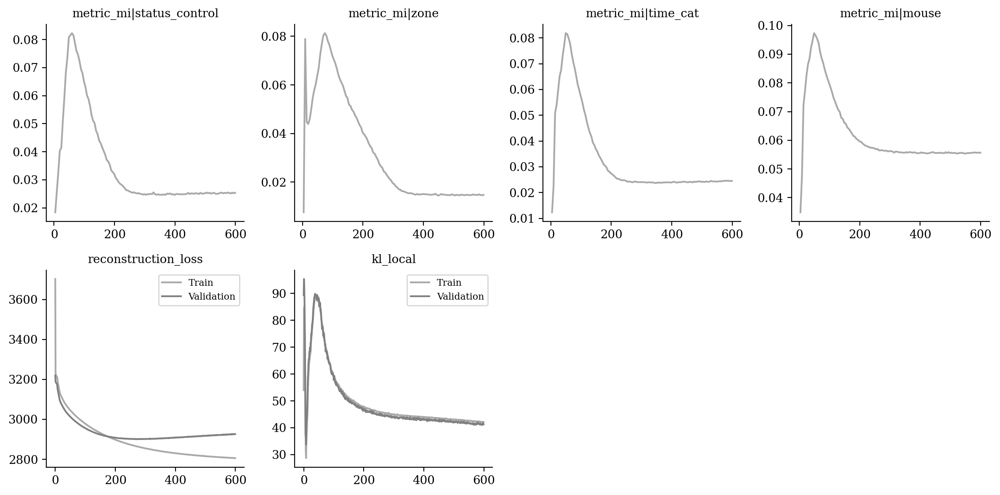

In [12]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [13]:
from tardis._disentanglementmanager import DisentanglementManager as DM

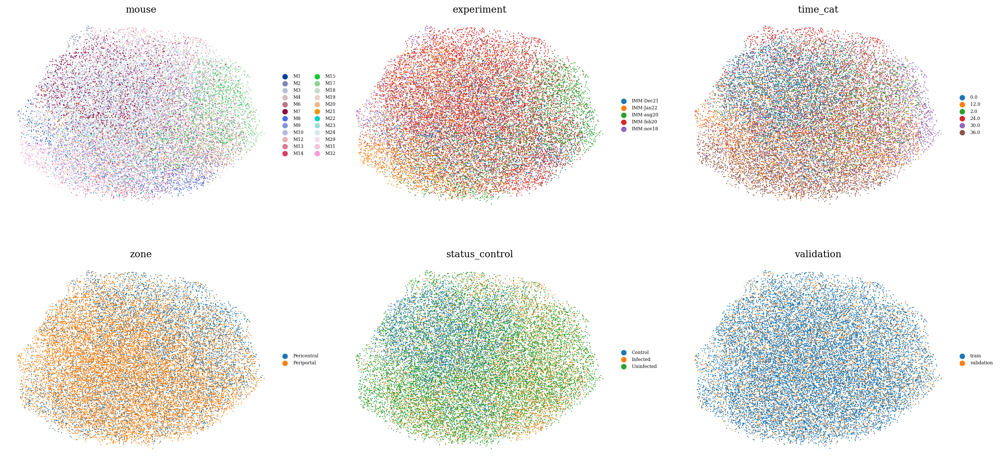

In [14]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

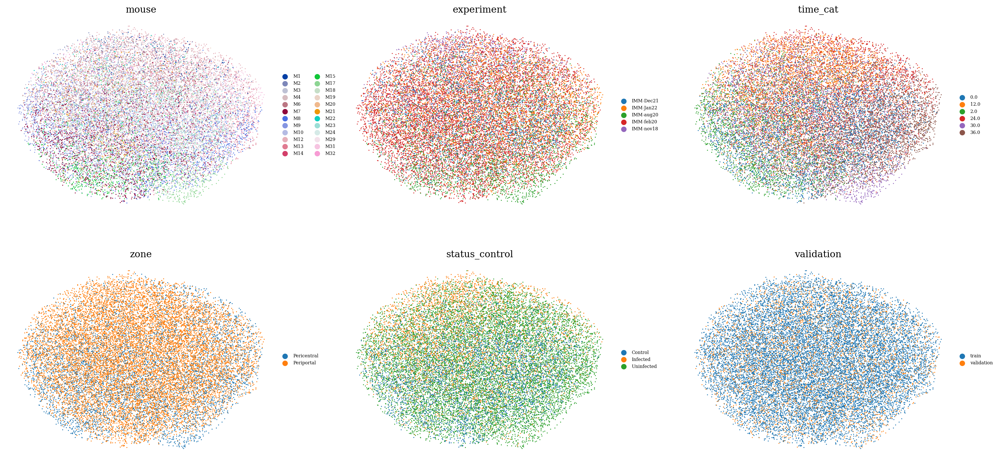

In [15]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

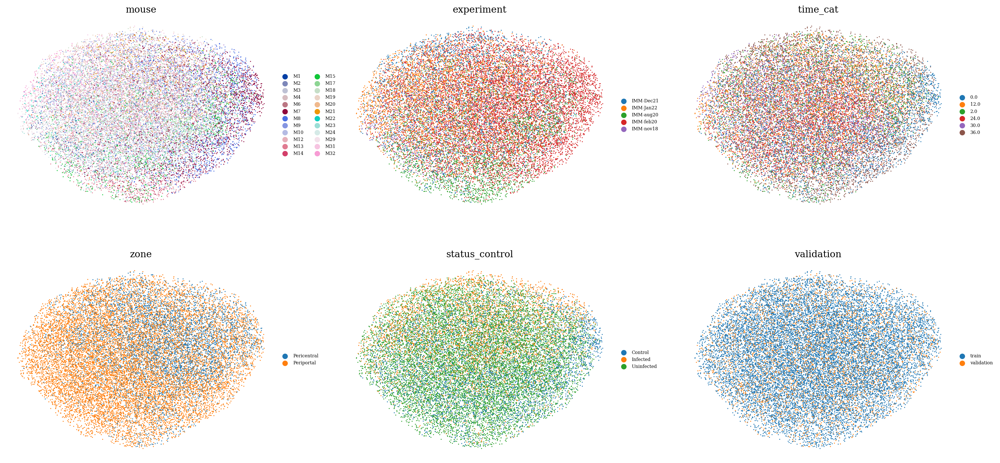

In [16]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

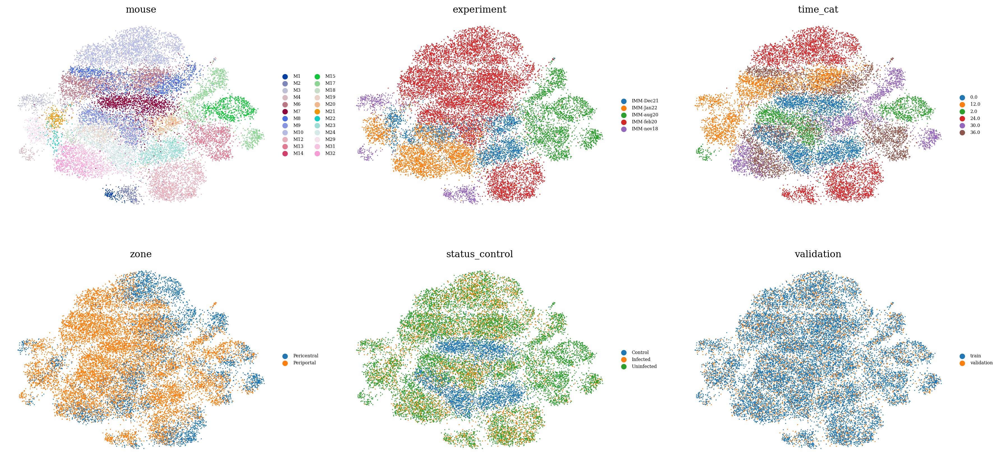

In [17]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

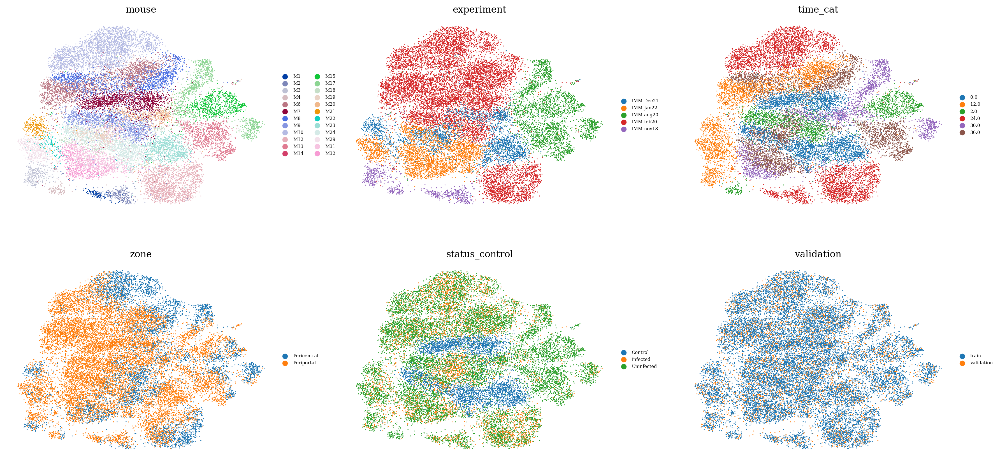

In [18]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [19]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())

In [20]:
latent = latent[latent.obs["time_cat"] == "12.0"]

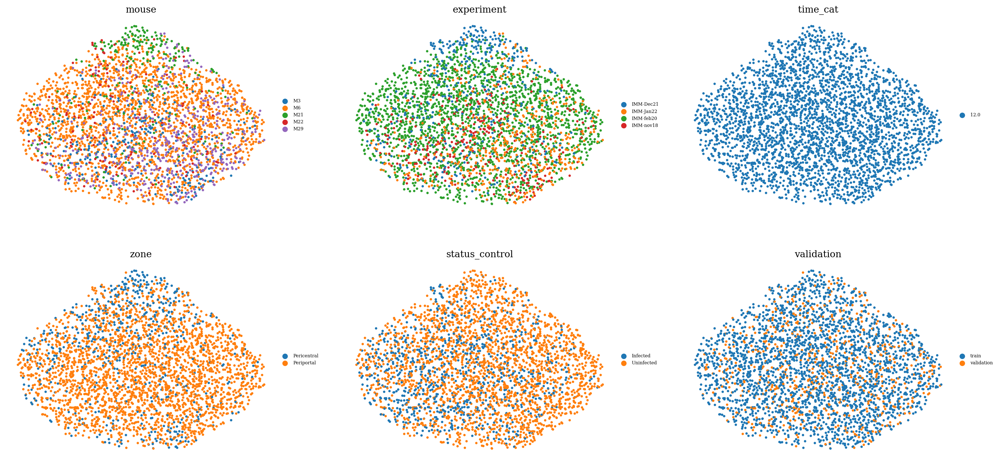

In [21]:
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )